In [4]:
# import CSS stylesheet
from IPython.display import HTML, display
display(HTML(f"<style>{open('style.css').read()}</style>"))

<a id="summary"></a>

<p class="summary">Summary</p>

<ol class="sub">
    <li class="sub"><a href="#packages">Packages</a>
    <li class="sub"><a href="#global-variables-and-functions">Global variables and functions</a></li>
    <li class="sub"><a href="#load-the-data">Load the data</a></li>
    <li class="sub"><a href="#figure-of-the-overlapping-area">Figure of the overlapping area distributions comparison</a></li>
    <li class="sub"><a href="#environmental-features-within">Environmental features within overlapping</a>
        <ol class="sub">
            <li class="sub"><a href="#calculating-the-overlap">Calculating the overlap</a></li>
            <li class="sub"><a href="#comparisons-between-50-100-200">Comparisons between 50 km², 100 km², and 200 km² for features distributions in overlapping areas</a>
                <ol class="sub">
                    <li class="sub"><a href="#load-the-environmental-features">Load the environmental features within the overlapping areas for sister species</a></li>
                    <li class="sub"><a href="#checking-the-names">Checking the names of each species within the overlap dataframes</a></li>
                    <li class="sub"><a href="#number-of-pairs">Number of pairs considering sympatry intervals</a></li>
                    <li class="sub"><a href="#spearman-coefficient-with-shuffling-pairs">Spearman coefficient with shuffling pairs</a></li>
                    <li class="sub"><a href="#comparison-of-the-environmental-distributions">Comparison of the environmental distributions between different spatial scale for the same pairs</a>
                    <ol class="sub">
                        <li class="sub"><a href="#europe-comparison-of-the-environmental">Europe</a>
                            <ol class="sub">
                                <li class="sub"><a href="#europe-comparison-of-the-environmental-all">All</a></li>
                                <li class="sub"><a href="#europe-comparison-of-the-environmental-common">Common</a></li>
                            </ol>
                        </li>
                        <li class="sub"><a href="#north-america-comparison-of-the-environmental">North America</a>
                            <ol class="sub">
                                <li class="sub"><a href="#north-america-comparison-of-the-environmental-all">All</a></li>
                                <li class="sub"><a href="#north-america-comparison-of-the-environmental-common">Common</a></li>
                            </ol>
                        </li>
                    </ol>
                    </li>
                    <li class="sub"><a href="#comparison-of-the-environmental-distributions-sister">Comparison of the environmental distributions between sister species</a></li>
                    <li class="sub"><a href="#comparison-of-the-environmental-distributions-sister-sympatry">Comparison of the environmental distributions between sister species within sympatry intervals</a>
                        <ol class="sub">
                            <li class="sub"><a href="#mean-fraction-of-pvalues-greater">Mean fraction of p-values greater than...</a></li>
                            <li class="sub"><a href="#fraction-of-pvalues-within">Fraction of pvalues within sympatry interval</a></li>
                            <li class="sub"><a href="#mean-fraction-of-similar">Mean fraction of similar distributions</a></li>
                        </ol>
                    </li>
                </ol>
            </li>
        </ol>
    </li>
</ol>

# Packages
<a id="packages"></a>
<a href="#summary">Summary</a>

In [1]:
# directories, dictionaries, and strings
import glob
from collections import OrderedDict
from itertools import combinations
import string

# data structures
import geopandas as gpd
from shapely.geometry import Point, Polygon
import gpd_lite_toolbox as glt
from ast import literal_eval
import random

# networks
import networkx as nx

# plots
from matplotlib.gridspec import GridSpec
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

# system
import sys
from multiprocessing import Pool

from pyhvr import *

loadstd()

# Global variables and functions
<a id="global-variables-and-functions"></a>
<a href="#summary">Summary</a>

In [2]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
europe = world[(world['continent'] == 'Europe') & (world['name'] != 'Russia')]
north_america = world[world['continent'] == 'North America']


nad83_proj_dict = {'datum': 'NAD83',
 'lat_0': 40,
 'lat_1': 20,
 'lat_2': 60,
 'lon_0': -96,
 'no_defs': True,
 'proj': 'lcc',
 'units': 'm',
 'x_0': 0,
 'y_0': 0}

wgs84_proj_dict = {'init': 'epsg:4326'}

weck4_proj_dict = "+proj=eck4 +lon_0=0 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"

common_sp_na_eu = pd.read_table('results/common_sp_na_eu.dat', names=['species'])
common_sp_na_eu['genus'] = common_sp_na_eu['species'].apply(lambda s: s.split()[0])

common_pairs = pd.DataFrame([pair for pair in combinations(common_sp_na_eu['species'], 2)], columns=['sp1', 'sp2'])

features = ['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'water', 'lgm']

In [3]:
def transform_list(l):
    dist = pd.eval(l.replace('nan', '-2')) 
    dist = dist[dist != -2].astype(np.float)
    
    return pd.DataFrame(dist, columns=['dist'])

# Load the data
<a id="load-the-data"></a>
<a href="#summary">Summary</a>

bio1 - mean temperature

bio12 - mean precepitation

bio7 - mean variation temperature

In [307]:
europe_bio1_5050       = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='bio1')
europe_bio12_5050      = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='bio12')
europe_bio7_5050       = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='bio7')
europe_alkalinity_5050 = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='alkalinity')
# europe_water_5050      = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='water')
europe_lgm_5050        = pd.read_excel('../data/Sister_sp_envs/EU_50km_envs.xlsx', sheet_name='LGM')

europe_bio1_100100       = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='bio1')
europe_bio12_100100      = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='bio12')
europe_bio7_100100       = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='bio7')
europe_alkalinity_100100 = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='Alkalinity')
# europe_water_100100      = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='water')
europe_lgm_100100        = pd.read_excel('../data/Sister_sp_envs/EU_100km_envs.xlsx', sheet_name='LGM')

europe_bio1_200200       = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='bio1')
europe_bio12_200200      = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='bio12')
europe_bio7_200200       = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='bio7')
europe_alkalinity_200200 = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='alkalinity')
# europe_water_200200      = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='water')
europe_lgm_200200        = pd.read_excel('../data/Sister_sp_envs/EU_200km_envs.xlsx', sheet_name='LGM')

europe_water_5050_weck4   = pd.read_excel('results/Water_eu_na_combined.xlsx', sheet_name='EU50km')
europe_water_100100_weck4 = pd.read_excel('results/Water_eu_na_combined.xlsx', sheet_name='EU100km')
europe_water_200200_weck4 = pd.read_excel('results/Water_eu_na_combined.xlsx', sheet_name='EU200km')

north_america_bio1_5050       = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='na_bio1')
north_america_bio12_5050      = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='na_bio12')
# north_america_bio7_5050       = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='na_bio7')
north_america_bio7_5050       = pd.read_excel('../data/Sister_sp_envs/na_bio7_new.xlsx', sheet_name='na_50km_bio7_new') # new 18.01.19
# north_america_bio7_5050       = pd.read_excel('../data/Sister_sp_envs/NA_50km_bio7.xlsx', sheet_name='na_50km_bio7')
north_america_alkalinity_5050 = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='Alkalinity')
# north_america_water_5050      = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='water')
north_america_lgm_5050        = pd.read_excel('../data/Sister_sp_envs/NA_50km_envs.xlsx', sheet_name='LGM')

north_america_bio1_100100       = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='bio1')
north_america_bio12_100100      = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='bio12')
north_america_bio7_100100       = pd.read_excel('../data/Sister_sp_envs/na_bio7_new.xlsx', sheet_name='na_100km_bio7_new') # new 18.01.19
# north_america_bio7_100100       = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='bio7')
north_america_alkalinity_100100 = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='Alkalinity')
# north_america_water_100100      = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='water')
north_america_lgm_100100        = pd.read_excel('../data/Sister_sp_envs/NA_100km_envs.xlsx', sheet_name='LGM')

north_america_bio1_200200       = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='bio1')
north_america_bio12_200200      = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='bio12')
north_america_bio7_200200       = pd.read_excel('../data/Sister_sp_envs/na_bio7_new.xlsx', sheet_name='na_200km_bio7_new') # new 18.01.19
# north_america_bio7_200200       = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='bio7')
north_america_alkalinity_200200 = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='alkalinity')
# north_america_water_200200      = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='water')
north_america_lgm_200200        = pd.read_excel('../data/Sister_sp_envs/NA_200km_envs.xlsx', sheet_name='LGM')


north_america_water_5050_weck4   = pd.read_excel('../results/Water_eu_na_combined.xlsx', sheet_name='NA50km')
north_america_water_100100_weck4 = pd.read_excel('../results/Water_eu_na_combined.xlsx', sheet_name='NA100km')
north_america_water_200200_weck4 = pd.read_excel('../results/Water_eu_na_combined.xlsx', sheet_name='NA200km')

In [308]:
europe_water_5050_weck4.columns   = ['GRID_CODE', 'water%']
europe_water_100100_weck4.columns = ['GRID_CODE', 'water%']
europe_water_200200_weck4.columns = ['GRID_CODE', 'water%']

north_america_water_5050_weck4.columns   = ['GRID_CODE', 'water%']
north_america_water_100100_weck4.columns = ['GRID_CODE', 'water%']
north_america_water_200200_weck4.columns = ['GRID_CODE', 'water%']

These are files that were generated using the weck4 projection and transformed to wgs84 grids.

In [309]:
occurrences_within_5050_grid_europe   = gpd.read_file('../results/europe/adj_matrix_5050/occurrences_within_5050_grid_europe.shp')
occurrences_within_100100_grid_europe = gpd.read_file('../results/europe/adj_matrix_100100/occurrences_within_100100_grid_europe.shp')
occurrences_within_200200_grid_europe = gpd.read_file('../results/europe/adj_matrix_200200/occurrences_within_200200_grid_europe.shp')

occurrences_within_5050_grid_north_america   = gpd.read_file('../results/north_america/adj_matrix_5050/occurrences_within_5050_grid_north_america.shp')
occurrences_within_100100_grid_north_america = gpd.read_file('../results/north_america/adj_matrix_100100/occurrences_within_100100_grid_north_america.shp')
occurrences_within_200200_grid_north_america = gpd.read_file('../results/north_america/adj_matrix_200200/occurrences_within_200200_grid_north_america.shp')

In [310]:
occurrences_within_5050_grid_europe['mean_temp'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_bio1_5050.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_5050_grid_europe['mean_prec'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_bio12_5050.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_5050_grid_europe['mean_vtemp'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_bio7_5050.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_5050_grid_europe['alkalinity'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_alkalinity_5050.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_5050_grid_europe['water'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_water_5050.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_5050_grid_europe['lgm'] = occurrences_within_5050_grid_europe['grid_code'].map(europe_lgm_5050.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_5050_grid_europe['lgm'] = occurrences_within_5050_grid_europe['grid_code'].map(occurrences_within_5050_grid_europe[occurrences_within_5050_grid_europe['lgm'] == 0]['lgm'].to_dict()).fillna(1)

occurrences_within_100100_grid_europe['mean_temp'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_bio1_100100.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_100100_grid_europe['mean_prec'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_bio12_100100.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_100100_grid_europe['mean_vtemp'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_bio7_100100.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_100100_grid_europe['alkalinity'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_alkalinity_100100.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_100100_grid_europe['water'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_water_100100.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_100100_grid_europe['lgm'] = occurrences_within_100100_grid_europe['grid_code'].map(europe_lgm_100100.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_100100_grid_europe['lgm'] = occurrences_within_100100_grid_europe['grid_code'].map(occurrences_within_100100_grid_europe[occurrences_within_100100_grid_europe['lgm'] == 0]['lgm'].to_dict()).fillna(1)

occurrences_within_200200_grid_europe['mean_temp'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_bio1_200200.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_200200_grid_europe['mean_prec'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_bio12_200200.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_200200_grid_europe['mean_vtemp'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_bio7_200200.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_200200_grid_europe['alkalinity'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_alkalinity_200200.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_200200_grid_europe['water'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_water_200200.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_200200_grid_europe['lgm'] = occurrences_within_200200_grid_europe['grid_code'].map(europe_lgm_200200.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_200200_grid_europe['lgm'] = occurrences_within_200200_grid_europe['grid_code'].map(occurrences_within_200200_grid_europe[occurrences_within_200200_grid_europe['lgm'] == 0]['lgm'].to_dict()).fillna(1)

occurrences_within_5050_grid_north_america['mean_temp'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_bio1_5050.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_5050_grid_north_america['mean_prec'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_bio12_5050.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_5050_grid_north_america['mean_vtemp'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_bio7_5050.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_5050_grid_north_america['alkalinity'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_alkalinity_5050.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_5050_grid_north_america['water'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_water_5050.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_5050_grid_north_america['lgm'] = occurrences_within_5050_grid_north_america['grid_code'].map(north_america_lgm_5050.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_5050_grid_north_america['lgm'] = occurrences_within_5050_grid_north_america['grid_code'].map(occurrences_within_5050_grid_north_america[occurrences_within_5050_grid_north_america['lgm'] == 0]['lgm'].to_dict()).fillna(1)

occurrences_within_100100_grid_north_america['mean_temp'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_bio1_100100.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_100100_grid_north_america['mean_prec'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_bio12_100100.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_100100_grid_north_america['mean_vtemp'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_bio7_100100.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_100100_grid_north_america['alkalinity'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_alkalinity_100100.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_100100_grid_north_america['water'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_water_100100.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_100100_grid_north_america['lgm'] = occurrences_within_100100_grid_north_america['grid_code'].map(north_america_lgm_100100.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_100100_grid_north_america['lgm'] = occurrences_within_100100_grid_north_america['grid_code'].map(occurrences_within_100100_grid_north_america[occurrences_within_100100_grid_north_america['lgm'] == 0]['lgm'].to_dict()).fillna(1)

occurrences_within_200200_grid_north_america['mean_temp'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_bio1_200200.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_200200_grid_north_america['mean_prec'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_bio12_200200.set_index('GRID_CODE').to_dict()['MEAN'])
occurrences_within_200200_grid_north_america['mean_vtemp'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_bio7_200200.set_index('GRID_CODE').to_dict()['MEAN'])/10
occurrences_within_200200_grid_north_america['alkalinity'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_alkalinity_200200.set_index('GRID_CODE').to_dict()['MEAN'])
# occurrences_within_200200_grid_north_america['water'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_water_200200.set_index('GRID_CODE').to_dict()['water%'])
occurrences_within_200200_grid_north_america['lgm'] = occurrences_within_200200_grid_north_america['grid_code'].map(north_america_lgm_200200.set_index('grid_code').to_dict()['Join_Count'])
occurrences_within_200200_grid_north_america['lgm'] = occurrences_within_200200_grid_north_america['grid_code'].map(occurrences_within_200200_grid_north_america[occurrences_within_200200_grid_north_america['lgm'] == 0]['lgm'].to_dict()).fillna(1)

Here we load the grids remade for the water % count.

In [311]:
occurrences_within_5050_grid_europe_weck4   = gpd.read_file('../results/europe/adj_matrix_5050_border_weck4/occurrences_within_5050_grid_europe_border_weck4.shp')
occurrences_within_100100_grid_europe_weck4 = gpd.read_file('../results/europe/adj_matrix_100100_border_weck4/occurrences_within_100100_grid_europe_border_weck4.shp')
occurrences_within_200200_grid_europe_weck4 = gpd.read_file('../results/europe/adj_matrix_200200_border_weck4/occurrences_within_200200_grid_europe_border_weck4.shp')

occurrences_within_5050_grid_north_america_weck4   = gpd.read_file('../results/north_america/adj_matrix_5050_border_weck4/occurrences_within_5050_grid_north_america_border_weck4.shp')
occurrences_within_100100_grid_north_america_weck4 = gpd.read_file('../results/north_america/adj_matrix_100100_border_weck4/occurrences_within_100100_grid_north_america_border_weck4.shp')
occurrences_within_200200_grid_north_america_weck4 = gpd.read_file('../results/north_america/adj_matrix_200200_border_weck4/occurrences_within_200200_grid_north_america_border_weck4.shp')

In [312]:
occurrences_within_5050_grid_europe_weck4['water'] = occurrences_within_5050_grid_europe_weck4['grid_code'].map(europe_water_5050_weck4.set_index('GRID_CODE').to_dict()['water%'])

occurrences_within_100100_grid_europe_weck4['water'] = occurrences_within_100100_grid_europe_weck4['grid_code'].map(europe_water_100100_weck4.set_index('GRID_CODE').to_dict()['water%'])

occurrences_within_200200_grid_europe_weck4['water'] = occurrences_within_200200_grid_europe_weck4['grid_code'].map(europe_water_200200_weck4.set_index('GRID_CODE').to_dict()['water%'])

occurrences_within_5050_grid_north_america_weck4['water'] = occurrences_within_5050_grid_north_america_weck4['grid_code'].map(north_america_water_5050_weck4.set_index('GRID_CODE').to_dict()['water%'])

occurrences_within_100100_grid_north_america_weck4['water'] = occurrences_within_100100_grid_north_america_weck4['grid_code'].map(north_america_water_100100_weck4.set_index('GRID_CODE').to_dict()['water%'])

occurrences_within_200200_grid_north_america_weck4['water'] = occurrences_within_200200_grid_north_america_weck4['grid_code'].map(north_america_water_200200_weck4.set_index('GRID_CODE').to_dict()['water%'])

In [313]:
features_list   = ['Total', 'grid_code', 'geometry', 'mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'lgm']
features_list_2 = ['Total', 'grid_code', 'geometry', 'water']

In [314]:
europe_code_sp_dict = pd.read_table('../results/europe/adj_matrix_5050/europe_code_sp.dat')
north_america_code_sp_dict = pd.read_table('../results/north_america/adj_matrix_5050/north_america_code_sp.dat')

europe_code_sp_dict_weck4 = pd.read_table('../results/europe/adj_matrix_5050_border_weck4/europe_code_sp.dat')
north_america_code_sp_dict_weck4 = pd.read_table('../results/north_america/adj_matrix_5050_border_weck4/north_america_code_sp.dat')

In [315]:
europe_code_sp_dict['genus'] = europe_code_sp_dict['specie'].apply(lambda s: s.split()[0])
north_america_code_sp_dict['genus'] = north_america_code_sp_dict['specie'].apply(lambda s: s.split()[0])

europe_code_sp_dict_weck4['genus'] = europe_code_sp_dict_weck4['specie'].apply(lambda s: s.split()[0])
north_america_code_sp_dict_weck4['genus'] = north_america_code_sp_dict_weck4['specie'].apply(lambda s: s.split()[0])

In [316]:
occurrences_within_5050_grid_europe.columns   = list(europe_code_sp_dict['specie']) + features_list
occurrences_within_100100_grid_europe.columns = list(europe_code_sp_dict['specie']) + features_list
occurrences_within_200200_grid_europe.columns = list(europe_code_sp_dict['specie']) + features_list

occurrences_within_5050_grid_north_america.columns   = list(north_america_code_sp_dict['specie']) + features_list
occurrences_within_100100_grid_north_america.columns = list(north_america_code_sp_dict['specie']) + features_list
occurrences_within_200200_grid_north_america.columns = list(north_america_code_sp_dict['specie']) + features_list

occurrences_within_5050_grid_europe_weck4.columns   = list(europe_code_sp_dict_weck4['specie']) + features_list_2
occurrences_within_100100_grid_europe_weck4.columns = list(europe_code_sp_dict_weck4['specie']) + features_list_2
occurrences_within_200200_grid_europe_weck4.columns = list(europe_code_sp_dict_weck4['specie']) + features_list_2

occurrences_within_5050_grid_north_america_weck4.columns   = list(north_america_code_sp_dict_weck4['specie']) + features_list_2
occurrences_within_100100_grid_north_america_weck4.columns = list(north_america_code_sp_dict_weck4['specie']) + features_list_2
occurrences_within_200200_grid_north_america_weck4.columns = list(north_america_code_sp_dict_weck4['specie']) + features_list_2

Selecting the pairs of sister species.

In [317]:
europe_genus = europe_code_sp_dict['genus'].unique()
north_america_genus = north_america_code_sp_dict['genus'].unique()

genus_pairs_list_europe = []
for genus in europe_genus:
    df = europe_code_sp_dict[europe_code_sp_dict['genus'] == genus]
    if df.shape[0] > 1:
        pairs = pd.DataFrame([[genus] + list(pair) for pair in combinations(df['specie'], 2)], columns=['genus', 'sp1', 'sp2'])
        genus_pairs_list_europe.append(pairs)

genus_pairs_df_europe = pd.concat(genus_pairs_list_europe).reset_index(drop=True)

genus_pairs_list_north_america = []
for genus in north_america_genus:
    df = north_america_code_sp_dict[north_america_code_sp_dict['genus'] == genus]
    if df.shape[0] > 1:
        pairs = pd.DataFrame([[genus] + list(pair) for pair in combinations(df['specie'], 2)], columns=['genus', 'sp1', 'sp2'])
        genus_pairs_list_north_america.append(pairs)

genus_pairs_df_north_america = pd.concat(genus_pairs_list_north_america).reset_index(drop=True)

Select the common species between Europe and North America.

In [318]:
common_sp_na_eu = pd.read_table('results/common_sp_na_eu.dat', names=['species'])
common_sp_na_eu['genus'] = common_sp_na_eu['species'].apply(lambda s: s.split()[0])

def occurrences_within_common(df):
    return df[df.columns[df.columns.isin(list(common_sp_na_eu['species']) + features_list)]]

occurrences_within_5050_grid_europe_common   = occurrences_within_common(occurrences_within_5050_grid_europe)
occurrences_within_100100_grid_europe_common = occurrences_within_common(occurrences_within_100100_grid_europe)
occurrences_within_200200_grid_europe_common = occurrences_within_common(occurrences_within_200200_grid_europe)

occurrences_within_5050_grid_north_america_common   = occurrences_within_common(occurrences_within_5050_grid_north_america)
occurrences_within_100100_grid_north_america_common = occurrences_within_common(occurrences_within_100100_grid_north_america)
occurrences_within_200200_grid_north_america_common = occurrences_within_common(occurrences_within_200200_grid_north_america)

occurrences_within_5050_grid_europe_weck4_common   = occurrences_within_common(occurrences_within_5050_grid_europe_weck4)
occurrences_within_100100_grid_europe_weck4_common = occurrences_within_common(occurrences_within_100100_grid_europe_weck4)
occurrences_within_200200_grid_europe_weck4_common = occurrences_within_common(occurrences_within_200200_grid_europe_weck4)

occurrences_within_5050_grid_north_america_weck4_common   = occurrences_within_common(occurrences_within_5050_grid_north_america_weck4)
occurrences_within_100100_grid_north_america_weck4_common = occurrences_within_common(occurrences_within_100100_grid_north_america_weck4)
occurrences_within_200200_grid_north_america_weck4_common = occurrences_within_common(occurrences_within_200200_grid_north_america_weck4)

genus_pairs_list_europe_common = []
for genus in common_sp_na_eu['genus'].unique():
    df = common_sp_na_eu[common_sp_na_eu['genus'] == genus]
    if df.shape[0] > 1:
        pairs = pd.DataFrame([[genus] + list(pair) for pair in combinations(df['species'], 2)], columns=['genus', 'sp1', 'sp2'])
        genus_pairs_list_europe_common.append(pairs)

genus_pairs_df_europe_common = pd.concat(genus_pairs_list_europe_common).reset_index(drop=True)

genus_pairs_list_north_america_common = []
for genus in common_sp_na_eu['genus'].unique():
    df = common_sp_na_eu[common_sp_na_eu['genus'] == genus]
    if df.shape[0] > 1:
        pairs = pd.DataFrame([[genus] + list(pair) for pair in combinations(df['species'], 2)], columns=['genus', 'sp1', 'sp2'])
        genus_pairs_list_north_america_common.append(pairs)

genus_pairs_df_north_america_common = pd.concat(genus_pairs_list_north_america_common).reset_index(drop=True)

# Figure of the overlapping area distributions comparison
<a id="figure-of-the-overlapping-area"></a>
<a href="#summary">Summary</a>

In [319]:
potamogeton_alk = occurrences_within_5050_grid_north_america[list(occurrences_within_5050_grid_north_america.columns[occurrences_within_5050_grid_north_america.columns.str.contains('Potamogeton *')]) + ['geometry', 'alkalinity']]

potamogeton_alk_100 = occurrences_within_100100_grid_north_america[list(occurrences_within_100100_grid_north_america.columns[occurrences_within_100100_grid_north_america.columns.str.contains('Potamogeton *')]) + ['geometry', 'alkalinity']]

potamogeton_alk_200 = occurrences_within_200200_grid_north_america[list(occurrences_within_200200_grid_north_america.columns[occurrences_within_200200_grid_north_america.columns.str.contains('Potamogeton *')]) + ['geometry', 'alkalinity']]

In [320]:
potamogeton_pairs = [list(comb) for comb in combinations(potamogeton_alk.columns[potamogeton_alk.columns.str.contains('Pot*')],2)]

In [321]:
potamogeton_pairs

[['Potamogeton alpinus', 'Potamogeton amplifolius'],
 ['Potamogeton alpinus', 'Potamogeton bicupulatus'],
 ['Potamogeton alpinus', 'Potamogeton confervoides'],
 ['Potamogeton alpinus', 'Potamogeton crispus'],
 ['Potamogeton alpinus', 'Potamogeton diversifolius'],
 ['Potamogeton alpinus', 'Potamogeton epihydrus'],
 ['Potamogeton alpinus', 'Potamogeton foliosus'],
 ['Potamogeton alpinus', 'Potamogeton friesii'],
 ['Potamogeton alpinus', 'Potamogeton gramineus'],
 ['Potamogeton alpinus', 'Potamogeton groenlandicus'],
 ['Potamogeton alpinus', 'Potamogeton hillii'],
 ['Potamogeton alpinus', 'Potamogeton illinoensis'],
 ['Potamogeton alpinus', 'Potamogeton natans'],
 ['Potamogeton alpinus', 'Potamogeton nodosus'],
 ['Potamogeton alpinus', 'Potamogeton oblongus'],
 ['Potamogeton alpinus', 'Potamogeton obtusifolius'],
 ['Potamogeton alpinus', 'Potamogeton perfoliatus'],
 ['Potamogeton alpinus', 'Potamogeton praelongus'],
 ['Potamogeton alpinus', 'Potamogeton pulcher'],
 ['Potamogeton alpinus',

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


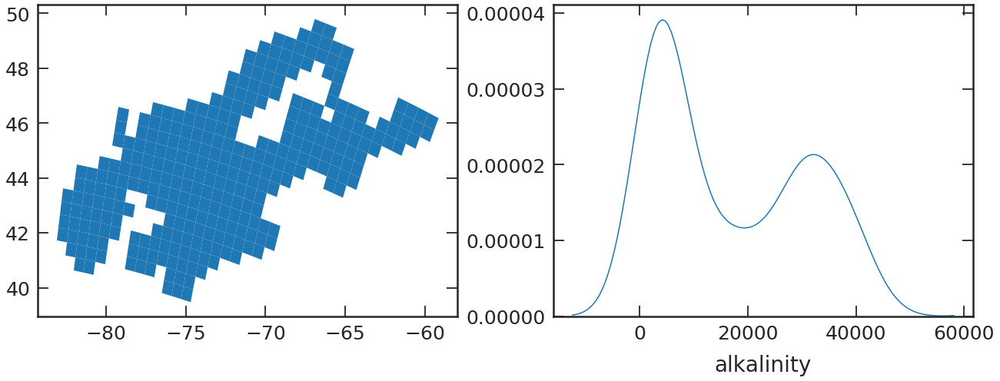

In [108]:
fig, ax = plt.subplots(1, 2, figsize=stdfigsize(nx=2, ny=1))

potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2].plot(ax=ax[0])
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[1], hist=False)

fig.tight_layout()

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


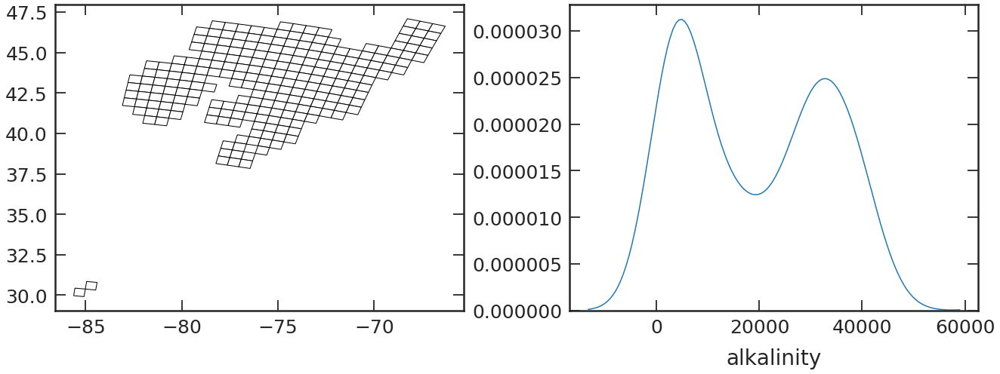

In [217]:
fig, ax = plt.subplots(1, 2, figsize=stdfigsize(nx=2, ny=1))

potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2].plot(ax=ax[0], edgecolor='black', color='white')
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[1], hist=False)

fig.tight_layout()

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:489: RuntimeWarning: invalid value encountered in less
  np.copyto(xa, -1, where=xa < 0.0)


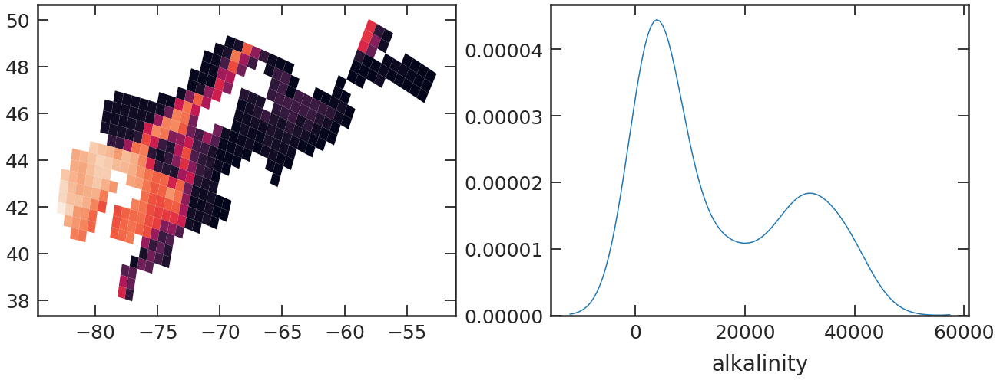

In [386]:
fig, ax = plt.subplots(1, 2, figsize=stdfigsize(nx=2, ny=1))

potamogeton_alk[potamogeton_alk[potamogeton_pairs[115]].sum(axis=1) == 2].plot(column='alkalinity', ax=ax[0])
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[115]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[1], hist=False)

fig.tight_layout()

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


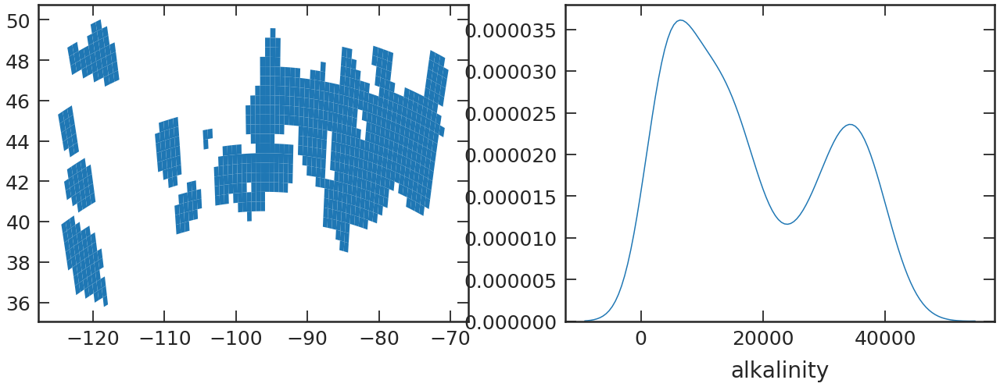

In [277]:
fig, ax = plt.subplots(1, 2, figsize=stdfigsize(nx=2, ny=1))

potamogeton_alk[potamogeton_alk[potamogeton_pairs[146]].sum(axis=1) == 2].plot(ax=ax[0])
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[146]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[1], hist=False)

fig.tight_layout()

In [328]:
len(potamogeton_pairs)

210

In [943]:
dist1 = potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2]['alkalinity'].dropna()
dist1 = dist1
# dist1 = (dist1 - dist1.min()) / (dist1.max() - dist1.min())
# dist1 = (dist1 - dist1.mean()) / dist1.std()

dist2 = potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2]['alkalinity'].dropna()
dist2 = dist2
# dist2 = (dist2 - dist2.min()) / (dist2.max() - dist2.min())
# dist2 = (dist2 - dist2.mean()) / dist2.std()

dist3 = potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2]['alkalinity'].dropna()
dist3 = dist3
# dist3 = (dist3 - dist3.min()) / (dist3.max() - dist3.min())
# dist3 = (dist3 - dist3.mean()) / dist3.std()

scipy.stats.ks_2samp(dist1, dist2)[1], scipy.stats.ks_2samp(dist1, dist3)[1], scipy.stats.ks_2samp(dist2, dist3)[1]

(0.139138366131512, 0.048293826043375794, 5.840271931478593e-06)

In [526]:
x_america_200 = np.asarray([occurrences_within_200200_grid_north_america['geometry'].centroid[i].x for i in range(occurrences_within_200200_grid_north_america.shape[0])])
y_america_200 = np.asarray([occurrences_within_200200_grid_north_america['geometry'].centroid[i].y for i in range(occurrences_within_200200_grid_north_america.shape[0])])

alk_values_200 = np.asarray(occurrences_within_200200_grid_north_america['alkalinity'].fillna(0))

In [460]:
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [582]:
def _3d_proj_data(gpd):
    x = np.asarray([gpd['geometry'].centroid.iloc[i].x for i in range(gpd.shape[0])])
    y = np.asarray([gpd['geometry'].centroid.iloc[i].y for i in range(gpd.shape[0])])

    alk = np.asarray(gpd['alkalinity'].fillna(0))
    
    return x, y, alk

In [579]:
alk_sps_50 = _3d_proj_data(occurrences_within_5050_grid_north_america)
alk_sps_100 = _3d_proj_data(occurrences_within_100100_grid_north_america)
alk_sps_200 = _3d_proj_data(occurrences_within_200200_grid_north_america)

In [956]:
sp_1_174 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][0]] == 1])
sp_2_174 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][1]] == 1])
sp_2_174_overlap = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2])


sp_1_35 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][0]] == 1])
sp_2_35 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][1]] == 1])
sp_2_35_overlap = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2])

sp_1_86 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86][0]] == 1])
sp_2_86 = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86][1]] == 1])
sp_2_86_overlap = _3d_proj_data(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2])

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


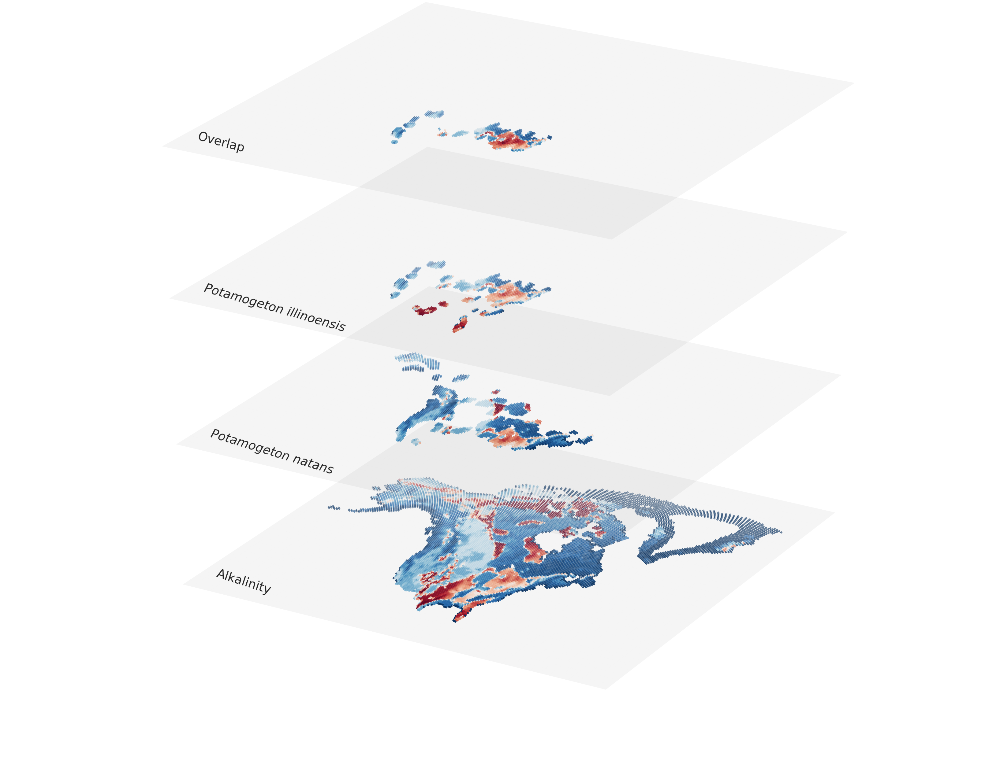

In [673]:
fig = plt.figure(figsize=stdfigsize(nx=5, ny=5))

ax = fig.add_subplot(111, projection='3d')

# ax.scatter(xs=0, ys=alk_sps_50[0], zs=alk_sps_50[1], marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
# ax.scatter(xs=1.5, ys=sp_2_174[0], zs=sp_2_174[1], marker='D', s=25, c=[_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()])
# ax.scatter(xs=3, ys=sp_1_174[0], zs=sp_1_174[1], marker='D', s=25, c=[_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()])

# ax.scatter(xs=alk_sps_50[0], ys=3.0, zs=alk_sps_50[1], marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
# ax.scatter(xs=sp_2_174[0]  , ys=1.5, zs=sp_2_174[1]  , marker='D', s=25, c=[_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()])
# ax.scatter(xs=sp_1_174[0]  , ys=0.0, zs=sp_1_174[1]  , marker='D', s=25, c=[_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()])

z1, z2, z3, z4 = (0, 2.0, 4.0, 6.0)

xx, yy = np.meshgrid(range(int(round(alk_sps_50[0].min()))-10, int(round(alk_sps_50[0].max()))+10), range(int(round(alk_sps_50[1].min()))-10, int(round(alk_sps_50[1].max()))+10))
zz = yy*z1
ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
zz = yy*0 + z2
ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
zz = yy*0 + z3
ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
zz = yy*0 + z4
ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')



ax.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z1, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax.scatter(xs=sp_2_174[0]  , ys=sp_2_174[1]  , zs=z2, marker='D', s=25, c=[_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()])
ax.scatter(xs=sp_1_174[0]  , ys=sp_1_174[1]  , zs=z3, marker='D', s=25, c=[_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()])
ax.scatter(xs=sp_2_174_overlap[0]  , ys=sp_2_174_overlap[1]  , zs=z4, marker='D', s=25, c=[_cmap(i) for i in sp_2_174_overlap[2]/sp_2_174_overlap[2].max()])


# ax.fill_betweenx()

# ax.set_xlim([-0.25, 3.25])
# ax.set_ylim([-0.25, 3.25])
ax.set_zlim([z1, z4-1])

ax.text(-180, 20, z1, "Alkalinity", 'x', fontsize=40)
ax.text(-180, 20, z2, potamogeton_pairs[174][1], 'x', fontsize=40, style='italic')
ax.text(-180, 20, z3, potamogeton_pairs[174][0], 'x', fontsize=40, style='italic')
ax.text(-180, 20, z4, 'Overlap', 'x', fontsize=40)

ax.set_axis_off()

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Proccess order')

fig.tight_layout()

fig.savefig('figures/test_3d.pdf', bbox_inches='tight')

In [733]:
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


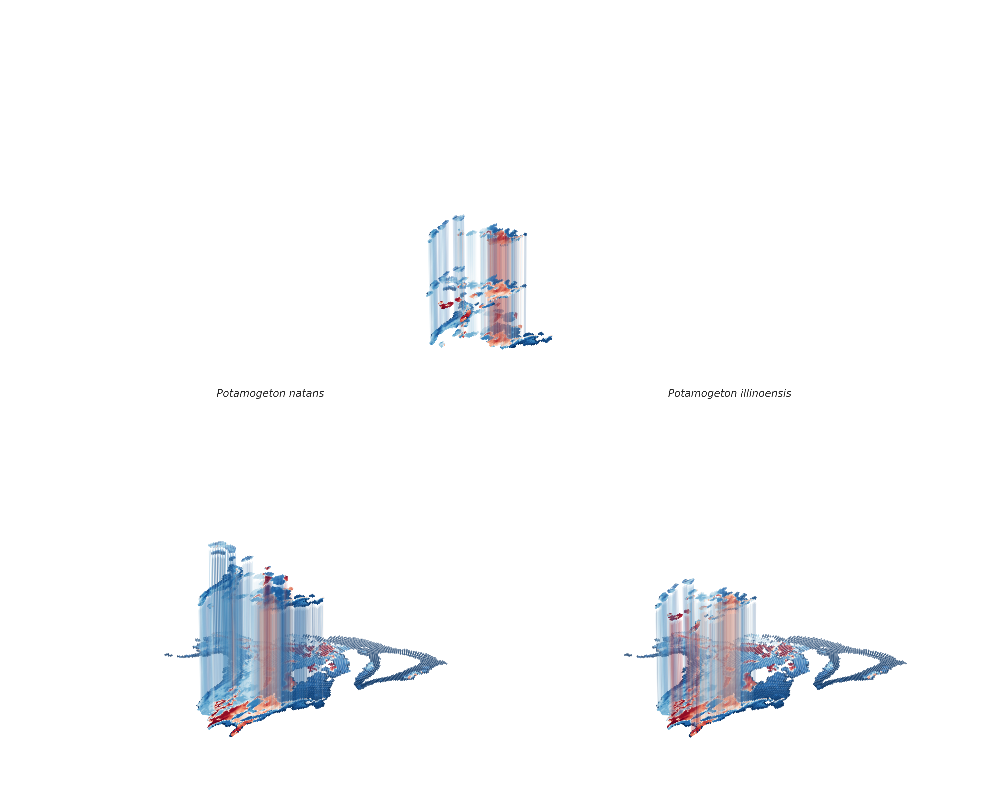

In [964]:
fig = plt.figure(figsize=stdfigsize(nx=5, ny=5, ratio=2))

gs = GridSpec(nrows=2, ncols=6)
# ax0 = fig.add_subplot(gs[0, 2:4])
ax1 = fig.add_subplot(gs[0, 2:4], projection='3d')
# identical to ax1 = plt.subplot(gs.new_subplotspec((0, 0), colspan=3))
ax2 = fig.add_subplot(gs[1, 1:3], projection='3d')
ax3 = fig.add_subplot(gs[1, 3:5], projection='3d')

z0, z1 = 0, 2

for i, c in enumerate([_cmap(i) for i in sp_2_174_overlap[2]/sp_2_174_overlap[2].max()]):
    ax1.plot(xs=[sp_2_174_overlap[0][i]]*2, ys=[sp_2_174_overlap[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3, markersize=0)

ax1.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()], alpha=0)
ax1.scatter(xs=sp_2_174_overlap[0]  , ys=sp_2_174_overlap[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_174_overlap[2]/sp_2_174_overlap[2].max()])
ax1.scatter(xs=sp_1_174[0]  , ys=sp_1_174[1]  , zs=z1-1.0    , marker='D', s=25, c=[_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()])
ax1.scatter(xs=sp_2_174[0]  , ys=sp_2_174[1]  , zs=z1-2.0, marker='D', s=25, c=[_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()])


for i, c in enumerate([_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()]):
    ax2.plot(xs=[sp_2_174[0][i]]*2, ys=[sp_2_174[1][i]]*2, zs=[z1-0.1, z0], c=c, alpha=0.1, lw=3)

ax2.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax2.scatter(xs=sp_2_174[0]  , ys=sp_2_174[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_174[2]/sp_2_174[2].max()])

for i, c in enumerate([_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()]):
    ax3.plot(xs=[sp_1_174[0][i]]*2, ys=[sp_1_174[1][i]]*2, zs=[z1-0.1, z0], c=c, alpha=0.1, lw=3, markersize=0)


ax3.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax3.scatter(xs=sp_1_174[0]  , ys=sp_1_174[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_1_174[2]/sp_1_174[2].max()])



# xx, yy = np.meshgrid(range(int(round(alk_sps_50[0].min()))-10, int(round(alk_sps_50[0].max()))+10), range(int(round(alk_sps_50[1].min()))-10, int(round(alk_sps_50[1].max()))+10))

ax2.set_title(potamogeton_pairs[174][1], fontsize=40, style='italic')
ax3.set_title(potamogeton_pairs[174][0], fontsize=40, style='italic')
    
for i, ax in enumerate(fig.axes):
    ax.tick_params(labelbottom=False, labelleft=False)
    
#     zz = yy*z0
#     ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
#     if i > 0:
#         zz = yy*0 + z1
#         ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
    ax.set_axis_off()
    ax.set_zlim([z0, z1*2])



fig.tight_layout(w_pad=-30, pad=-30)
fig.savefig('figures/overlap_3d_p174.pdf', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


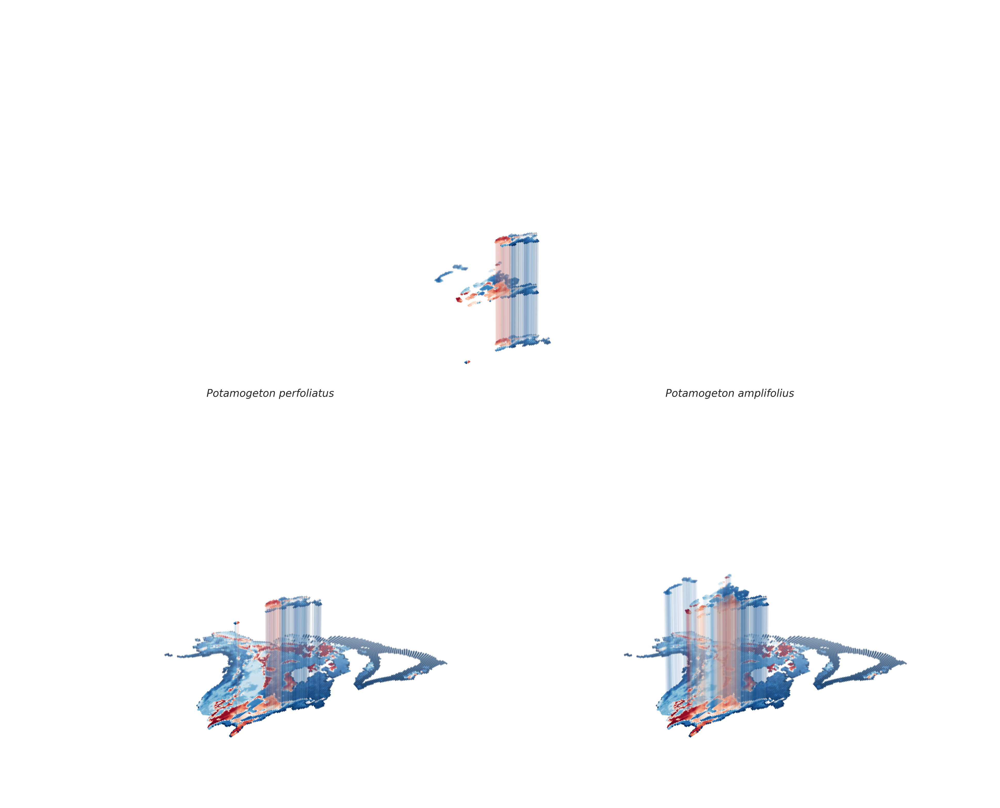

In [958]:
fig = plt.figure(figsize=stdfigsize(nx=5, ny=5, ratio=2))

gs = GridSpec(nrows=2, ncols=6)
# ax0 = fig.add_subplot(gs[0, 2:4])
ax1 = fig.add_subplot(gs[0, 2:4], projection='3d')
# identical to ax1 = plt.subplot(gs.new_subplotspec((0, 0), colspan=3))
ax2 = fig.add_subplot(gs[1, 1:3], projection='3d')
ax3 = fig.add_subplot(gs[1, 3:5], projection='3d')

z0, z1 = 0, 2

ax1.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()], alpha=0)
ax1.scatter(xs=sp_2_35_overlap[0]  , ys=sp_2_35_overlap[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_35_overlap[2]/sp_2_35_overlap[2].max()])
ax1.scatter(xs=sp_1_35[0]  , ys=sp_1_35[1]  , zs=z1-1.0    , marker='D', s=25, c=[_cmap(i) for i in sp_1_35[2]/sp_1_35[2].max()])
ax1.scatter(xs=sp_2_35[0]  , ys=sp_2_35[1]  , zs=z1-2.0, marker='D', s=25, c=[_cmap(i) for i in sp_2_35[2]/sp_2_35[2].max()])


for i, c in enumerate([_cmap(i) for i in sp_2_35_overlap[2]/sp_2_35_overlap[2].max()]):
    ax1.plot(xs=[sp_2_35_overlap[0][i]]*2, ys=[sp_2_35_overlap[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

ax2.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax2.scatter(xs=sp_2_35[0]  , ys=sp_2_35[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_35[2]/sp_2_35[2].max()])

for i, c in enumerate([_cmap(i) for i in sp_2_35[2]/sp_2_35[2].max()]):
    ax2.plot(xs=[sp_2_35[0][i]]*2, ys=[sp_2_35[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

ax3.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax3.scatter(xs=sp_1_35[0]  , ys=sp_1_35[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_1_35[2]/sp_1_35[2].max()])

for i, c in enumerate([_cmap(i) for i in sp_1_35[2]/sp_1_35[2].max()]):
    ax3.plot(xs=[sp_1_35[0][i]]*2, ys=[sp_1_35[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

# xx, yy = np.meshgrid(range(int(round(alk_sps_50[0].min()))-10, int(round(alk_sps_50[0].max()))+10), range(int(round(alk_sps_50[1].min()))-10, int(round(alk_sps_50[1].max()))+10))

ax2.set_title(potamogeton_pairs[35][1], fontsize=40, style='italic')
ax3.set_title(potamogeton_pairs[35][0], fontsize=40, style='italic')
    
for i, ax in enumerate(fig.axes):
    ax.tick_params(labelbottom=False, labelleft=False)
    
#     zz = yy*z0
#     ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
#     if i > 0:
#         zz = yy*0 + z1
#         ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
    ax.set_axis_off()
    ax.set_zlim([z0, z1*2])



fig.tight_layout(w_pad=-30, pad=-30)
fig.savefig('figures/overlap_3d_p35.pdf', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


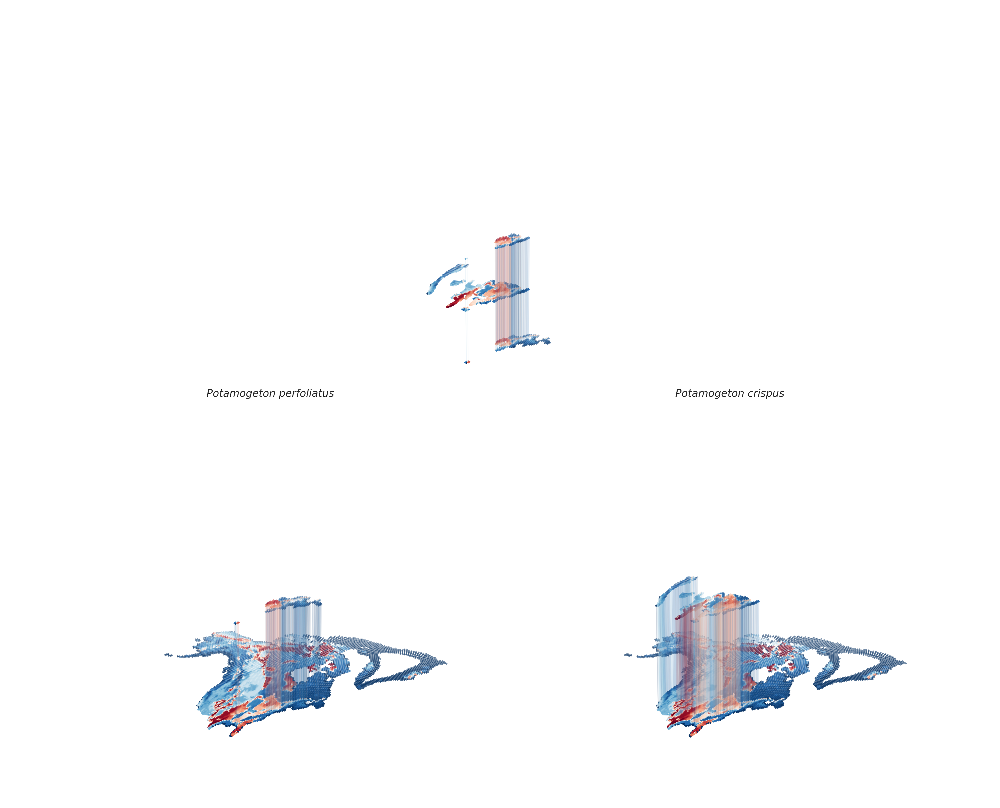

In [957]:
fig = plt.figure(figsize=stdfigsize(nx=5, ny=5, ratio=2))

gs = GridSpec(nrows=2, ncols=6)
# ax0 = fig.add_subplot(gs[0, 2:4])
ax1 = fig.add_subplot(gs[0, 2:4], projection='3d')
# identical to ax1 = plt.subplot(gs.new_subplotspec((0, 0), colspan=3))
ax2 = fig.add_subplot(gs[1, 1:3], projection='3d')
ax3 = fig.add_subplot(gs[1, 3:5], projection='3d')

z0, z1 = 0, 2

ax1.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()], alpha=0)
ax1.scatter(xs=sp_2_86_overlap[0]  , ys=sp_2_86_overlap[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_86_overlap[2]/sp_2_86_overlap[2].max()])
ax1.scatter(xs=sp_1_86[0]  , ys=sp_1_86[1]  , zs=z1-1.0    , marker='D', s=25, c=[_cmap(i) for i in sp_1_86[2]/sp_1_86[2].max()])
ax1.scatter(xs=sp_2_86[0]  , ys=sp_2_86[1]  , zs=z1-2.0, marker='D', s=25, c=[_cmap(i) for i in sp_2_86[2]/sp_2_86[2].max()])


for i, c in enumerate([_cmap(i) for i in sp_2_86_overlap[2]/sp_2_86_overlap[2].max()]):
    ax1.plot(xs=[sp_2_86_overlap[0][i]]*2, ys=[sp_2_86_overlap[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

ax2.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax2.scatter(xs=sp_2_86[0]  , ys=sp_2_86[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_2_86[2]/sp_2_86[2].max()])

for i, c in enumerate([_cmap(i) for i in sp_2_86[2]/sp_2_86[2].max()]):
    ax2.plot(xs=[sp_2_86[0][i]]*2, ys=[sp_2_86[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

ax3.scatter(xs=alk_sps_50[0], ys=alk_sps_50[1], zs=z0, marker='D', s=25, c=[_cmap(i) for i in alk_sps_50[2]/alk_sps_50[2].max()])
ax3.scatter(xs=sp_1_86[0]  , ys=sp_1_86[1]  , zs=z1, marker='D', s=25, c=[_cmap(i) for i in sp_1_86[2]/sp_1_86[2].max()])

for i, c in enumerate([_cmap(i) for i in sp_1_86[2]/sp_1_86[2].max()]):
    ax3.plot(xs=[sp_1_86[0][i]]*2, ys=[sp_1_86[1][i]]*2, zs=[z1-0.01, z0], c=c, alpha=0.1, lw=3)

# xx, yy = np.meshgrid(range(int(round(alk_sps_50[0].min()))-10, int(round(alk_sps_50[0].max()))+10), range(int(round(alk_sps_50[1].min()))-10, int(round(alk_sps_50[1].max()))+10))

ax2.set_title(potamogeton_pairs[86][1], fontsize=40, style='italic')
ax3.set_title(potamogeton_pairs[86][0], fontsize=40, style='italic')
    
for i, ax in enumerate(fig.axes):
    ax.tick_params(labelbottom=False, labelleft=False)
    
#     zz = yy*z0
#     ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
#     if i > 0:
#         zz = yy*0 + z1
#         ax.plot_surface(xx, yy, zz, alpha=0.05, color='gray')
    
    ax.set_axis_off()
    ax.set_zlim([z0, z1*2])



fig.tight_layout(w_pad=-30, pad=-30)
fig.savefig('figures/overlap_3d_p86.pdf', bbox_inches='tight')

In [946]:
normalize(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2]['alkalinity'].dropna())

7221    0.228233
7302    0.902485
7303    0.945100
7304    0.947652
7305    1.000000
          ...   
9168    0.059578
9169    0.084964
9170    0.046904
9171    0.021697
9172    0.035239
Name: alkalinity, Length: 234, dtype: float64

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


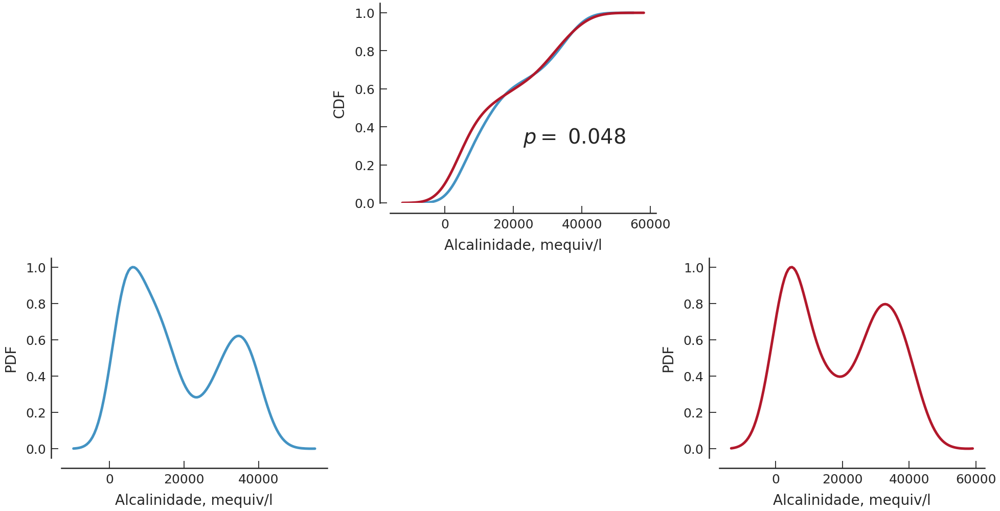

In [328]:
fig = plt.figure(figsize=stdfigsize(nx=3, ny=2))

gs = GridSpec(nrows=2, ncols=3)

_cmap   = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap
_colors = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors

# CREATING AXES
# -------------
# cumulative
ax00 = fig.add_subplot(gs[0, 1])

# distributions
ax10 = fig.add_subplot(gs[1, 0])
ax11 = fig.add_subplot(gs[1, 2])

# -------------

# PLOTS
# cumulative
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax00,  hist=False, kde_kws={"color": _colors[2] , "lw": 5, 'cumulative': True})
sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1)  == 2]['alkalinity'].dropna(), ax=ax00,  hist=False, kde_kws={"color": _colors[-2], "lw": 5, 'cumulative': True})

# distributions
def normalize(x):
        return (x - x.min(0)) / x.ptp(0)
    
# pair 1
# g_1 = sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax10, hist=False, kde_kws={"color": _colors[2], "lw": 5})
# get distplot line points
line_1 = g_1.get_lines()[0]
xd_1 = line_1.get_xdata()
yd_1 = line_1.get_ydata()

#normalize points
yd_1_2 = normalize(yd_1)
ax10.plot(xd_1, yd_1_2, color=_colors[2], lw=5)

# pair 2
# g_2 = sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax11, hist=False, kde_kws={"color": _colors[-2], "lw": 5})
# get distplot line points
line_2 = g_2.get_lines()[0]
xd_2 = line_2.get_xdata()
yd_2 = line_2.get_ydata()

#normalize points
yd_2_2 = normalize(yd_2)
ax11.plot(xd_2, yd_2_2, color=_colors[-2], lw=5)

dist1 = potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2]['alkalinity'].dropna()
dist2 = potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2]['alkalinity'].dropna()
ax00.annotate('$p =$ {:.3f}'.format(scipy.stats.ks_2samp(dist1, dist2)[1]), xy=(0.5, 0.3), xycoords='axes fraction', fontsize=40)

for c, ax in enumerate(fig.get_axes()):

    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)

    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')

#     ax.set_xlabel('Alkalinity, mequiv/l')
    ax.set_xlabel('Alcalinidade, mequiv/l') # PT
    ax.set_ylabel(['CDF', 'PDF', 'PDF'][c])
    
fig.tight_layout()
# fig.savefig('figures/dist_comp_p174_p86.pdf', bbox_inches='tight')
fig.savefig('figures/dist_comp_p174_p86_pt.pdf', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:489: RuntimeWarning: invalid value encountered in less
  np.copyto(xa, -1, where=xa < 0.0)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2022: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


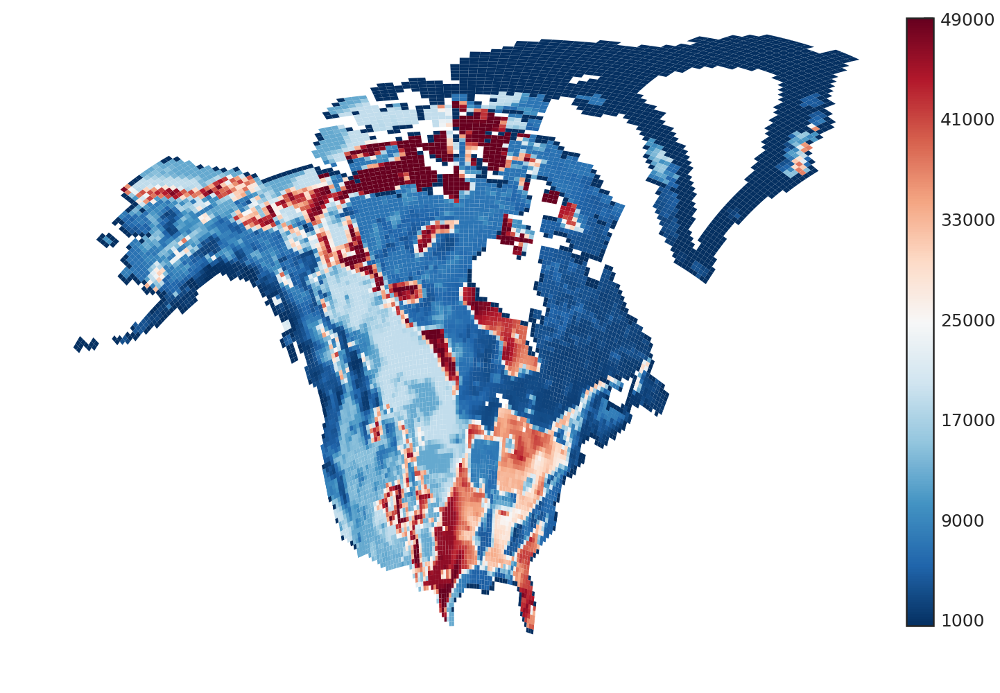

In [802]:
fig, ax = plt.subplots(1, 1, figsize=stdfigsize(nx=2, ny=2))

_cmap   = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap
_colors = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors

_kwargs_alk = dict(lw=0, vmin=occurrences_within_5050_grid_north_america['alkalinity'].min(), vmax=occurrences_within_5050_grid_north_america['alkalinity'].max(), cmap=_cmap)


occurrences_within_5050_grid_north_america.to_crs(wgs84_proj_dict).plot(column='alkalinity', ax=ax, lw=0, vmin=occurrences_within_5050_grid_north_america['alkalinity'].min(), vmax=occurrences_within_5050_grid_north_america['alkalinity'].max(), cmap=_cmap)

# im_1 = ax.imshow(np.random.random((10,10)), vmin=occurrences_within_5050_grid_north_america['alkalinity'].min(), vmax=occurrences_within_5050_grid_north_america['alkalinity'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)

_kwargs_overlap = dict(linewidth=2.5, facecolor="none")#color='white')
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2].plot(ax=ax, edgecolor=_colors[-2], linewidth=2.0, facecolor=_colors[-2], alpha=0.5)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2].plot(ax=ax, edgecolor=_colors[2], linewidth=2.0, facecolor=_colors[2], alpha=0.5)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[86]].sum(axis=1) == 2].plot(ax=ax, edgecolor=_colors[-2], **_kwargs_overlap, alpha=0.5)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[115]].sum(axis=1) == 2].plot(ax=ax, edgecolor=_colors[-2], **_kwargs_overlap, alpha=0.5)
# sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax, hist=False)

# potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][0]] == 1].plot(ax=ax, edgecolor=_colors[2], linewidth=5.0, facecolor=_colors[2], alpha=0.5)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][1]] == 1].plot(ax=ax, edgecolor=_colors[-2], linewidth=2.0, facecolor=_colors[-2], alpha=0.5)

# potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][0]] == 1].plot(ax=ax, edgecolor=_colors[3], linewidth=2.0, facecolor=_colors[3], alpha=0.5)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][1]] == 1].plot(ax=ax, edgecolor=_colors[-3], linewidth=2.0, facecolor=_colors[-3], alpha=0.5)

potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][0]] == 1].plot(column='alkalinity', ax=ax, **_kwargs_alk)
potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][1]] == 1].plot(column='alkalinity', ax=ax, **_kwargs_alk)

# potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][0]] == 1].plot(column='alkalinity', ax=ax, **_kwargs_alk)
# potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][1]] == 1].plot(column='alkalinity', ax=ax, **_kwargs_alk)

cbar_ax_1 = fig.add_axes([1.0, 0.1, 0.03, 0.87])
fig.colorbar(im_1, cax=cbar_ax_1, ticks=np.arange(1000, 50000, 8000))

ax.set_axis_off()
fig.tight_layout()

fig.savefig('figures/map_overlap_env_1.pdf', bbox_inches='tight')

-1.0

In [853]:
xs_l

array(<generator object <genexpr> at 0x7f6eb91bd6d0>, dtype=object)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


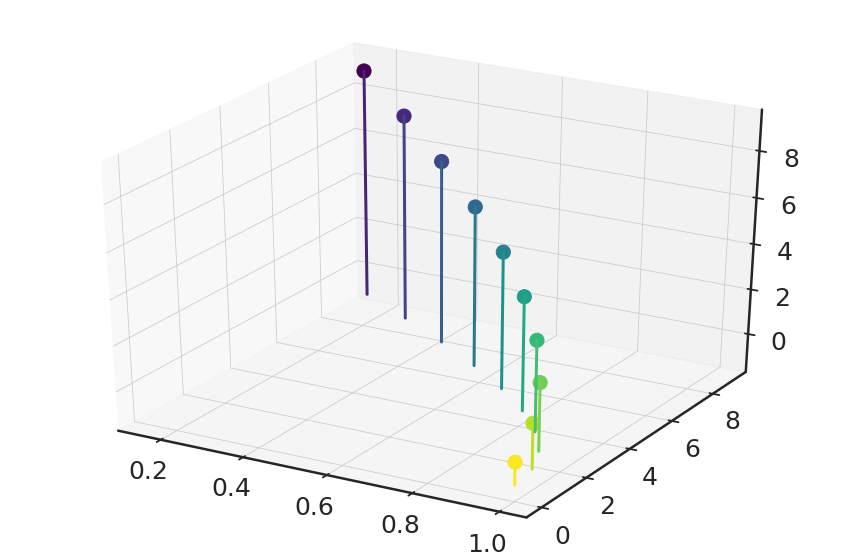

In [891]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
import numpy as np

fig = plt.figure(figsize=(15,10))

ax = fig.add_subplot(111, projection='3d')

# points
xs = np.asarray([np.cos(i) for i in np.arange(0,np.pi/2,(np.pi/2)/10)])
ys = np.arange(0,10,1)
zs = np.arange(0,10,1)

# plot points
ax.scatter(xs=xs, ys=ys, zs=zs, s=200, c=zs, cmap=cm.viridis_r, alpha=1.0)

# create the line
zs_l = np.asarray([[i, -1] for i in zs])

# color list
cl = [cm.get_cmap('viridis_r')(i/zs_l.shape[0]) for i in range(zs_l.shape[0])]
# draw the lines 
for i, p in enumerate(zs_l):
    ax.plot(xs=[xs[i]]*2, ys=[ys[i]]*2, zs=zs_l[i], markersize=0, lw=3, c=cl[i])
    
fig.savefig('/home/dsvieira/Desktop/stack_over.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/geopandas/plotting.py:389: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  "'color'.", UserWarning)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:489: RuntimeWarning: invalid value encountered in less
  np.copyto(xa, -1, where=xa < 0.0)


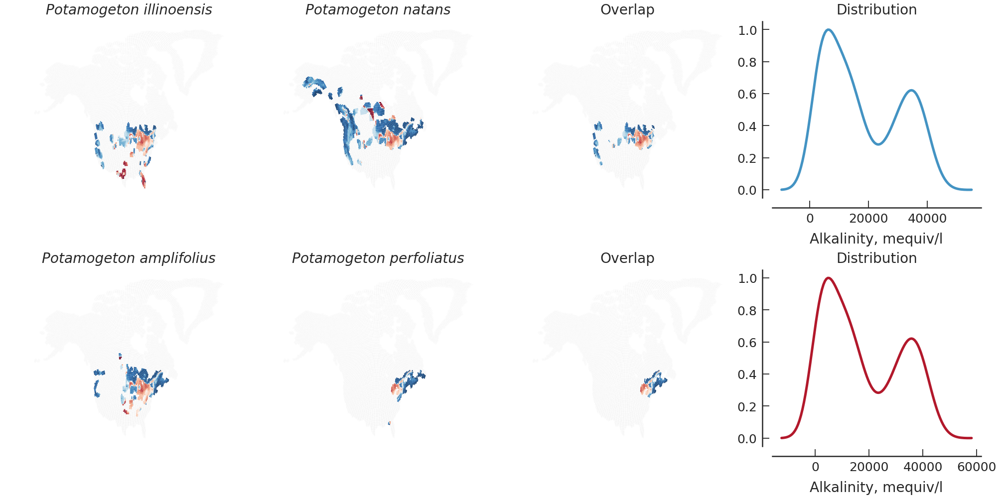

In [830]:
fig, ax = plt.subplots(2, 4, figsize=stdfigsize(nx=4, ny=2, ratio=1))

_kwargs_alk = dict(lw=0, vmin=occurrences_within_5050_grid_north_america['alkalinity'].min(), vmax=occurrences_within_5050_grid_north_america['alkalinity'].max(), cmap=_cmap)
_cmap   = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap
_colors = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors

# first row
[occurrences_within_5050_grid_north_america.to_crs(wgs84_proj_dict).plot(column='alkalinity', lw=0.01, color='white', edgecolor='k', ax=ax[0,i]) for i in range(3)]
potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][0]] == 1].plot(column='alkalinity', ax=ax[0,0], **_kwargs_alk)
potamogeton_alk[potamogeton_alk[potamogeton_pairs[174][1]] == 1].plot(column='alkalinity', ax=ax[0,1], **_kwargs_alk)
potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2].plot(column='alkalinity', ax=ax[0,2], **_kwargs_alk)

# g_1 = sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[174]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[0,3], hist=False, kde_kws={"color": _colors[2], "lw": 5})
# get distplot line points
line_1 = g_1.get_lines()[0]
xd_1 = line_1.get_xdata()
yd_1 = line_1.get_ydata()

def normalize(x):
        return (x - x.min(0)) / x.ptp(0)
    #normalize points

yd_1_2 = normalize(yd_1)
ax[0,3].plot(xd_1, yd_1_2, color=_colors[2], lw=5)

ax[0,0].set_title(potamogeton_pairs[174][0], style='italic')
ax[0,1].set_title(potamogeton_pairs[174][1], style='italic')
ax[0,2].set_title('Overlap')
ax[0,3].set_title('Distribution')

# second row
[occurrences_within_5050_grid_north_america.to_crs(wgs84_proj_dict).plot(column='alkalinity', lw=0.01, color='white', edgecolor='k', ax=ax[1,i]) for i in range(3)]
potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][0]] == 1].plot(column='alkalinity', ax=ax[1,0], **_kwargs_alk)
potamogeton_alk[potamogeton_alk[potamogeton_pairs[35][1]] == 1].plot(column='alkalinity', ax=ax[1,1], **_kwargs_alk)
potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2].plot(column='alkalinity', ax=ax[1,2], **_kwargs_alk)

# g_2 = sns.distplot(potamogeton_alk[potamogeton_alk[potamogeton_pairs[35]].sum(axis=1) == 2]['alkalinity'].dropna(), ax=ax[1,3], hist=False, kde_kws={"color": _colors[-2], "lw": 5})
# get distplot line points
line_2 = g_2.get_lines()[0]
xd_2 = line_2.get_xdata()
yd_2 = line_2.get_ydata()

def normalize(x):
        return (x - x.min(0)) / x.ptp(0)
    #normalize points

yd_2_2 = normalize(yd)
ax[1,3].plot(xd_2, yd_2_2, color=_colors[-2], lw=5)

ax[1,0].set_title(potamogeton_pairs[35][0], style='italic')
ax[1,1].set_title(potamogeton_pairs[35][1], style='italic')
ax[1,2].set_title('Overlap')
ax[1,3].set_title('Distribution')

c = 0
for _ax in ax.flat:
    if c < 3:
        _ax.set_axis_off()
    elif c > 3 and c < 7:
        _ax.set_axis_off()
    else:
        for loc, spine in _ax.spines.items():
            if loc in ['left', 'bottom']:
                spine.set_position(('outward', 20)) # outward by 20 points
            elif loc in ['right','top']:
                spine.set_color('none') # don't draw spine
            else:
                raise ValueError('unknown spine location: %s'%loc)
    
        # Only show ticks on the left and bottom spines
        _ax.yaxis.set_ticks_position('left')
        _ax.xaxis.set_ticks_position('bottom')
        
        _ax.set_xlabel('Alkalinity, mequiv/l')
    
    c += 1
    


fig.tight_layout()
fig.savefig('figures/species_overlap_ex_2.pdf', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/colors.py:489: RuntimeWarning: invalid value encountered in less
  np.copyto(xa, -1, where=xa < 0.0)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2022: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


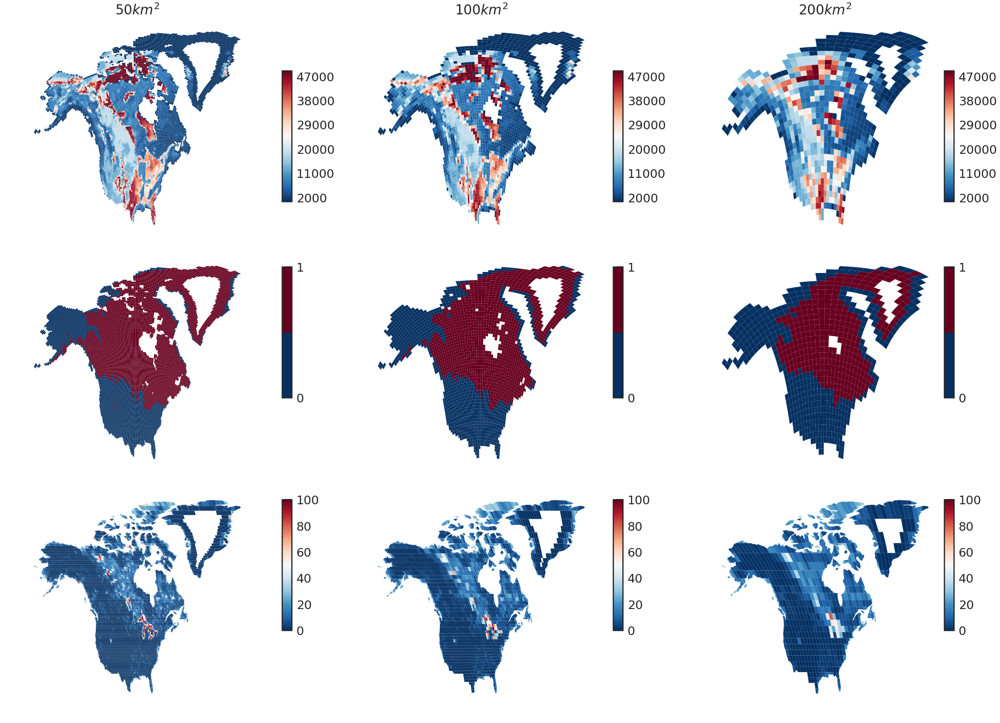

In [188]:
fig, ax = plt.subplots(3, 3, figsize=stdfigsize(ny=3, nx=3))

_cmap = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap

c = 0
for feature in ['alkalinity', 'lgm', 'water']:#['mean_temp', 'mean_prec', 'mean_vtemp', 
    if feature == 'water':
        occurrences_within_5050_grid_north_america_weck4.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,0], lw=0, vmin=occurrences_within_5050_grid_north_america_weck4[feature].min(), vmax=occurrences_within_5050_grid_north_america_weck4[feature].max(), cmap=_cmap)
        occurrences_within_100100_grid_north_america_weck4.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,1], lw=0, vmin=occurrences_within_100100_grid_north_america_weck4[feature].min(), vmax=occurrences_within_100100_grid_north_america_weck4[feature].max(), cmap=_cmap)
        occurrences_within_200200_grid_north_america_weck4.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,2], lw=0, vmin=occurrences_within_200200_grid_north_america_weck4[feature].min(), vmax=occurrences_within_200200_grid_north_america_weck4[feature].max(), cmap=_cmap)
    
    else: 
        occurrences_within_5050_grid_north_america.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,0], lw=0, vmin=occurrences_within_5050_grid_north_america[feature].min(), vmax=occurrences_within_5050_grid_north_america[feature].max(), cmap=_cmap)
        occurrences_within_100100_grid_north_america.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,1], lw=0, vmin=occurrences_within_100100_grid_north_america[feature].min(), vmax=occurrences_within_100100_grid_north_america[feature].max(), cmap=_cmap)
        occurrences_within_200200_grid_north_america.to_crs(wgs84_proj_dict).plot(column=feature, ax=ax[c,2], lw=0, vmin=occurrences_within_200200_grid_north_america[feature].min(), vmax=occurrences_within_200200_grid_north_america[feature].max(), cmap=_cmap)
    
    
#     ax[0,0].annotate('Temp. média, $^\circ$C', xy=(0, 0.5), xycoords='axes fraction', rotation=90, fontsize=30)
    
    c += 1
    

c = 0
for axx in ax.flat:
    if c < 3:
        axx.set_title(['$50km^2$', '$100km^2$', '$200km^2$'][c])
    axx.axis('off')

    
    c += 1

    
# alkalinity
# im_1 = ax[0,0].imshow(np.random.random((10,10)), vmin=occurrences_within_5050_grid_north_america['alkalinity'].min(), vmax=occurrences_within_5050_grid_north_america['alkalinity'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
# im_2 = ax[0,1].imshow(np.random.random((10,10)), vmin=occurrences_within_100100_grid_north_america['alkalinity'].min(), vmax=occurrences_within_100100_grid_north_america['alkalinity'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
# im_3 = ax[0,2].imshow(np.random.random((10,10)), vmin=occurrences_within_200200_grid_north_america['alkalinity'].min(), vmax=occurrences_within_200200_grid_north_america['alkalinity'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)

# lgm
# im_4 = ax[1,0].imshow(np.random.random((10,10)), vmin=occurrences_within_5050_grid_north_america['lgm'].min()  , vmax=occurrences_within_5050_grid_north_america['lgm'].max()  , cmap=plt.get_cmap('RdBu_r', 2))
# im_5 = ax[1,1].imshow(np.random.random((10,10)), vmin=occurrences_within_100100_grid_north_america['lgm'].min(), vmax=occurrences_within_100100_grid_north_america['lgm'].max(), cmap=plt.get_cmap('RdBu_r', 2))
# im_6 = ax[1,2].imshow(np.random.random((10,10)), vmin=occurrences_within_200200_grid_north_america['lgm'].min(), vmax=occurrences_within_200200_grid_north_america['lgm'].max(), cmap=plt.get_cmap('RdBu_r', 2))

# water
# im_7 = ax[2,0].imshow(np.random.random((10,10)), vmin=occurrences_within_5050_grid_north_america_weck4['water'].min(), vmax=occurrences_within_5050_grid_north_america_weck4['water'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
# im_8 = ax[2,1].imshow(np.random.random((10,10)), vmin=occurrences_within_100100_grid_north_america_weck4['water'].min(), vmax=occurrences_within_100100_grid_north_america_weck4['water'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
# im_9 = ax[2,2].imshow(np.random.random((10,10)), vmin=occurrences_within_200200_grid_north_america_weck4['water'].min(), vmax=occurrences_within_200200_grid_north_america_weck4['water'].max(), cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)

# alkalinity
cbar_ax_1 = fig.add_axes([0.30, 0.72, 0.01, 0.18])
cbar_ax_2 = fig.add_axes([0.65, 0.72, 0.01, 0.18])
cbar_ax_3 = fig.add_axes([1.00, 0.72, 0.01, 0.18])
fig.colorbar(im_1, cax=cbar_ax_1, ticks=np.arange(2000, 50000, 9000))
fig.colorbar(im_2, cax=cbar_ax_2, ticks=np.arange(2000, 50000, 9000))
fig.colorbar(im_3, cax=cbar_ax_3, ticks=np.arange(2000, 50000, 9000))

# lgm
cbar_ax_4 = fig.add_axes([0.30, 0.45, 0.01, 0.18])
cbar_ax_5 = fig.add_axes([0.65, 0.45, 0.01, 0.18])
cbar_ax_6 = fig.add_axes([1.00, 0.45, 0.01, 0.18])
fig.colorbar(im_4, cax=cbar_ax_4, ticks=[0,1])
fig.colorbar(im_5, cax=cbar_ax_5, ticks=[0,1])
fig.colorbar(im_6, cax=cbar_ax_6, ticks=[0,1])

# water
cbar_ax_7 = fig.add_axes([0.30, 0.13, 0.01, 0.18])
cbar_ax_8 = fig.add_axes([0.65, 0.13, 0.01, 0.18])
cbar_ax_9 = fig.add_axes([1.00, 0.13, 0.01, 0.18])
fig.colorbar(im_7, cax=cbar_ax_7)
fig.colorbar(im_8, cax=cbar_ax_8)
fig.colorbar(im_9, cax=cbar_ax_9)
                      
fig.tight_layout(w_pad=20)
# fig.suptitle(feature, fontsize=40);
# rasterize_list = [axx for axx in ax.flat]
# rasterize_and_save('dep_pres_all.svg', rasterize_list, fig=fig, dpi=120)
# rasterize_and_save('/home/dsvieira/Desktop/test_r.pdf', rasterize_list, fig=fig, dpi=120)
# fig.savefig('/home/dsvieira/Desktop/north_america_env_features_2.pdf', bbox_inches='tight')

# Environmental features within overlapping
<a id="environmental-features-within"></a>
<a href="#summary">Summary</a>

## Calculating the overlap
<a id="calculating-the-overlap"></a>
<a href="#summary">Summary</a>

In [39]:
# def overlap_features(df, genus_pair):
    
#     l = []

#     # loop throught the rows of sister species
#     for row in range(genus_pair.shape[0]):
#         # current pair
#         pair = list(genus_pair.loc[row, ['sp1', 'sp2']])
#         # mask the grids where they appear together
#         df_overlay = df[df[pair].sum(axis=1) != 0]
       
#         # calculate the sympatry
#         pair_areas = [df_overlay[df_overlay[p] == 1].to_crs(nad83_proj_dict).area.sum() for p in pair]
#         sympatry = min(pair_areas)/sum(pair_areas)
        
#         # grab the environmental features for the pair overlap
#         mean_temp  = list(df_overlay['mean_temp'])
#         mean_prec  = list(df_overlay['mean_prec'])
#         mean_vtemp = list(df_overlay['mean_vtemp'])
#         alkalinity = list(df_overlay['alkalinity'])
# #         water      = list(df_overlay['water'])
#         lgm        = list(df_overlay['lgm'])
#         glac_perc  = df_overlay[df_overlay['lgm'] == 1].shape[0] / df_overlay.shape[0]
#         nglac_perc = df_overlay[df_overlay['lgm'] == 0].shape[0] / df_overlay.shape[0]
#         area       = df_overlay.to_crs(nad83_proj_dict).area.sum()
#         grids      = df_overlay.shape[0]

#         # create a pd.DataFrame with these features' lists
#         overlay_features_df = pd.DataFrame([[mean_temp, mean_prec, mean_vtemp,
#                   alkalinity, lgm, glac_perc, nglac_perc, area, pair_areas[0], pair_areas[1], grids, sympatry]],
#                  columns=['mean_temp', 'mean_prec', 'mean_vtemp',
#                           'alkalinity', 'lgm', 'glac_perc', 
#                           'nglac_perc', 'area', 'area1', 'area2', 
#                           'grids', 'sympatry'
#                          ]
#                 )

#         # concat the current row of genus, sp1, and sp2 with the lists of features
#         l.append(pd.concat([genus_pair.loc[[row],:].reset_index(drop=True), overlay_features_df], axis=1))

#     # concatenate all the row
#     return pd.concat(l).reset_index(drop=True)

In [15]:
def sp_polygon_from_grids(df):

    l = []
    for sp in df.columns[df.columns.str.contains('^[0-9]')]:
        gdf_tmp = df[df[sp] == 1].dissolve(sp)[['geometry']].reset_index(drop=True)
        gdf_tmp['area']   = gdf_tmp.area
        gdf_tmp['specie'] = sp.split('_')[1]
        gdf_tmp['genus']  = sp.split('_')[1].split()[0]
        l.append(gdf_tmp)
    return pd.concat(l).reset_index(drop=True)

In [16]:
def overlap_features(df, genus_pair):
    
    l = []

    # loop throught the rows of sister species
    for row in range(genus_pair.shape[0]):
        # current pair
        pair = list(genus_pair.loc[row, ['sp1', 'sp2']])
        # mask the grids where they appear together
        df_overlay = df[df[pair].sum(axis=1) == 2]
        
        if df_overlay.shape[0] != 0:
            df_overlay['dummy_index'] = np.full(df_overlay.shape[0], 2)
            overlay_area = df_overlay.dissolve('dummy_index')[['geometry']].reset_index(drop=True).to_crs(weck4_proj_dict).area.iloc[0]
            # calculate the sympatry
#             pair_areas = [df[df[p] == 1].to_crs(weck4_proj_dict).area.sum() for p in pair]
            pair_areas = [df[df[sp] == 1].dissolve(sp)[['geometry']].reset_index(drop=True).to_crs(weck4_proj_dict).area.iloc[0] for sp in pair]
            pair_grids = [df[df[sp] == 1].shape[0] for sp in pair]
            
            sympatry = overlay_area/min(pair_areas)
            sympatry_grids = df_overlay.shape[0]/min(pair_grids)

            # grab the environmental features for the pair overlap
            mean_temp  = list(df_overlay['mean_temp'])
            mean_prec  = list(df_overlay['mean_prec'])
            mean_vtemp = list(df_overlay['mean_vtemp'])
            alkalinity = list(df_overlay['alkalinity'])
    #         water      = list(df_overlay['water'])
            lgm        = list(df_overlay['lgm'])
            glac_perc  = df_overlay[df_overlay['lgm'] == 1].shape[0] / df_overlay.shape[0]
            nglac_perc = df_overlay[df_overlay['lgm'] == 0].shape[0] / df_overlay.shape[0]
#             area       = df_overlay.to_crs(weck4_proj_dict).area.sum()
            area       = overlay_area
            grids      = df_overlay.shape[0]

            # create a pd.DataFrame with these features' lists
            overlay_features_df = pd.DataFrame([[mean_temp, mean_prec, mean_vtemp,
                      alkalinity, lgm, glac_perc, nglac_perc, area, pair_areas[0], pair_areas[1], 
                                                 grids, pair_grids[0], pair_grids[1], 
                                                 sympatry, sympatry_grids]],
                     columns=['mean_temp', 'mean_prec', 'mean_vtemp',
                              'alkalinity', 'lgm', 'glac_perc', 
                              'nglac_perc', 'area', 'area1', 'area2', 
                              'grids', 'grids1', 'grids2', 
                              'sympatry', 'sympatry_grids'
                             ]
                    )

            # concat the current row of genus, sp1, and sp2 with the lists of features
            l.append(pd.concat([genus_pair.loc[[row],:].reset_index(drop=True), overlay_features_df], axis=1))

    # concatenate all the row
    return pd.concat(l).reset_index(drop=True)

In [349]:
overlap_features_5050_europe   = overlap_features(occurrences_within_5050_grid_europe, genus_pairs_df_europe)
overlap_features_100100_europe = overlap_features(occurrences_within_100100_grid_europe, genus_pairs_df_europe)
overlap_features_200200_europe = overlap_features(occurrences_within_200200_grid_europe, genus_pairs_df_europe)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]


In [350]:
overlap_features_5050_north_america   = overlap_features(occurrences_within_5050_grid_north_america, genus_pairs_df_north_america)
overlap_features_100100_north_america = overlap_features(occurrences_within_100100_grid_north_america, genus_pairs_df_north_america)
overlap_features_200200_north_america = overlap_features(occurrences_within_200200_grid_north_america, genus_pairs_df_north_america)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  del sys.path[0]


For the common species between the both continents.

In [351]:
overlap_features_5050_europe_common = overlap_features_5050_europe[(overlap_features_5050_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_europe_common = overlap_features_100100_europe[(overlap_features_100100_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_europe_common = overlap_features_200200_europe[(overlap_features_200200_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [352]:
overlap_features_5050_north_america_common = overlap_features_5050_north_america[(overlap_features_5050_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_north_america_common = overlap_features_100100_north_america[(overlap_features_100100_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_north_america_common = overlap_features_200200_north_america[(overlap_features_200200_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

For the water distribution.

In [355]:
def overlap_features_water(df, genus_pair):
    
    l = []

    # loop throught the rows of sister species
    for row in range(genus_pair.shape[0]):
#         # current pair
#         pair = list(genus_pair.loc[row, ['sp1', 'sp2']])
#         # mask the grids where they appear together
#         df_overlay = df[df[pair].sum(axis=1) == 2]
        
#         if df_overlay.shape[0] != 0:
#             # calculate the sympatry
#             pair_areas = [df[df[p] == 1].to_crs(nad83_proj_dict).area.sum() for p in pair]
#             sympatry = df_overlay.to_crs(nad83_proj_dict).area.sum()/max(pair_areas)
            # current pair
    
        pair = list(genus_pair.loc[row, ['sp1', 'sp2']])
        # mask the grids where they appear together
        df_overlay = df[df[pair].sum(axis=1) == 2]
        
        if df_overlay.shape[0] != 0:
            df_overlay['dummy_index'] = np.full(df_overlay.shape[0], 2)
            overlay_area = df_overlay.dissolve('dummy_index')[['geometry']].reset_index(drop=True).to_crs(weck4_proj_dict).area.iloc[0]
            # calculate the sympatry
#             pair_areas = [df[df[p] == 1].to_crs(weck4_proj_dict).area.sum() for p in pair]
            pair_areas = [df[df[sp] == 1].dissolve(sp)[['geometry']].reset_index(drop=True).to_crs(weck4_proj_dict).area.iloc[0] for sp in pair]
            pair_grids = [df[df[sp] == 1].shape[0] for sp in pair]
            
            sympatry = overlay_area/min(pair_areas)
            sympatry_grids = df_overlay.shape[0]/min(pair_grids)
        
            # grab the environmental features for the pair overlap
            water      = list(df_overlay['water'])
            area       = df_overlay.to_crs(weck4_proj_dict).area.sum()
            grids      = df_overlay.shape[0]

            # create a pd.DataFrame with these features' lists
            overlay_features_df = pd.DataFrame([[water, area, pair_areas[0], pair_areas[1], 
                                                 grids, pair_grids[0], pair_grids[1], 
                                                 sympatry, sympatry_grids]],
                     columns=['water', 'area', 'area1', 'area2', 'grids', 'grids1', 'grids2', 
                              'sympatry', 'sympatry_grids']
                    )

            # concat the current row of genus, sp1, and sp2 with the lists of features
            l.append(pd.concat([genus_pair.loc[[row],:].reset_index(drop=True), overlay_features_df], axis=1))

    # concatenate all the row
    return pd.concat(l).reset_index(drop=True)

In [356]:
overlap_features_5050_europe_weck4   = overlap_features_water(occurrences_within_5050_grid_europe_weck4, genus_pairs_df_europe)
overlap_features_100100_europe_weck4 = overlap_features_water(occurrences_within_100100_grid_europe_weck4, genus_pairs_df_europe)
overlap_features_200200_europe_weck4 = overlap_features_water(occurrences_within_200200_grid_europe_weck4, genus_pairs_df_europe)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [357]:
overlap_features_5050_north_america_weck4   = overlap_features_water(occurrences_within_5050_grid_north_america_weck4, genus_pairs_df_north_america)
overlap_features_100100_north_america_weck4 = overlap_features_water(occurrences_within_100100_grid_north_america_weck4, genus_pairs_df_north_america)
overlap_features_200200_north_america_weck4 = overlap_features_water(occurrences_within_200200_grid_north_america_weck4, genus_pairs_df_north_america)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [358]:
overlap_features_5050_europe_weck4_common = overlap_features_5050_europe_weck4[(overlap_features_5050_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_europe_weck4_common = overlap_features_100100_europe_weck4[(overlap_features_100100_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_europe_weck4_common = overlap_features_200200_europe_weck4[(overlap_features_200200_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [359]:
overlap_features_5050_north_america_weck4_common = overlap_features_5050_north_america_weck4[(overlap_features_5050_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_north_america_weck4_common = overlap_features_100100_north_america_weck4[(overlap_features_100100_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_north_america_weck4_common = overlap_features_200200_north_america_weck4[(overlap_features_200200_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [360]:
# overlap_features_5050_europe.to_csv('../results/overlap_env_features/europe/5050/overlap_features_5050_europe.shp', sep='\t', index=False)
# overlap_features_100100_europe.to_csv('../results/overlap_env_features/europe/100100/overlap_features_100100_europe.shp', sep='\t', index=False)
# overlap_features_200200_europe.to_csv('../results/overlap_env_features/europe/200200/overlap_features_200200_europe.shp', sep='\t', index=False)

In [361]:
# overlap_features_5050_north_america.to_csv('../results/overlap_env_features/north_america/5050/overlap_features_5050_north_america.shp', sep='\t', index=False)
# overlap_features_100100_north_america.to_csv('../results/overlap_env_features/north_america/100100/overlap_features_100100_north_america.shp', sep='\t', index=False)
# overlap_features_200200_north_america.to_csv('../results/overlap_env_features/north_america/200200/overlap_features_200200_north_america.shp', sep='\t', index=False)

In [362]:
# overlap_features_5050_europe_weck4.to_csv('../results/overlap_env_features/europe/5050_water/overlap_features_5050_europe_water.shp', sep='\t', index=False)
# overlap_features_100100_europe_weck4.to_csv('../results/overlap_env_features/europe/100100_water/overlap_features_100100_europe_water.shp', sep='\t', index=False)
# overlap_features_200200_europe_weck4.to_csv('../results/overlap_env_features/europe/200200_water/overlap_features_200200_europe_water.shp', sep='\t', index=False)

In [363]:
# overlap_features_5050_north_america_weck4.to_csv('../results/overlap_env_features/north_america/5050_water/overlap_features_5050_north_america_water.shp', sep='\t', index=False)
# overlap_features_100100_north_america_weck4.to_csv('../results/overlap_env_features/north_america/100100_water/overlap_features_100100_north_america_water.shp', sep='\t', index=False)
# overlap_features_200200_north_america_weck4.to_csv('../results/overlap_env_features/north_america/200200_water/overlap_features_200200_north_america_water.shp', sep='\t', index=False)

Number of pairs considering the spatial scale.

In [365]:
(overlap_features_5050_europe.shape[0], overlap_features_100100_europe.shape[0], overlap_features_200200_europe.shape[0])

(376, 376, 380)

In [366]:
(overlap_features_5050_north_america.shape[0], overlap_features_100100_north_america.shape[0], overlap_features_200200_north_america.shape[0])

(602, 607, 613)

In [369]:
[i*100 for i in [4/376, 5/602, 11/602]]

[1.0638297872340425, 0.8305647840531563, 1.8272425249169437]

When we increase the spatial scale of grids, the number of pairs increase slightly. Comparing with the 50x50 grids, when considering the 100x100 grids, we have 5 more pairs for North America (0.8\% more) and for the 200x200 grids we have 4 more pairs for Europe and 11 for North America (1\% and 1.8\%, respectively, more).

## Comparisons between $50km^2$, $100km^2$, and $200km^2$ for features distributions in overlapping areas
<a id="comparisons-between-50-100-200"></a>
<a href="#summary">Summary</a>

### Load the environmental features within the overlapping areas for sister species
<a id="load-the-environmental-features"></a>
<a href="#summary">Summary</a>

In [329]:
overlap_features_5050_europe   = pd.read_table('../results/overlap_env_features/europe/5050/overlap_features_5050_europe.shp')
overlap_features_100100_europe = pd.read_table('../results/overlap_env_features/europe/100100/overlap_features_100100_europe.shp')
overlap_features_200200_europe = pd.read_table('../results/overlap_env_features/europe/200200/overlap_features_200200_europe.shp')

In [330]:
overlap_features_5050_north_america   = pd.read_table('../results/overlap_env_features/north_america/5050/overlap_features_5050_north_america.shp')
overlap_features_100100_north_america = pd.read_table('../results/overlap_env_features/north_america/100100/overlap_features_100100_north_america.shp')
overlap_features_200200_north_america = pd.read_table('../results/overlap_env_features/north_america/200200/overlap_features_200200_north_america.shp')

In [331]:
overlap_features_5050_europe_weck4   = pd.read_table('../results/overlap_env_features/europe/5050_water/overlap_features_5050_europe_water.shp')
overlap_features_100100_europe_weck4 = pd.read_table('../results/overlap_env_features/europe/100100_water/overlap_features_100100_europe_water.shp')
overlap_features_200200_europe_weck4 = pd.read_table('../results/overlap_env_features/europe/200200_water/overlap_features_200200_europe_water.shp')

In [332]:
overlap_features_5050_north_america_weck4   = pd.read_table('../results/overlap_env_features/north_america/5050_water/overlap_features_5050_north_america_water.shp')
overlap_features_100100_north_america_weck4 = pd.read_table('../results/overlap_env_features/north_america/100100_water/overlap_features_100100_north_america_water.shp')
overlap_features_200200_north_america_weck4 = pd.read_table('../results/overlap_env_features/north_america/200200_water/overlap_features_200200_north_america_water.shp')

Due to the slightly increase in pairs overlapping considering higher spatial scales, we select the pairs concerning the smallest spatial scale, i.e., 50x50.

In [333]:
def fix_scaled_overlaped_pairs(df_ref, df_to_fix):
    return df_to_fix.merge(df_ref[['sp1', 'sp2']], how='inner', on=['sp1', 'sp2'])
#     return df_to_fix[df_to_fix.set_index(['sp1', 'sp2']).index.isin(df_ref.set_index(['sp1', 'sp2']).index)]

In [334]:
overlap_features_100100_europe = fix_scaled_overlaped_pairs(overlap_features_5050_europe, overlap_features_100100_europe)
overlap_features_200200_europe = fix_scaled_overlaped_pairs(overlap_features_5050_europe, overlap_features_200200_europe)

overlap_features_5050_europe_weck4   = fix_scaled_overlaped_pairs(overlap_features_5050_europe, overlap_features_5050_europe_weck4)
overlap_features_100100_europe_weck4 = fix_scaled_overlaped_pairs(overlap_features_5050_europe_weck4, overlap_features_100100_europe_weck4)
overlap_features_200200_europe_weck4 = fix_scaled_overlaped_pairs(overlap_features_5050_europe_weck4, overlap_features_200200_europe_weck4)

In [335]:
overlap_features_5050_north_america   = fix_scaled_overlaped_pairs(overlap_features_5050_north_america, overlap_features_5050_north_america)
overlap_features_100100_north_america = fix_scaled_overlaped_pairs(overlap_features_5050_north_america, overlap_features_100100_north_america)
overlap_features_200200_north_america = fix_scaled_overlaped_pairs(overlap_features_5050_north_america, overlap_features_200200_north_america)

overlap_features_5050_north_america_weck4   = fix_scaled_overlaped_pairs(overlap_features_5050_north_america, overlap_features_5050_north_america_weck4)
overlap_features_100100_north_america_weck4 = fix_scaled_overlaped_pairs(overlap_features_5050_north_america_weck4, overlap_features_100100_north_america_weck4)
overlap_features_200200_north_america_weck4 = fix_scaled_overlaped_pairs(overlap_features_5050_north_america_weck4, overlap_features_200200_north_america_weck4)

In [336]:
[(overlap_features_5050_europe[['sp1', 'sp2']] == overlap_features_100100_europe[['sp1', 'sp2']]).all(axis=1).all(),
(overlap_features_5050_europe[['sp1', 'sp2']] == overlap_features_200200_europe[['sp1', 'sp2']]).all(axis=1).all(),
 (overlap_features_100100_europe[['sp1', 'sp2']] == overlap_features_200200_europe[['sp1', 'sp2']]).all(axis=1).all(),
]

[True, True, True]

In [337]:
[(overlap_features_5050_europe_weck4[['sp1', 'sp2']] == overlap_features_100100_europe_weck4[['sp1', 'sp2']]).all(axis=1).all(),
(overlap_features_5050_europe_weck4[['sp1', 'sp2']] == overlap_features_200200_europe_weck4[['sp1', 'sp2']]).all(axis=1).all(),
 (overlap_features_100100_europe_weck4[['sp1', 'sp2']] == overlap_features_200200_europe_weck4[['sp1', 'sp2']]).all(axis=1).all(),
]

[True, True, True]

In [338]:
[(overlap_features_5050_north_america[['sp1', 'sp2']] == overlap_features_100100_north_america[['sp1', 'sp2']]).all(axis=1).all(),
(overlap_features_5050_north_america[['sp1', 'sp2']] == overlap_features_200200_north_america[['sp1', 'sp2']]).all(axis=1).all(),
 (overlap_features_100100_north_america[['sp1', 'sp2']] == overlap_features_200200_north_america[['sp1', 'sp2']]).all(axis=1).all(),
]

[True, True, True]

In [339]:
[(overlap_features_5050_north_america_weck4[['sp1', 'sp2']] == overlap_features_100100_north_america_weck4[['sp1', 'sp2']]).all(axis=1).all(),
(overlap_features_5050_north_america_weck4[['sp1', 'sp2']] == overlap_features_200200_north_america_weck4[['sp1', 'sp2']]).all(axis=1).all(),
 (overlap_features_100100_north_america_weck4[['sp1', 'sp2']] == overlap_features_200200_north_america_weck4[['sp1', 'sp2']]).all(axis=1).all(),
]

[True, True, True]

In [340]:
[
    [(overlap_features_5050_europe['sp1'] == overlap_features_100100_europe['sp1']).all(), (overlap_features_5050_europe['sp2'] == overlap_features_100100_europe['sp2']).all()],
    [(overlap_features_5050_europe['sp1'] == overlap_features_200200_europe['sp1']).all(), (overlap_features_5050_europe['sp2'] == overlap_features_200200_europe['sp2']).all()],
    [(overlap_features_100100_europe['sp1'] == overlap_features_200200_europe['sp1']).all(), (overlap_features_100100_europe['sp2'] == overlap_features_200200_europe['sp2']).all()]
]

[[True, True], [True, True], [True, True]]

In [341]:
[
    [(overlap_features_5050_europe_weck4['sp1'] == overlap_features_100100_europe_weck4['sp1']).all(), (overlap_features_5050_europe_weck4['sp2'] == overlap_features_100100_europe_weck4['sp2']).all()],
    [(overlap_features_5050_europe_weck4['sp1'] == overlap_features_200200_europe_weck4['sp1']).all(), (overlap_features_5050_europe_weck4['sp2'] == overlap_features_200200_europe_weck4['sp2']).all()],
    [(overlap_features_100100_europe_weck4['sp1'] == overlap_features_200200_europe_weck4['sp1']).all(), (overlap_features_100100_europe_weck4['sp2'] == overlap_features_200200_europe_weck4['sp2']).all()]
]

[[True, True], [True, True], [True, True]]

In [342]:
[
    [(overlap_features_5050_north_america['sp1'] == overlap_features_100100_north_america['sp1']).all(), (overlap_features_5050_north_america['sp2'] == overlap_features_100100_north_america['sp2']).all()],
    [(overlap_features_5050_north_america['sp1'] == overlap_features_200200_north_america['sp1']).all(), (overlap_features_5050_north_america['sp2'] == overlap_features_200200_north_america['sp2']).all()],
    [(overlap_features_100100_north_america['sp1'] == overlap_features_200200_north_america['sp1']).all(), (overlap_features_100100_north_america['sp2'] == overlap_features_200200_north_america['sp2']).all()]
]

[[True, True], [True, True], [True, True]]

In [343]:
[
    [(overlap_features_5050_north_america_weck4['sp1'] == overlap_features_100100_north_america_weck4['sp1']).all(), (overlap_features_5050_north_america_weck4['sp2'] == overlap_features_100100_north_america_weck4['sp2']).all()],
    [(overlap_features_5050_north_america_weck4['sp1'] == overlap_features_200200_north_america_weck4['sp1']).all(), (overlap_features_5050_north_america_weck4['sp2'] == overlap_features_200200_north_america_weck4['sp2']).all()],
    [(overlap_features_100100_north_america_weck4['sp1'] == overlap_features_200200_north_america_weck4['sp1']).all(), (overlap_features_100100_north_america_weck4['sp2'] == overlap_features_200200_north_america_weck4['sp2']).all()]
]

[[True, True], [True, True], [True, True]]

Now we select the overlap just for the common species in borth continents.

In [348]:
overlap_features_5050_europe_common = pd.concat([overlap_features_5050_europe[(overlap_features_5050_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_europe_common = pd.concat([overlap_features_100100_europe[(overlap_features_100100_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_europe_common = pd.concat([overlap_features_200200_europe[(overlap_features_200200_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [349]:
overlap_features_5050_europe_weck4_common = pd.concat([overlap_features_5050_europe_weck4[(overlap_features_5050_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_europe_weck4_common = pd.concat([overlap_features_100100_europe_weck4[(overlap_features_100100_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_europe_weck4_common = pd.concat([overlap_features_200200_europe_weck4[(overlap_features_200200_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [350]:
overlap_features_5050_north_america_common = pd.concat([overlap_features_5050_north_america[(overlap_features_5050_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_north_america_common = pd.concat([overlap_features_100100_north_america[(overlap_features_100100_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_north_america_common = pd.concat([overlap_features_200200_north_america[(overlap_features_200200_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [351]:
overlap_features_5050_north_america_weck4_common = pd.concat([overlap_features_5050_north_america_weck4[(overlap_features_5050_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_north_america_weck4_common = pd.concat([overlap_features_100100_north_america_weck4[(overlap_features_100100_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_north_america_weck4_common = pd.concat([overlap_features_200200_north_america_weck4[(overlap_features_200200_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

### Checking the names of each species within the overlap dataframes
<a id="checking-the-names"></a>
<a href="#summary">Summary</a>

Done at the end of the previous session.

In [345]:
(overlap_features_5050_europe['sp1'] == overlap_features_100100_europe['sp1']).all(), (overlap_features_5050_europe['sp1'] == overlap_features_200200_europe['sp1']).all(), (overlap_features_100100_europe['sp1'] == overlap_features_200200_europe['sp1']).all()

(True, True, True)

In [44]:
(overlap_features_5050_europe['sp2'] == overlap_features_100100_europe['sp2']).all(), (overlap_features_5050_europe['sp2'] == overlap_features_200200_europe['sp2']).all(), (overlap_features_100100_europe['sp2'] == overlap_features_200200_europe['sp2']).all()

(True, True, True)

In [45]:
(overlap_features_5050_north_america['sp1'] == overlap_features_100100_north_america['sp1']).all(), (overlap_features_5050_north_america['sp1'] == overlap_features_200200_north_america['sp1']).all(), (overlap_features_100100_north_america['sp1'] == overlap_features_200200_north_america['sp1']).all()

(True, True, True)

In [46]:
(overlap_features_5050_north_america['sp2'] == overlap_features_100100_north_america['sp2']).all(), (overlap_features_5050_north_america['sp2'] == overlap_features_200200_north_america['sp2']).all(), (overlap_features_100100_north_america['sp2'] == overlap_features_200200_north_america['sp2']).all()

(True, True, True)

In [47]:
(overlap_features_5050_europe_weck4['sp1'] == overlap_features_100100_europe_weck4['sp1']).all(), (overlap_features_5050_europe_weck4['sp1'] == overlap_features_200200_europe_weck4['sp1']).all(), (overlap_features_100100_europe_weck4['sp1'] == overlap_features_200200_europe_weck4['sp1']).all()

(True, True, True)

In [48]:
(overlap_features_5050_europe_weck4['sp2'] == overlap_features_100100_europe_weck4['sp2']).all(), (overlap_features_5050_europe_weck4['sp2'] == overlap_features_200200_europe_weck4['sp2']).all(), (overlap_features_100100_europe_weck4['sp2'] == overlap_features_200200_europe_weck4['sp2']).all()

(True, True, True)

In [49]:
(overlap_features_5050_north_america_weck4['sp1'] == overlap_features_100100_north_america_weck4['sp1']).all(), (overlap_features_5050_north_america_weck4['sp1'] == overlap_features_200200_north_america_weck4['sp1']).all(), (overlap_features_100100_north_america_weck4['sp1'] == overlap_features_200200_north_america_weck4['sp1']).all()

(True, True, True)

In [50]:
(overlap_features_5050_north_america_weck4['sp2'] == overlap_features_100100_north_america_weck4['sp2']).all(), (overlap_features_5050_north_america_weck4['sp2'] == overlap_features_200200_north_america_weck4['sp2']).all(), (overlap_features_100100_north_america_weck4['sp2'] == overlap_features_200200_north_america_weck4['sp2']).all()

(True, True, True)

In [51]:
(overlap_features_5050_europe['sp1'] == overlap_features_5050_europe_weck4['sp1']).all(), (overlap_features_100100_europe['sp1'] == overlap_features_100100_europe_weck4['sp1']).all(), (overlap_features_200200_europe['sp1'] == overlap_features_200200_europe_weck4['sp1']).all()

(True, True, True)

In [54]:
(overlap_features_5050_north_america['sp1'] == overlap_features_5050_north_america_weck4['sp1']).all(), (overlap_features_100100_north_america['sp1'] == overlap_features_100100_north_america_weck4['sp1']).all(), (overlap_features_200200_north_america['sp1'] == overlap_features_200200_north_america_weck4['sp1']).all()

(True, True, True)

### Number of pairs considering sympatry intervals
<a id="number-of-pairs"></a>
<a href="#summary">Summary</a>

In [295]:
sl = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

# europe
# 50km
europe_sympn_5050_less = pd.DataFrame([[s, s, overlap_features_5050_europe[overlap_features_5050_europe['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
europe_sympn_5050_great = pd.DataFrame([[s, 1-s, overlap_features_5050_europe[overlap_features_5050_europe['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
# 100km
europe_sympn_100100_less = pd.DataFrame([[s, s, overlap_features_100100_europe[overlap_features_100100_europe['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
europe_sympn_100100_great = pd.DataFrame([[s, 1-s, overlap_features_100100_europe[overlap_features_100100_europe['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
# 200km
europe_sympn_200200_less = pd.DataFrame([[s, s, overlap_features_200200_europe[overlap_features_200200_europe['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
europe_sympn_200200_great = pd.DataFrame([[s, 1-s, overlap_features_200200_europe[overlap_features_200200_europe['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')

# north america
# 50km
north_america_sympn_5050_less = pd.DataFrame([[s, s, overlap_features_5050_north_america[overlap_features_5050_north_america['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
north_america_sympn_5050_great = pd.DataFrame([[s, 1-s, overlap_features_5050_north_america[overlap_features_5050_north_america['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
# 100km
north_america_sympn_100100_less = pd.DataFrame([[s, s, overlap_features_100100_north_america[overlap_features_100100_north_america['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
north_america_sympn_100100_great = pd.DataFrame([[s, 1-s, overlap_features_100100_north_america[overlap_features_100100_north_america['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
# 200km
north_america_sympn_200200_less = pd.DataFrame([[s, s, overlap_features_200200_north_america[overlap_features_200200_north_america['sympatry'] <= s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')
north_america_sympn_200200_great = pd.DataFrame([[s, 1-s, overlap_features_200200_north_america[overlap_features_200200_north_america['sympatry'] >= 1-s].shape[0]] for s in sl], columns=['symp', 'overlap', 'n'])#.set_index('symp')

In [296]:
europe_sympn_5050_less['perc'] = europe_sympn_5050_less['n']/europe_sympn_5050_less['n'].max()
europe_sympn_100100_less['perc'] = europe_sympn_100100_less['n']/europe_sympn_100100_less['n'].max()
europe_sympn_200200_less['perc'] = europe_sympn_200200_less['n']/europe_sympn_200200_less['n'].max()

europe_sympn_5050_great['perc'] = europe_sympn_5050_great['n']/europe_sympn_5050_great['n'].max()
europe_sympn_100100_great['perc'] = europe_sympn_100100_great['n']/europe_sympn_100100_great['n'].max()
europe_sympn_200200_great['perc'] = europe_sympn_200200_great['n']/europe_sympn_200200_great['n'].max()

In [297]:
north_america_sympn_5050_less['perc'] = north_america_sympn_5050_less['n']/north_america_sympn_5050_less['n'].max()
north_america_sympn_100100_less['perc'] = north_america_sympn_100100_less['n']/north_america_sympn_100100_less['n'].max()
north_america_sympn_200200_less['perc'] = north_america_sympn_200200_less['n']/north_america_sympn_200200_less['n'].max()

north_america_sympn_5050_great['perc'] = north_america_sympn_5050_great['n']/north_america_sympn_5050_great['n'].max()
north_america_sympn_100100_great['perc'] = north_america_sympn_100100_great['n']/north_america_sympn_100100_great['n'].max()
north_america_sympn_200200_great['perc'] = north_america_sympn_200200_great['n']/north_america_sympn_200200_great['n'].max()

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


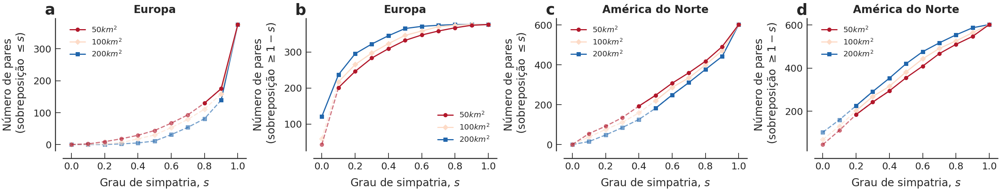

In [302]:
fig, ax = plt.subplots(1, 4, figsize=stdfigsize(ny=1, nx=4))

colors = palettable.colorbrewer.diverging.RdBu_11.mpl_colors
kwargs = dict(lw=3, markersize=10)

p = 0.3

europe_sympn_5050_less[europe_sympn_5050_less['perc'] >= p].plot('symp', 'n', ax=ax[0], marker='o', color=colors[1], **kwargs, zorder=3)
europe_sympn_100100_less[europe_sympn_100100_less['perc'] >= p] .plot('symp', 'n', ax=ax[0], marker='D', color=colors[4], **kwargs, zorder=2)
europe_sympn_200200_less[europe_sympn_200200_less['perc'] >= p].plot('symp', 'n', ax=ax[0], marker='s', color=colors[9], **kwargs, zorder=1)

europe_sympn_5050_less[europe_sympn_5050_less['perc'] <= p+0.2].plot('symp', 'n', ax=ax[0], marker='o', color=colors[1], **kwargs, zorder=3, alpha=0.6, style='--')
europe_sympn_100100_less[europe_sympn_100100_less['perc'] <= p+0.2] .plot('symp', 'n', ax=ax[0], marker='D', color=colors[4], **kwargs, zorder=2, alpha=0.6, style='--')
europe_sympn_200200_less[europe_sympn_200200_less['perc'] <= p+0.1].plot('symp', 'n', ax=ax[0], marker='s', color=colors[9], **kwargs, zorder=1, alpha=0.6, style='--')

europe_sympn_5050_great[europe_sympn_5050_great['perc'] >= p].plot('symp', 'n', ax=ax[1], marker='o', color=colors[1], **kwargs, zorder=3)
europe_sympn_100100_great[europe_sympn_100100_great['perc'] >= p].plot('symp', 'n', ax=ax[1], marker='D', color=colors[4], **kwargs, zorder=2)
europe_sympn_200200_great[europe_sympn_200200_great['perc'] >= p].plot('symp', 'n', ax=ax[1], marker='s', color=colors[9], **kwargs, zorder=1)

europe_sympn_5050_great[europe_sympn_5050_great['perc'] <= p+0.3].plot('symp', 'n', ax=ax[1], marker='o', color=colors[1], **kwargs, zorder=3, alpha=0.6, style='--')
europe_sympn_100100_great[europe_sympn_100100_great['perc'] <= p+0.3].plot('symp', 'n', ax=ax[1], marker='D', color=colors[4], **kwargs, zorder=2, alpha=0.6, style='--')
europe_sympn_200200_great[europe_sympn_200200_great['perc'] <= p+0.3].plot('symp', 'n', ax=ax[1], marker='s', color=colors[9], **kwargs, zorder=1, alpha=0.6, style='--')

north_america_sympn_5050_less[north_america_sympn_5050_less['perc'] >= p].plot('symp', 'n', ax=ax[2], marker='o', color=colors[1], **kwargs, zorder=3)
north_america_sympn_100100_less[north_america_sympn_100100_less['perc'] >= p].plot('symp', 'n', ax=ax[2], marker='D', color=colors[4], **kwargs, zorder=2)
north_america_sympn_200200_less[north_america_sympn_200200_less['perc'] >= p].plot('symp', 'n', ax=ax[2], marker='s', color=colors[9], **kwargs, zorder=1)

north_america_sympn_5050_less[north_america_sympn_5050_less['perc'] <= p+0.2].plot('symp', 'n', ax=ax[2], marker='o', color=colors[1], **kwargs, zorder=3, alpha=0.6, style='--')
north_america_sympn_100100_less[north_america_sympn_100100_less['perc'] <= p+0.2].plot('symp', 'n', ax=ax[2], marker='D', color=colors[4], **kwargs, zorder=2, alpha=0.6, style='--')
north_america_sympn_200200_less[north_america_sympn_200200_less['perc'] <= p+0.3].plot('symp', 'n', ax=ax[2], marker='s', color=colors[9], **kwargs, zorder=1, alpha=0.6, style='--')

north_america_sympn_5050_great[north_america_sympn_5050_great['perc'] >= p].plot('symp', 'n', ax=ax[3], marker='o', color=colors[1], **kwargs, zorder=3)
north_america_sympn_100100_great[north_america_sympn_100100_great['perc'] >= p].plot('symp', 'n', ax=ax[3], marker='D', color=colors[4], **kwargs, zorder=2)
north_america_sympn_200200_great[north_america_sympn_200200_great['perc'] >= p].plot('symp', 'n', ax=ax[3], marker='s', color=colors[9], **kwargs, zorder=1)

north_america_sympn_5050_great[north_america_sympn_5050_great['perc'] <= p+0.2].plot('symp', 'n', ax=ax[3], marker='o', color=colors[1], **kwargs, zorder=3, alpha=0.6, style='--')
north_america_sympn_100100_great[north_america_sympn_100100_great['perc'] <= p+0.2].plot('symp', 'n', ax=ax[3], marker='D', color=colors[4], **kwargs, zorder=2, alpha=0.6, style='--')
north_america_sympn_200200_great[north_america_sympn_200200_great['perc'] <= p+0.2].plot('symp', 'n', ax=ax[3], marker='s', color=colors[9], **kwargs, zorder=1, alpha=0.6, style='--')

c = 0
for ax in ax.flat:
    
    ax.set_title(['Europe', 'Europe', 'North America', 'North America'][c], weight='bold')
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.03), xycoords='axes fraction', fontsize=40, weight='bold')
    ax.set_xlabel('Degree of sympatry, $s$')
    ax.set_ylabel(['number of pairs\n (overlapping $\\leq s$)', 'number of pairs\n (overlapping $\\geq 1-s$)', 'number of pairs\n (overlapping $\\leq s$)', 'number of pairs\n (overlapping $\\geq 1-s$)'][c])
    ax.legend(['$50km^2$', '$100km^2$', '$200km^2$'])
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)

    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    
fig.tight_layout()
# fig.savefig('../figures/pairs_per_symp.pdf', bbox_inches='tight')
# fig.savefig('../figures/pairs_per_symp.png', bbox_inches='tight')

Europe has a great number of pairs with high degree of sympatry, as we can observe in Fig.Xa, where for a degree of $s \leq 0.8$ only 30\% of the pairs are found. 

In [110]:
def pearson(data):
    """
    Calculates the Pearson correlation coefficient.
    Parameters
    ----------
    data: two-columns numpy array
    ----------
    Returns Pearson.
    """
    data=data.transpose()
    pea=scipy.stats.pearsonr(data[0],data[1])
    return(pea)

def spearman(data):
    """
    Calculates the Pearson correlation coefficient.
    Parameters
    ----------
    data: two-columns numpy array
    ----------
    Returns Pearson.
    """
    data=data.transpose()
    pea=scipy.stats.spearmanr(data[0],data[1])
    return(pea)

In [25]:
a = np.zeros(10)
b = a + 1

df = pd.DataFrame(data=np.asarray([a, b]).T, columns=['a', 'b'])

In [35]:
list(df.loc[1,])

[0.0, 1.0]

In [93]:
arr = np.asarray([a, b]).T
[random.shuffle(a) for a in arr]
arr

array([[1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.]])

In [59]:
# df = north_america_overlay_5050
def spearman_sympatry(df, order, perc_filter=0.3):
    # columns to use
    cols = ['area1', 'area2']
    if order == 'greater':
        df_size = pd.DataFrame([df[df['sympatry'] >= 1-s].shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['size'])
        df_perc = pd.DataFrame([df[df['sympatry'] >= 1-s].shape[0]/df.shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['perc'])
        df_spea = pd.DataFrame([np.asarray(spearman(np.asarray(df[df['sympatry'] >= 1-s][cols].apply(np.log)))) for s in np.arange(0, 1.1, 0.1)], columns=['spearman', 'pvalue'], index=np.arange(0,110,10)/100).reset_index()
        df = pd.concat([df_spea, df_size, df_perc], axis=1).dropna()
        df = df[df['perc'] >= perc_filter]
    elif order == 'less':
        df_size = pd.DataFrame([df[df['sympatry'] <= s].shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['size'])
        df_perc = pd.DataFrame([df[df['sympatry'] <= s].shape[0]/df.shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['perc'])
        df_spea = pd.DataFrame([np.asarray(spearman(np.asarray(df[df['sympatry'] <= s][cols].apply(np.log)))) for s in np.arange(0, 1.1, 0.1)], columns=['spearman', 'pvalue'], index=np.arange(0,110,10)/100).reset_index()
        df = pd.concat([df_spea, df_size, df_perc], axis=1).dropna()
        df = df[df['perc'] >= perc_filter]
    else:
        raise ValueError('unknown order value: {}'.format(order))
        
    return df

In [180]:
overlap_features_5050_europe_common = overlap_features_5050_europe[(overlap_features_5050_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_europe_common = overlap_features_100100_europe[(overlap_features_100100_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_europe_common = overlap_features_200200_europe[(overlap_features_200200_europe['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_europe['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [181]:
overlap_features_5050_north_america_common = overlap_features_5050_north_america[(overlap_features_5050_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_north_america_common = overlap_features_100100_north_america[(overlap_features_100100_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_north_america_common = overlap_features_200200_north_america[(overlap_features_200200_north_america['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_north_america['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [182]:
overlap_features_5050_europe_weck4_common = overlap_features_5050_europe_weck4[(overlap_features_5050_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_europe_weck4_common = overlap_features_100100_europe_weck4[(overlap_features_100100_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_europe_weck4_common = overlap_features_200200_europe_weck4[(overlap_features_200200_europe_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_europe_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [183]:
overlap_features_5050_north_america_weck4_common = overlap_features_5050_north_america_weck4[(overlap_features_5050_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_5050_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_100100_north_america_weck4_common = overlap_features_100100_north_america_weck4[(overlap_features_100100_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_100100_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

overlap_features_200200_north_america_weck4_common = overlap_features_200200_north_america_weck4[(overlap_features_200200_north_america_weck4['sp1'].isin(common_sp_na_eu['species'])) & overlap_features_200200_north_america_weck4['sp2'].isin(common_sp_na_eu['species'])].reset_index(drop=True)

In [174]:
europe_overlay_5050_greater_sympatry_spearman   = spearman_sympatry(overlap_features_5050_europe, order='greater')
europe_overlay_100100_greater_sympatry_spearman = spearman_sympatry(overlap_features_100100_europe, order='greater')
europe_overlay_200200_greater_sympatry_spearman = spearman_sympatry(overlap_features_200200_europe, order='greater')

europe_overlay_5050_less_sympatry_spearman   = spearman_sympatry(overlap_features_5050_europe, order='less')
europe_overlay_100100_less_sympatry_spearman = spearman_sympatry(overlap_features_100100_europe, order='less')
europe_overlay_200200_less_sympatry_spearman = spearman_sympatry(overlap_features_200200_europe, order='less')

europe_overlay_5050_common_greater_sympatry_spearman   = spearman_sympatry(overlap_features_5050_europe_common, order='greater')
europe_overlay_100100_common_greater_sympatry_spearman = spearman_sympatry(overlap_features_100100_europe_common, order='greater')
europe_overlay_200200_common_greater_sympatry_spearman = spearman_sympatry(overlap_features_200200_europe_common, order='greater')

europe_overlay_5050_common_less_sympatry_spearman   = spearman_sympatry(overlap_features_5050_europe_common, order='less')
europe_overlay_100100_common_less_sympatry_spearman = spearman_sympatry(overlap_features_100100_europe_common, order='less')
europe_overlay_200200_common_less_sympatry_spearman = spearman_sympatry(overlap_features_200200_europe_common, order='less')

NameError: name 'spearman_sympatry' is not defined

In [69]:
north_america_overlay_5050_greater_sympatry_spearman   = spearman_sympatry(overlap_features_5050_north_america, order='greater')
north_america_overlay_100100_greater_sympatry_spearman = spearman_sympatry(overlap_features_100100_north_america, order='greater')
north_america_overlay_200200_greater_sympatry_spearman = spearman_sympatry(overlap_features_200200_north_america, order='greater')

north_america_overlay_5050_less_sympatry_spearman   = spearman_sympatry(overlap_features_5050_north_america, order='less')
north_america_overlay_100100_less_sympatry_spearman = spearman_sympatry(overlap_features_100100_north_america, order='less')
north_america_overlay_200200_less_sympatry_spearman = spearman_sympatry(overlap_features_200200_north_america, order='less')

north_america_overlay_5050_common_greater_sympatry_spearman   = spearman_sympatry(overlap_features_5050_north_america_common, order='greater')
north_america_overlay_100100_common_greater_sympatry_spearman = spearman_sympatry(overlap_features_100100_north_america_common, order='greater')
north_america_overlay_200200_common_greater_sympatry_spearman = spearman_sympatry(overlap_features_200200_north_america_common, order='greater')

north_america_overlay_5050_common_less_sympatry_spearman   = spearman_sympatry(overlap_features_5050_north_america_common, order='less')
north_america_overlay_100100_common_less_sympatry_spearman = spearman_sympatry(overlap_features_100100_north_america_common, order='less')
north_america_overlay_200200_common_less_sympatry_spearman = spearman_sympatry(overlap_features_200200_north_america_common, order='less')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3183: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3184: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1821: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2362: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


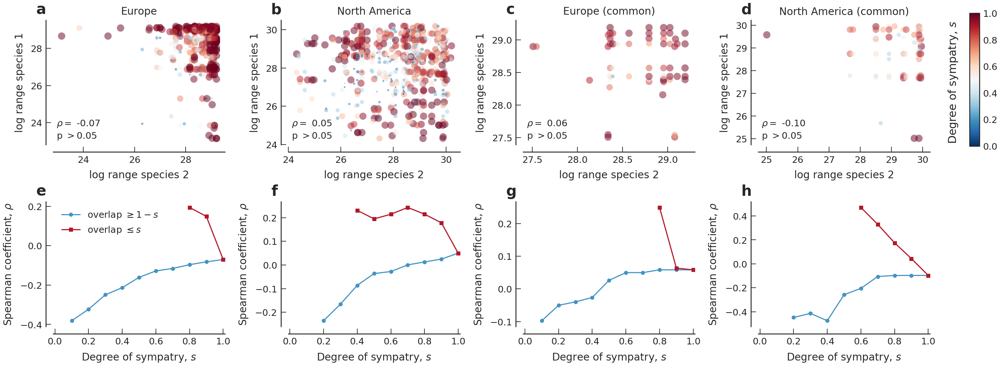

In [550]:
fig, ax = plt.subplots(2, 4, figsize=stdfigsize(ny=2, nx=4))

df_l  = [overlap_features_5050_europe, overlap_features_5050_north_america, overlap_features_5050_europe_common, overlap_features_5050_north_america_common]

df_sg = [europe_overlay_5050_greater_sympatry_spearman, north_america_overlay_5050_greater_sympatry_spearman, europe_overlay_5050_common_greater_sympatry_spearman, north_america_overlay_5050_common_greater_sympatry_spearman]

df_sl = [europe_overlay_5050_less_sympatry_spearman, north_america_overlay_5050_less_sympatry_spearman, europe_overlay_5050_common_less_sympatry_spearman, north_america_overlay_5050_common_less_sympatry_spearman]

kwargs = dict(lw=0, marker='o', alpha=0.5, legend=False)

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2], legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2], legend=False)


c = 0
for ax in ax.flat:
    if c < 4:
#         im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c]['sympatry']]
    
    
        df_l[c][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')
    
        ax.set_title(['Europe', 'North America', 'Europe (common)', 'North America (common)'][c])
        
        boot_spearman = bootstrap_function(np.asarray(df_l[c][['area1', 'area2']].apply(np.log)), spearman)
        ax.annotate('$\\rho=$ {:.2f}'.format(boot_spearman[0][0]), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
#         ax.annotate('CI 95%: {:.2f}-{:.2f}'.format(boot_spearman[1], boot_spearman[2]), xy=(0.02,0.10), xycoords='axes fraction', fontsize=20)
        ax.annotate('p $> 0.05$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.2f}'.format(df_l[c][['area_1', 'area_2']].apply(np.log).corr().loc['area_1', 'area_2'].round(3)),
#                    xy=(0.02,0.05), xycoords='axes fraction', fontsize=30)
        
        if c == 3:
            ax.annotate('Degree of sympatry, $s$', xy=(1.1, 0.92), xycoords='axes fraction', rotation=90, fontsize=30)
    
    else:
        df_sg[c-4].plot('index', 'spearman', ax=ax, **kwargs_sg)
        df_sl[c-4].plot('index', 'spearman', ax=ax, **kwargs_sl)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')
        
        ax.set_xlim([-0.01,1.01])
        
        if c == 4:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
    
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    
    
    c += 1
    


fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([1.01, 0.60, 0.01, 0.36])
fig.colorbar(im, cax=cbar_ax)
    
fig.tight_layout()
# fig.savefig('../figures/range_correlation_spearman.pdf', bbox_inches='tight')
# fig.savefig('../figures/range_correlation_spearman.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2362: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


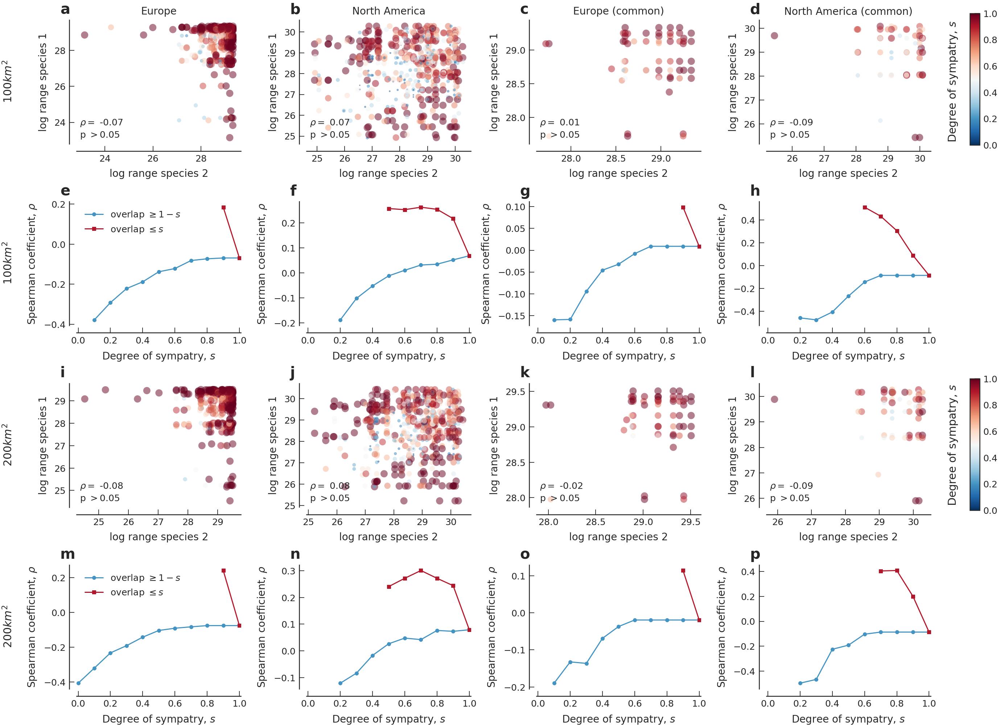

In [558]:
fig, axarr = plt.subplots(4, 4, figsize=stdfigsize(ny=4, nx=4))

# overlap_features_5050_europe
df_l = [overlap_features_100100_europe, overlap_features_100100_north_america, 
        overlap_features_100100_europe_common, overlap_features_100100_north_america_common,
        overlap_features_200200_europe, overlap_features_200200_north_america, 
        overlap_features_200200_europe_common, overlap_features_200200_north_america_common,]

df_sg = [
    europe_overlay_100100_greater_sympatry_spearman, north_america_overlay_100100_greater_sympatry_spearman,
    europe_overlay_100100_common_greater_sympatry_spearman, north_america_overlay_100100_common_greater_sympatry_spearman,
    europe_overlay_200200_greater_sympatry_spearman, north_america_overlay_200200_greater_sympatry_spearman,
    europe_overlay_200200_common_greater_sympatry_spearman, north_america_overlay_200200_common_greater_sympatry_spearman
        ]

df_sl = [
    europe_overlay_100100_less_sympatry_spearman, north_america_overlay_100100_less_sympatry_spearman,
    europe_overlay_100100_common_less_sympatry_spearman, north_america_overlay_100100_common_less_sympatry_spearman,
    europe_overlay_200200_less_sympatry_spearman, north_america_overlay_200200_less_sympatry_spearman,
    europe_overlay_200200_common_less_sympatry_spearman, north_america_overlay_200200_common_less_sympatry_spearman
        ]


kwargs = dict(lw=0, marker='o', alpha=0.5, legend=False)

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2], legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2], legend=False)

c = 0
for ax in axarr.flat:
    if c < 4:
    #     im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c]['sympatry']]

        df_l[c][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')

        boot_spearman = bootstrap_function(np.asarray(df_l[c][['area1', 'area2']].apply(np.log)), spearman)
        ax.annotate('$\\rho=$ {:.2f}'.format(boot_spearman[0][0]), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
#         ax.annotate('CI 95%: {:.2f}-{:.2f}'.format(boot_spearman[1], boot_spearman[2]), xy=(0.02,0.10), xycoords='axes fraction', fontsize=20)
        ax.annotate('p $> 0.05$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.2f}'.format(df_l[c][['area1', 'area2']].apply(np.log).corr().loc['area1', 'area2'].round(3)),
#                    xy=(0.02,0.05), xycoords='axes fraction', fontsize=30)
    
    elif c > 3 and c < 8:
        df_sg[c-4].plot('index', 'spearman', ax=ax, **kwargs_sg)
        df_sl[c-4].plot('index', 'spearman', ax=ax, **kwargs_sl)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')
        
        ax.set_xlim([-0.01,1.01])
        ax.set_xticks(np.arange(0,1.2,0.2))
#         ax.set_xticklabels(np.arange(0,1.2,0.2))
        
        if c == 4:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
    
    elif c > 7 and c < 12:
    #     im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c-4]['sympatry']]

        df_l[c-4][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c-4]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')

        boot_spearman = bootstrap_function(np.asarray(df_l[c-4][['area1', 'area2']].apply(np.log)), spearman)
        ax.annotate('$\\rho=$ {:.2f}'.format(boot_spearman[0][0]), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
#         ax.annotate('CI 95%: {:.2f}-{:.2f}'.format(boot_spearman[1], boot_spearman[2]), xy=(0.02,0.10), xycoords='axes fraction', fontsize=20)
        ax.annotate('p $> 0.05$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.2f}'.format(df_l[c-4][['area1', 'area2']].apply(np.log).corr().loc['area1', 'area2'].round(3)),
#                    xy=(0.02,0.05), xycoords='axes fraction', fontsize=30)
    
    elif c > 11 and c < 16:
        df_sg[c-8].plot('index', 'spearman', ax=ax, **kwargs_sg)
        df_sl[c-8].plot('index', 'spearman', ax=ax, **kwargs_sl)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')
        
        ax.set_xlim([-0.01,1.01])
        ax.set_xticks(np.arange(0,1.2,0.2))
        
        if c == 12:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
        
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 4:
        ax.set_title(['Europe', 'North America', 'Europe (common)', 'North America (common)'][c])
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    
[axarr[i,0].annotate(['$100km^2$', '$100km^2$', '$200km^2$',  '$200km^2$'][i], xy=(-0.45, 0.6), xycoords='axes fraction', rotation=90, fontsize=30, weight='bold') for i in range(4)]
[axarr[i,3].annotate('Degree of sympatry, $s$', xy=(1.1, 0.92), xycoords='axes fraction', rotation=90, fontsize=30) for i in [0,2]]

# im_1 = [axarr[0,i].imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap) for i in range(4)][3]
# im_2 = [axarr[2,i].imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap) for i in range(4)][3]

fig.subplots_adjust(right=0.8)
cbar_ax_1 = fig.add_axes([1.01, 0.8, 0.01, 0.18])
cbar_ax_2 = fig.add_axes([1.01, 0.3, 0.01, 0.18])
fig.colorbar(im_1, cax=cbar_ax_1)
fig.colorbar(im_2, cax=cbar_ax_2)
    
fig.tight_layout()
# fig.savefig('../figures/range_correlation_spearman_supl_mat.pdf', bbox_inches='tight')
# fig.savefig('../figures/range_correlation_spearman_supl_mat.png', bbox_inches='tight')

### Spearman coefficient with shuffling pairs
<a id="spearman-coefficient-with-shuffling-pairs"></a>
<a href="#summary">Summary</a>

Function remodeled to shuffle the pairs before calculate the correlation (Mouillot Spatial 2009).

In [151]:
# df = north_america_overlay_5050
def spearman_sympatry(df, order, perc_filter=0.3, resample=False, rep=1000, alpha=0.05):
    # columns to use
    cols = ['area1', 'area2']
    if order == 'greater':
        df_size = pd.DataFrame([df[df['sympatry'] >= 1-s].shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['size'])
        df_perc = pd.DataFrame([df[df['sympatry'] >= 1-s].shape[0]/df.shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['perc'])
        df_spea = pd.DataFrame([np.asarray(spearman(np.asarray(df[df['sympatry'] >= 1-s][cols].apply(np.log)))) for s in np.arange(0, 1.1, 0.1)], columns=['spearman', 'pvalue'], index=np.arange(0,110,10)/100).reset_index()
                
        # condition if one wants to resample each pair within the df
        if resample:
            # list to append the mean spearman coefficient and the confidence interval values
            stats_l = []
            # loop through the sympatry values to filter the df
            for s in np.arange(0, 1.1, 0.1):
                # create a temporary array with the values of area1 and area2
                arr_tmp = np.asarray(df[df['sympatry'] >= 1-s][cols].apply(np.log))
                # list to append the values of the spearman coefficient for the resampled df
                spear_l = []
                # loop to shuffle each pair
                for _ in range(rep):
                    # shuffling each pair
                    [np.random.shuffle(arr) for arr in arr_tmp]
                    # append the spearman coefficient to the previous created list
                    spear_l.append(spearman(arr_tmp)[0])

                # transform the spearman coefficients list into an array
                spear_arr = np.asarray(spear_l)

                # calculate the mean value of all spearman coefficients and the confidence interval [5, 95]
                stats_values = np.append(spear_arr.mean(), np.percentile(spear_arr, q=[100*alpha/2, 100*(1-alpha/2)]))
                
                # append the stats values to the stats list
                stats_l.append(stats_values)
            
            df_stats = pd.DataFrame(stats_l, columns=['spearman_mean', 'spearman_5CI', 'spearman_95CI'])
            
            df = pd.concat([df_spea, df_size, df_perc, df_stats], axis=1).dropna()
            df = df[df['perc'] >= perc_filter]
          
        else:
            
            df = pd.concat([df_spea, df_size, df_perc], axis=1).dropna()
            df = df[df['perc'] >= perc_filter]
        
    elif order == 'less':
        df_size = pd.DataFrame([df[df['sympatry'] <= s].shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['size'])
        df_perc = pd.DataFrame([df[df['sympatry'] <= s].shape[0]/df.shape[0] for s in np.arange(0, 1.1, 0.1)], columns=['perc'])
        df_spea = pd.DataFrame([np.asarray(spearman(np.asarray(df[df['sympatry'] <= s][cols].apply(np.log)))) for s in np.arange(0, 1.1, 0.1)], columns=['spearman', 'pvalue'], index=np.arange(0,110,10)/100).reset_index()
        
          # condition if one wants to resample each pair within the df
        if resample:
            # list to append the mean spearman coefficient and the confidence interval values
            stats_l = []
            # loop through the sympatry values to filter the df
            for s in np.arange(0, 1.1, 0.1):
                # create a temporary array with the values of area1 and area2
                arr_tmp = np.asarray(df[df['sympatry'] <= s][cols].apply(np.log))
                # list to append the values of the spearman coefficient for the resampled df
                spear_l = []
                # loop to shuffle each pair
                for _ in range(rep):
                    # shuffling each pair
                    [np.random.shuffle(arr) for arr in arr_tmp]
                    # append the spearman coefficient to the previous created list
                    spear_l.append(spearman(arr_tmp)[0])

                # transform the spearman coefficients list into an array
                spear_arr = np.asarray(spear_l)

                # calculate the mean value of all spearman coefficients and the confidence interval [5, 95]
                stats_values = np.append(spear_arr.mean(), np.percentile(spear_arr, q=[100*alpha/2, 100*(1-alpha/2)]))
                
                # append the stats values to the stats list
                stats_l.append(stats_values)
            
            df_stats = pd.DataFrame(stats_l, columns=['spearman_mean', 'spearman_5CI', 'spearman_95CI'])
            
            df = pd.concat([df_spea, df_size, df_perc, df_stats], axis=1).dropna()
            df = df[df['perc'] >= perc_filter]
            
        else:
            df = pd.concat([df_spea, df_size, df_perc], axis=1).dropna()
            df = df[df['perc'] >= perc_filter]
            
    else:
        raise ValueError('unknown order value: {}'.format(order))
        
    return df

In [500]:
l = [i for i in range(10)]
l[::-1]

[9, 8, 7, 6, 5, 4, 3, 2, 1, 0]

In [531]:
b = a.copy()
for i in np.random.random_integers(0,50,25):
    b[i] = a[i][::-1]

/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: This function is deprecated. Please call randint(0, 50 + 1) instead
  


array([ 0,  2,  5,  6,  8,  9, 10, 11, 12, 14, 16, 19, 21, 22, 24, 25, 27,
       28, 31, 32, 35, 37, 38, 39, 40, 43, 44, 45, 47, 48, 49])

In [4]:
def random_pairs_ex(a_df, n=20):
    
    random_index = sorted(set([random.choice(a_df.index) for _ in range(random.choice(range(50)))]))
    
    # shuffled
    shu = a_df.iloc[random_index]
    shu = shu[['a2', 'a1']]
    shu.columns = ['a1', 'a2']

    # original
    ori = a_df.iloc[np.setdiff1d(a_df.index, random_index)]
    
    # concatenated: shuffled + original remains
    con = pd.concat([shu, ori])
    
    return shu, ori, con

In [5]:
def random_corr_data(lim=[0,100], n=1000, corr=0.5):
    xx = np.array(lim)
    yy = np.array(lim)
    means = [xx.mean(), yy.mean()]  
    stds = [xx.std() / 3, yy.std() / 3]
    corr = corr         # correlation
    covs = [[stds[0]**2          , stds[0]*stds[1]*corr], 
            [stds[0]*stds[1]*corr,           stds[1]**2]] 

    m = np.random.multivariate_normal(means, covs, n).T
    
    return m

In [27]:
def boot_mean(l):
    return l.sum()/l.shape[0]

rho_boot = bootstrap_function(rho_df['spearman'], boot_mean)

In [31]:
pd.DataFrame(data=[[i, *rho_boot] for i in range(rho_df.shape[0])], columns=['rep', 'mean', 'CI_5', 'CI_95'])

,rep,mean,CI_5,CI_95
0,0,0.071043,0.069342,0.072697
1,1,0.071043,0.069342,0.072697
2,2,0.071043,0.069342,0.072697
3,3,0.071043,0.069342,0.072697
4,4,0.071043,0.069342,0.072697
...,...,...,...,...
95,95,0.071043,0.069342,0.072697
96,96,0.071043,0.069342,0.072697
97,97,0.071043,0.069342,0.072697
98,98,0.071043,0.069342,0.072697


/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: This function is deprecated. Please call randint(0, 100 + 1) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/dsvieira/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: This function is deprecated. Please call randint(0, 100 + 1) instead
  after removing the cwd from sys.path.
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


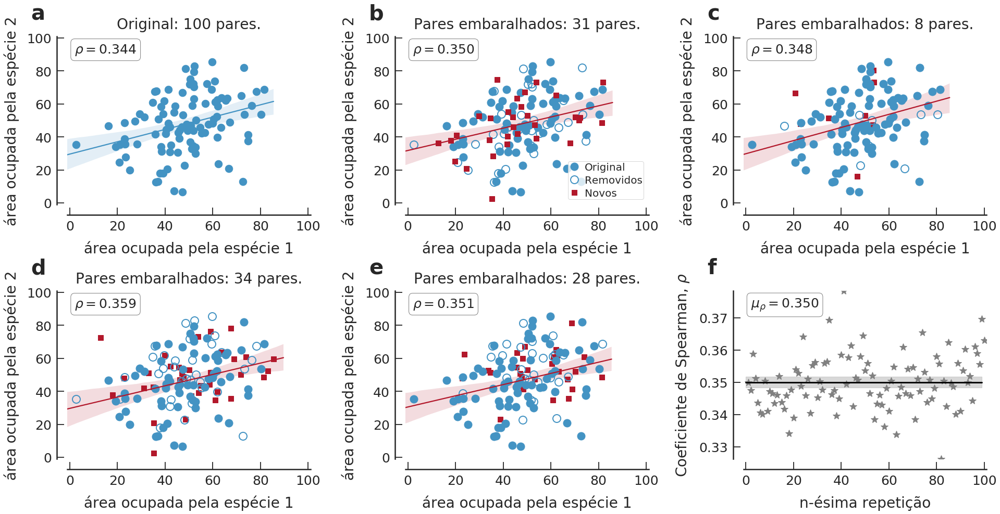

In [65]:
fig, ax = plt.subplots(2, 3, figsize=stdfigsize(nx=3, ny=2))

a1 = np.random.random_integers(0, 100, 50)
a2 = np.random.random_integers(0, 100, 50)

a = np.asarray([a1, a2]).T
# a_df = pd.DataFrame(data=a, columns=['a1', 'a2'])
a_df = pd.DataFrame(data=random_corr_data(n=100, corr=0.3).T, columns=['a1', 'a2'])

# shuffle_1 = random_pairs_ex(a_df)
# shuffle_2 = random_pairs_ex(a_df)
# shuffle_3 = random_pairs_ex(a_df)
# shuffle_4 = random_pairs_ex(a_df)

# shuffle_l = [shuffle_1, shuffle_2, shuffle_3, shuffle_4]

shuffle_l = [random_pairs_ex(a_df) for _ in range(100)]

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors

kwargs_a = dict(lw=0, marker='o', markersize=15, color=color_s[2])

kwargs_rem = dict(legend=False, lw=0, marker='o', markersize=15, markeredgecolor=color_s[2], markeredgewidth=2, markerfacecolor='None')
kwargs_ori = dict(legend=False, lw=0, marker='o', markersize=15, color=color_s[2])
kwargs_shu = dict(legend=False, lw=0, marker='s', markersize=10, color=color_s[-2])

# kwargs_rem = dict(legend=False, lw=0, marker='o', markersize=15, markeredgecolor='k', markeredgewidth=2, markerfacecolor='None')
# kwargs_ori = dict(legend=False, lw=0, marker='o', markersize=15, color='k')
# kwargs_shu = dict(legend=False, lw=0, marker='s', markersize=10, color='gray')


# ax[0,0].plot(*a.T, **kwargs_a)
sns.regplot(x='a1', y='a2', data=a_df, ax=ax[0,0], line_kws=dict(color=color_s[2]), scatter_kws=dict(s=210, color=color_s[2], alpha=1.0))
# sns.regplot(x='a1', y='a2', data=a_df, ax=ax[0,0], line_kws=dict(color=color_s[2]), scatter_kws=dict(s=210, color='k'))

shuffle_l[0][1].plot('a1', 'a2', ax=ax[0,1], **kwargs_ori)
shuffle_l[0][0].plot('a2', 'a1', ax=ax[0,1], **kwargs_rem)
shuffle_l[0][0].plot('a1', 'a2', ax=ax[0,1], **kwargs_shu)
sns.regplot(x='a1', y='a2', data=shuffle_l[0][2], ax=ax[0,1], line_kws=dict(color=color_s[-2]), scatter_kws=dict(s=0, color=color_s[-2]))

shuffle_l[1][0].plot('a1', 'a2', ax=ax[0,2], **kwargs_shu)
shuffle_l[1][1].plot('a1', 'a2', ax=ax[0,2], **kwargs_ori)
shuffle_l[1][0].plot('a2', 'a1', ax=ax[0,2], **kwargs_rem)
sns.regplot(x='a1', y='a2', data=shuffle_l[1][2], ax=ax[0,2], line_kws=dict(color=color_s[-2]), scatter_kws=dict(s=0, color=color_s[-2]))

shuffle_l[2][0].plot('a1', 'a2', ax=ax[1,0], **kwargs_shu)
shuffle_l[2][1].plot('a1', 'a2', ax=ax[1,0], **kwargs_ori)
shuffle_l[2][0].plot('a2', 'a1', ax=ax[1,0], **kwargs_rem)
sns.regplot(x='a1', y='a2', data=shuffle_l[2][2], ax=ax[1,0], line_kws=dict(color=color_s[-2]), scatter_kws=dict(s=0, color=color_s[-2]))

shuffle_l[3][0].plot('a1', 'a2', ax=ax[1,1], **kwargs_shu)
shuffle_l[3][1].plot('a1', 'a2', ax=ax[1,1], **kwargs_ori)
shuffle_l[3][0].plot('a2', 'a1', ax=ax[1,1], **kwargs_rem)
sns.regplot(x='a1', y='a2', data=shuffle_l[3][2], ax=ax[1,1], line_kws=dict(color=color_s[-2]), scatter_kws=dict(s=0, color=color_s[-2]))

rho_df = pd.DataFrame([[c+1, scipy.stats.spearmanr(shuffle_l[c][2]['a1'], shuffle_l[c][2]['a2'])[0]] for c in range(len(shuffle_l))], columns=['rep', 'spearman'])
rho_boot = bootstrap_function(rho_df['spearman'], boot_mean)
rho_mean = pd.DataFrame(data=[[i, *rho_boot] for i in range(rho_df.shape[0])], columns=['rep', 'mean', 'CI_5', 'CI_95'])

ax[1,2].plot('rep', 'spearman', data=rho_df, lw=0, marker='*', color='gray', markersize=15)
ax[1,2].plot('rep', 'mean', data=rho_mean, lw=3, color='k')
ax[1,2].fill_between(x='rep', y1='CI_5', y2='CI_95', data=rho_mean, color='gray', alpha=0.3)

# sns.regplot(x='rep', y='spearman', data=rho_df, ax=ax[1,2], marker='*', line_kws=dict(color=color_s[2]), scatter_kws=dict(s=250, color=color_s[2], alpha=0.8))
# sns.regplot(x='rep', y='spearman', data=rho_df, ax=ax[1,2], marker='*', line_kws=dict(color=color_s[2]), scatter_kws=dict(s=250, color='gray'))

ax[1,2].set_ylim(rho_df['spearman'].min(), rho_df['spearman'].max())

for c, ax in enumerate(fig.get_axes()):
    
    ax.set_xlim([-1,101])
    ax.annotate(string.ascii_lowercase[c], xy=(-0.15, 1.1), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 5:
        ax.set_xlabel('área ocupada pela espécie 1')
        ax.set_ylabel('área ocupada pela espécie 2')
        ax.set_ylim([-1,101])
    else:
        ax.set_xlabel('n-ésima repetição')
        ax.set_ylabel(r'Coeficiente de Spearman, $\rho$')
    
    if c == 0:
        ax.set_title('Original: {} pares.'.format(a_df.shape[0]))
    elif c > 0 and c < 5:
        ax.set_title('Pares embaralhados: {} pares.'.format(shuffle_l[c-1][0].shape[0]))
        
        if c == 1:
            ax.legend(['Original', 'Removidos', 'Novos'], frameon=True, loc='lower right', borderpad=0.1, handlelength=1.0, handletextpad=0.5, labelspacing=0.3)
    
    if c == 0:
        ax.annotate(r'$\rho =${:.3f}'.format(scipy.stats.spearmanr(a_df['a1'], a_df['a2'])[0]), xy=(0.03, 0.9), xycoords='axes fraction', fontsize=25, bbox=dict(boxstyle="round", fc="w", alpha=0.5))
    elif c > 0 and c < 5:
        ax.annotate(r'$\rho =${:.3f}'.format(scipy.stats.spearmanr(shuffle_l[c-1][2]['a1'], shuffle_l[c-1][2]['a2'])[0]), xy=(0.03, 0.9), xycoords='axes fraction', fontsize=25,bbox=dict(boxstyle="round", fc="w", alpha=0.5))
    else:
        ax.annotate(r'$\mu_{{\rho}}=${:.3f}'.format(rho_df['spearman'].mean()), xy=(0.03, 0.9), xycoords='axes fraction', fontsize=25,bbox=dict(boxstyle="round", fc="w", alpha=0.5))
        
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')

    
    
fig.tight_layout(pad=3)
# fig.savefig('figures/range_corr_pair_shuffle_expl_pt.pdf', bbox_inches='tight')

In [185]:
europe_overlay_5050_greater_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_europe, order='greater', resample=True)
europe_overlay_100100_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_europe, order='greater', resample=True)
europe_overlay_200200_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_europe, order='greater', resample=True)

europe_overlay_5050_less_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_europe, order='less', resample=True)
europe_overlay_100100_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_europe, order='less', resample=True)
europe_overlay_200200_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_europe, order='less', resample=True)

europe_overlay_5050_common_greater_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_europe_common, order='greater', resample=True)
europe_overlay_100100_common_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_europe_common, order='greater', resample=True)
europe_overlay_200200_common_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_europe_common, order='greater', resample=True)

europe_overlay_5050_common_less_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_europe_common, order='less', resample=True)
europe_overlay_100100_common_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_europe_common, order='less', resample=True)
europe_overlay_200200_common_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_europe_common, order='less', resample=True)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:4291: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3183: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3184: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1821: RuntimeWarning: invalid value en

In [186]:
north_america_overlay_5050_greater_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_north_america, order='greater', resample=True)
north_america_overlay_100100_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_north_america, order='greater', resample=True)
north_america_overlay_200200_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_north_america, order='greater', resample=True)

north_america_overlay_5050_less_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_north_america, order='less', resample=True)
north_america_overlay_100100_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_north_america, order='less', resample=True)
north_america_overlay_200200_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_north_america, order='less', resample=True)

north_america_overlay_5050_common_greater_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_north_america_common, order='greater', resample=True)
north_america_overlay_100100_common_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_north_america_common, order='greater', resample=True)
north_america_overlay_200200_common_greater_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_north_america_common, order='greater', resample=True)

north_america_overlay_5050_common_less_sympatry_spearman_shuffle   = spearman_sympatry(overlap_features_5050_north_america_common, order='less', resample=True)
north_america_overlay_100100_common_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_100100_north_america_common, order='less', resample=True)
north_america_overlay_200200_common_less_sympatry_spearman_shuffle = spearman_sympatry(overlap_features_200200_north_america_common, order='less', resample=True)

/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:4291: RuntimeWarning: Invalid value encountered in percentile
  interpolation=interpolation)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3183: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3184: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
/home/dsvieira/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1821: RuntimeWarning: invalid value en

In [253]:
df_sg[0][df_sg[0]['index'] == 1.0].iloc[0]

index              1.000000
spearman          -0.070331
pvalue             0.173542
size             376.000000
perc               1.000000
spearman_mean     -0.081675
spearman_5CI      -0.086409
spearman_95CI     -0.075144
Name: 10, dtype: float64

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2022: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


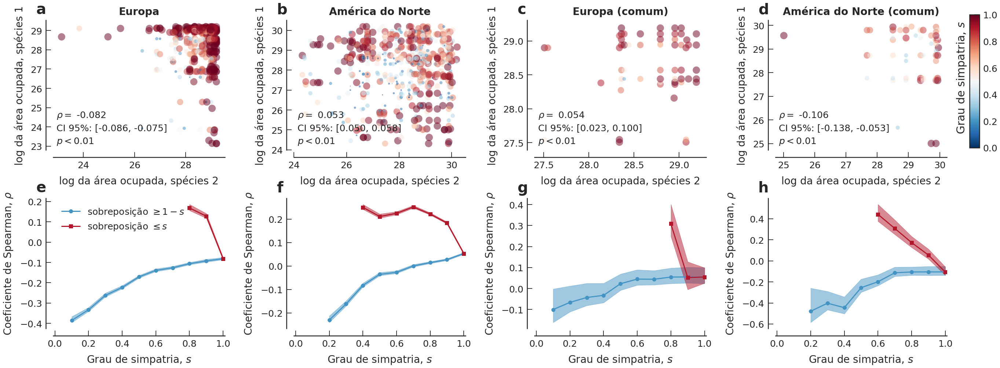

In [294]:
fig, ax = plt.subplots(2, 4, figsize=stdfigsize(ny=2, nx=4))

df_l  = [overlap_features_5050_europe, overlap_features_5050_north_america, overlap_features_5050_europe_common, overlap_features_5050_north_america_common]

df_sg = [europe_overlay_5050_greater_sympatry_spearman_shuffle, north_america_overlay_5050_greater_sympatry_spearman_shuffle, europe_overlay_5050_common_greater_sympatry_spearman_shuffle, north_america_overlay_5050_common_greater_sympatry_spearman_shuffle]

df_sl = [europe_overlay_5050_less_sympatry_spearman_shuffle, north_america_overlay_5050_less_sympatry_spearman_shuffle, europe_overlay_5050_common_less_sympatry_spearman_shuffle, north_america_overlay_5050_common_less_sympatry_spearman_shuffle]

kwargs = dict(lw=0, marker='o', alpha=0.5, legend=False)

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2], legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2], legend=False)

kwargs_sg_bar = dict(lw=3, marker='o', markersize=10, color=color_s[2])
kwargs_sl_bar = dict(lw=3, marker='s', markersize=10, color=color_s[-2])

c = 0
for ax in ax.flat:
    if c < 4:
#         im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c]['sympatry']]
    
    
        df_l[c][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')
    
        ax.set_title(['Europe', 'North America', 'Europe (common)', 'North America (common)'][c])


        
        df_stats = df_sg[c][df_sg[c]['index'] == 1.0].iloc[0]
    
        ax.annotate('$\\rho=$ {:.3f}'.format(df_stats['spearman_mean']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
        ax.annotate('CI 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
#         ax.annotate('IC 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25) # PT
        ax.annotate('$p < 0.01$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.3f}$_{{[{:.3f}, {:.3f}]95\%}}$'.format(df_stats['spearman_mean'],df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
        
        if c == 3:
            ax.annotate('Degree of sympatry, $s$', xy=(1.05, 0.92), xycoords='axes fraction', rotation=90, fontsize=30)
    
    else:
        df_sg[c-4].plot('index', 'spearman_mean', ax=ax, **kwargs_sg)
        df_sl[c-4].plot('index', 'spearman_mean', ax=ax, **kwargs_sl)
        
#         ax.errorbar(x=df_sg[c-4]['index'], y=df_sg[c-4]['spearman_mean'], yerr=np.asarray(df_sg[c-4][['spearman_5CI', 'spearman_95CI']]).T, **kwargs_sg_bar)
#         ax.errorbar(x=df_sl[c-4]['index'], y=df_sl[c-4]['spearman_mean'], yerr=np.asarray(df_sl[c-4][['spearman_5CI', 'spearman_95CI']]).T, **kwargs_sl_bar)
        
        ax.fill_between(x=df_sg[c-4]['index'], y1=df_sg[c-4]['spearman_5CI'], y2=df_sg[c-4]['spearman_95CI'], color=color_s[2] , alpha=0.5)
        ax.fill_between(x=df_sl[c-4]['index'], y1=df_sl[c-4]['spearman_5CI'], y2=df_sl[c-4]['spearman_95CI'], color=color_s[-2], alpha=0.5)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')
        
        ax.set_xlim([-0.01,1.01])
        
        if c == 4:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
    
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    
    
    c += 1
    


fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([1.01, 0.60, 0.01, 0.36])
fig.colorbar(im, cax=cbar_ax)
    
fig.tight_layout()
# fig.savefig('../figures/range_correlation_spearman_band.pdf', bbox_inches='tight')
# fig.savefig('../figures/range_correlation_spearman_band.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/figure.py:2022: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "
/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


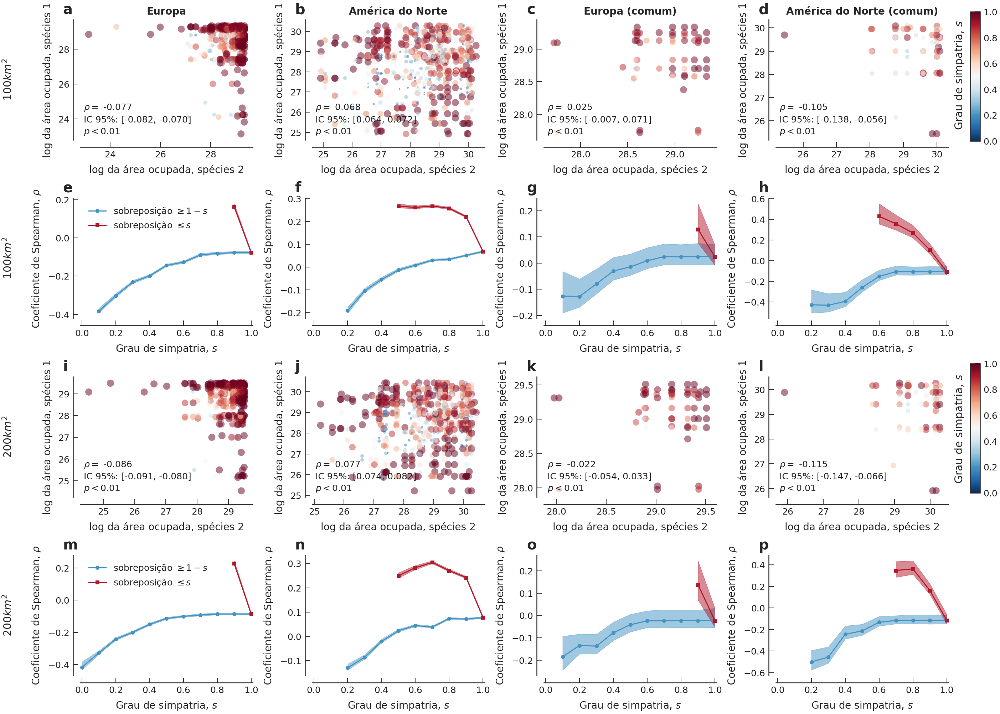

In [293]:
fig, axarr = plt.subplots(4, 4, figsize=stdfigsize(ny=4, nx=4))

# overlap_features_5050_europe
df_l = [overlap_features_100100_europe, overlap_features_100100_north_america, 
        overlap_features_100100_europe_common, overlap_features_100100_north_america_common,
        overlap_features_200200_europe, overlap_features_200200_north_america, 
        overlap_features_200200_europe_common, overlap_features_200200_north_america_common,]

df_sg = [
    europe_overlay_100100_greater_sympatry_spearman_shuffle, north_america_overlay_100100_greater_sympatry_spearman_shuffle,
    europe_overlay_100100_common_greater_sympatry_spearman_shuffle, north_america_overlay_100100_common_greater_sympatry_spearman_shuffle,
    europe_overlay_200200_greater_sympatry_spearman_shuffle, north_america_overlay_200200_greater_sympatry_spearman_shuffle,
    europe_overlay_200200_common_greater_sympatry_spearman_shuffle, north_america_overlay_200200_common_greater_sympatry_spearman_shuffle
        ]

df_sl = [
    europe_overlay_100100_less_sympatry_spearman_shuffle, north_america_overlay_100100_less_sympatry_spearman_shuffle,
    europe_overlay_100100_common_less_sympatry_spearman_shuffle, north_america_overlay_100100_common_less_sympatry_spearman_shuffle,
    europe_overlay_200200_less_sympatry_spearman_shuffle, north_america_overlay_200200_less_sympatry_spearman_shuffle,
    europe_overlay_200200_common_less_sympatry_spearman_shuffle, north_america_overlay_200200_common_less_sympatry_spearman_shuffle
        ]


kwargs = dict(lw=0, marker='o', alpha=0.5, legend=False)

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2], legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2], legend=False)

c = 0
for ax in axarr.flat:
    if c < 4:
    #     im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c]['sympatry']]

        df_l[c][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')


        df_stats = df_sg[c][df_sg[c]['index'] == 1.0].iloc[0]
    
        ax.annotate('$\\rho=$ {:.3f}'.format(df_stats['spearman_mean']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
#         ax.annotate('CI 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
        ax.annotate('IC 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25) # PT
        ax.annotate('$p < 0.01$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.3f}$_{{[{:.3f}, {:.3f}]95\%}}$'.format(df_stats['spearman_mean'],df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
    
    elif c > 3 and c < 8:
        df_sg[c-4].plot('index', 'spearman_mean', ax=ax, **kwargs_sg)
        df_sl[c-4].plot('index', 'spearman_mean', ax=ax, **kwargs_sl)
        
        ax.fill_between(x=df_sg[c-4]['index'], y1=df_sg[c-4]['spearman_5CI'], y2=df_sg[c-4]['spearman_95CI'], color=color_s[2] , alpha=0.5)
        ax.fill_between(x=df_sl[c-4]['index'], y1=df_sl[c-4]['spearman_5CI'], y2=df_sl[c-4]['spearman_95CI'], color=color_s[-2], alpha=0.5)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')

        
        ax.set_xlim([-0.01,1.01])
        ax.set_xticks(np.arange(0,1.2,0.2))
#         ax.set_xticklabels(np.arange(0,1.2,0.2))
        
        if c == 4:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
    
    elif c > 7 and c < 12:
    #     im = ax.imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap)
        colors=[palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap(i) for i in df_l[c-4]['sympatry']]

        df_l[c-4][['area1', 'area2']].apply(np.log).plot.scatter('area1', 'area2', ax=ax, **kwargs, s=df_l[c-4]['sympatry']*400, c=colors)
#         ax.set_yscale('log')
#         ax.set_xscale('log')

        ax.set_ylabel('log range species 1')
        ax.set_xlabel('log range species 2')

        df_stats = df_sg[c-4][df_sg[c-4]['index'] == 1.0].iloc[0]
    
        ax.annotate('$\\rho=$ {:.3f}'.format(df_stats['spearman_mean']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
#         ax.annotate('CI 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25)
        ax.annotate('IC 95%: [{:.3f}, {:.3f}]'.format(df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.15), xycoords='axes fraction', fontsize=25) # PT
        ax.annotate('$p < 0.01$', xy=(0.02,0.05), xycoords='axes fraction', fontsize=25)
#         ax.annotate('$\\rho=$ {:.3f}$_{{[{:.3f}, {:.3f}]95\%}}$'.format(df_stats['spearman_mean'],df_stats['spearman_5CI'], df_stats['spearman_95CI']), xy=(0.02,0.25), xycoords='axes fraction', fontsize=25)
    
    elif c > 11 and c < 16:
        df_sg[c-8].plot('index', 'spearman_mean', ax=ax, **kwargs_sg)
        df_sl[c-8].plot('index', 'spearman_mean', ax=ax, **kwargs_sl)
        
        ax.fill_between(x=df_sg[c-8]['index'], y1=df_sg[c-8]['spearman_5CI'], y2=df_sg[c-8]['spearman_95CI'], color=color_s[2] , alpha=0.5)
        ax.fill_between(x=df_sl[c-8]['index'], y1=df_sl[c-8]['spearman_5CI'], y2=df_sl[c-8]['spearman_95CI'], color=color_s[-2], alpha=0.5)
        
        ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_ylabel('Spearman coefficient, $\\rho$')
        
        ax.set_xlim([-0.01,1.01])
        ax.set_xticks(np.arange(0,1.2,0.2))
        
        if c == 12:
            ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=25, frameon=False)
        
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 4:
        ax.set_title(['Europe', 'North America', 'Europe (common)', 'North America (common)'][c], weight='bold')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    
[axarr[i,0].annotate(['$100km^2$', '$100km^2$', '$200km^2$',  '$200km^2$'][i], xy=(-0.45, 0.6), xycoords='axes fraction', rotation=90, fontsize=30, weight='bold') for i in range(4)]
[axarr[i,3].annotate('Degree of sympatry, $s$', xy=(1.02, 0.92), xycoords='axes fraction', rotation=90, fontsize=30) for i in [0,2]]

# im_1 = [axarr[0,i].imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap) for i in range(4)][3]
# im_2 = [axarr[2,i].imshow(np.random.random((10,10)), vmin=0, vmax=1, cmap=palettable.colorbrewer.diverging.RdBu_11_r.mpl_colormap) for i in range(4)][3]

fig.subplots_adjust(right=0.8)
cbar_ax_1 = fig.add_axes([1.01, 0.80, 0.01, 0.18])
cbar_ax_2 = fig.add_axes([1.01, 0.31, 0.01, 0.18])
fig.colorbar(im_1, cax=cbar_ax_1)
fig.colorbar(im_2, cax=cbar_ax_2)
    
fig.tight_layout()
# fig.savefig('../figures/range_correlation_spearman_supl_mat_band.pdf', bbox_inches='tight')
# fig.savefig('../figures/range_correlation_spearman_supl_mat_band.png', bbox_inches='tight')

### Comparison of the environmental distributions between different spatial scale for the same pairs
<a id="comparison-of-the-environmental-distributions"></a>
<a href="#summary">Summary</a>

In [183]:
def transform_list(l):
    dist = pd.eval(l.replace('nan', '-2')) 
    dist = dist[dist != -2].astype(np.float)
    
    return pd.DataFrame(dist, columns=['dist'])

In [346]:
common_pairs = pd.DataFrame([pair for pair in combinations(common_sp_na_eu['species'], 2)], columns=['sp1', 'sp2'])

#### Europe
<a id="europe-comparison-of-the-environmental"></a>
<a href="#summary">Summary</a>

##### All
<a id="europe-comparison-of-the-environmental-all"></a>
<a href="#summary">Summary</a>

In [86]:
overlap_features_5050_europe.columns[3:8]

Index(['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'lgm'], dtype='object')

In [488]:
pvalues_dict_50100_europe = {}
for feature in overlap_features_5050_europe.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_europe[feature].iloc[i])['dist'], transform_list(overlap_features_100100_europe[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_europe.shape[0])]
    pvalues_dict_50100_europe[feature] = tmp_pvalues

In [489]:
pvalues_dict_50200_europe = {}
for feature in overlap_features_5050_europe.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_europe[feature].iloc[i])['dist'], transform_list(overlap_features_200200_europe[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_europe.shape[0])]
    pvalues_dict_50200_europe[feature] = tmp_pvalues

In [490]:
pvalues_dict_100200_europe = {}
for feature in overlap_features_100100_europe.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_100100_europe[feature].iloc[i])['dist'], transform_list(overlap_features_200200_europe[feature].iloc[i])['dist'])[1] for i in range(overlap_features_100100_europe.shape[0])]
    pvalues_dict_100200_europe[feature] = tmp_pvalues

In [491]:
water_50_100_pvalue_europe_weck4 = []

for i in range(overlap_features_5050_europe_weck4.shape[0]):
    dist1 = transform_list(overlap_features_5050_europe_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_100100_europe_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_100_pvalue_europe_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [492]:
water_50_200_pvalue_europe_weck4 = []

for i in range(overlap_features_5050_europe_weck4.shape[0]):
    dist1 = transform_list(overlap_features_5050_europe_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_europe_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_200_pvalue_europe_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [493]:
water_100_200_pvalue_europe_weck4 = []

for i in range(overlap_features_5050_europe_weck4.shape[0]):
    dist1 = transform_list(overlap_features_100100_europe_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_europe_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_100_200_pvalue_europe_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [494]:
pvalues_50100_europe = pd.concat([pd.DataFrame(pvalues_dict_50100_europe), pd.DataFrame(water_50_100_pvalue_europe_weck4, columns=['water'])], axis=1)

In [495]:
pvalues_50200_europe = pd.concat([pd.DataFrame(pvalues_dict_50200_europe), pd.DataFrame(water_50_200_pvalue_europe_weck4, columns=['water'])], axis=1)

In [496]:
pvalues_100200_europe = pd.concat([pd.DataFrame(pvalues_dict_100200_europe), pd.DataFrame(water_100_200_pvalue_europe_weck4, columns=['water'])], axis=1)

##### Common
<a id="europe-comparison-of-the-environmental-common"></a>
<a href="#summary">Summary</a>

In [25]:
overlap_features_5050_europe_common = pd.concat([overlap_features_5050_europe[(overlap_features_5050_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_europe_common = pd.concat([overlap_features_100100_europe[(overlap_features_100100_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_europe_common = pd.concat([overlap_features_200200_europe[(overlap_features_200200_europe['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_europe['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [26]:
overlap_features_5050_europe_weck4_common = pd.concat([overlap_features_5050_europe_weck4[(overlap_features_5050_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_europe_weck4_common = pd.concat([overlap_features_100100_europe_weck4[(overlap_features_100100_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_europe_weck4_common = pd.concat([overlap_features_200200_europe_weck4[(overlap_features_200200_europe_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_europe_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [499]:
pvalues_dict_50100_europe_common = {}
for feature in overlap_features_5050_europe_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_europe_common[feature].iloc[i])['dist'], transform_list(overlap_features_100100_europe_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_europe_common.shape[0])]
    pvalues_dict_50100_europe_common[feature] = tmp_pvalues

In [500]:
pvalues_dict_50200_europe_common = {}
for feature in overlap_features_5050_europe_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_europe_common[feature].iloc[i])['dist'], transform_list(overlap_features_200200_europe_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_europe_common.shape[0])]
    pvalues_dict_50200_europe_common[feature] = tmp_pvalues

In [501]:
pvalues_dict_100200_europe_common = {}
for feature in overlap_features_100100_europe_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_100100_europe_common[feature].iloc[i])['dist'], transform_list(overlap_features_200200_europe_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_100100_europe_common.shape[0])]
    pvalues_dict_100200_europe_common[feature] = tmp_pvalues

In [502]:
water_50_100_pvalue_europe_weck4_common = []

for i in range(overlap_features_5050_europe_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_5050_europe_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_100100_europe_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_100_pvalue_europe_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [503]:
water_50_200_pvalue_europe_weck4_common = []

for i in range(overlap_features_5050_europe_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_5050_europe_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_europe_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_200_pvalue_europe_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [504]:
water_100_200_pvalue_europe_weck4_common = []

for i in range(overlap_features_5050_europe_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_100100_europe_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_europe_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_100_200_pvalue_europe_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [505]:
pvalues_50100_europe_common = pd.concat([pd.DataFrame(pvalues_dict_50100_europe_common), pd.DataFrame(water_50_100_pvalue_europe_weck4_common, columns=['water'])], axis=1)

In [506]:
pvalues_50200_europe_common = pd.concat([pd.DataFrame(pvalues_dict_50200_europe_common), pd.DataFrame(water_50_200_pvalue_europe_weck4_common, columns=['water'])], axis=1)

In [507]:
pvalues_100200_europe_common = pd.concat([pd.DataFrame(pvalues_dict_100200_europe_common), pd.DataFrame(water_100_200_pvalue_europe_weck4_common, columns=['water'])], axis=1)

#### North America
<a id="north-america-comparison-of-the-environmental"></a>
<a href="#summary">Summary</a>

##### All
<a id="north-america-comparison-of-the-environmental-all"></a>
<a href="#summary">Summary</a>

In [508]:
pvalues_dict_50100_north_america = {}
for feature in overlap_features_5050_north_america.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_north_america[feature].iloc[i])['dist'], transform_list(overlap_features_100100_north_america[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_north_america.shape[0])]
    pvalues_dict_50100_north_america[feature] = tmp_pvalues

In [509]:
pvalues_dict_50200_north_america = {}
for feature in overlap_features_5050_north_america.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_north_america[feature].iloc[i])['dist'], transform_list(overlap_features_200200_north_america[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_north_america.shape[0])]
    pvalues_dict_50200_north_america[feature] = tmp_pvalues

In [510]:
pvalues_dict_100200_north_america = {}
for feature in overlap_features_100100_north_america.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_100100_north_america[feature].iloc[i])['dist'], transform_list(overlap_features_200200_north_america[feature].iloc[i])['dist'])[1] for i in range(overlap_features_100100_north_america.shape[0])]
    pvalues_dict_100200_north_america[feature] = tmp_pvalues

In [511]:
water_50_100_pvalue_north_america_weck4 = []

for i in range(overlap_features_5050_north_america_weck4.shape[0]):
    dist1 = transform_list(overlap_features_5050_north_america_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_100100_north_america_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_100_pvalue_north_america_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [512]:
water_50_200_pvalue_north_america_weck4 = []

for i in range(overlap_features_5050_north_america_weck4.shape[0]):
    dist1 = transform_list(overlap_features_5050_north_america_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_north_america_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_200_pvalue_north_america_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [513]:
water_100_200_pvalue_north_america_weck4 = []

for i in range(overlap_features_5050_north_america_weck4.shape[0]):
    dist1 = transform_list(overlap_features_100100_north_america_weck4['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_north_america_weck4['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_100_200_pvalue_north_america_weck4.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [514]:
pvalues_50100_north_america = pd.concat([pd.DataFrame(pvalues_dict_50100_north_america), pd.DataFrame(water_50_100_pvalue_north_america_weck4, columns=['water'])], axis=1)

In [515]:
pvalues_50200_north_america = pd.concat([pd.DataFrame(pvalues_dict_50200_north_america), pd.DataFrame(water_50_200_pvalue_north_america_weck4, columns=['water'])], axis=1)

In [516]:
pvalues_100200_north_america = pd.concat([pd.DataFrame(pvalues_dict_100200_north_america), pd.DataFrame(water_100_200_pvalue_north_america_weck4, columns=['water'])], axis=1)

##### Common
<a id="north-america-comparison-of-the-environmental-common"></a>
<a href="#summary">Summary</a>

In [93]:
overlap_features_5050_north_america_common = pd.concat([overlap_features_5050_north_america[(overlap_features_5050_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_north_america_common = pd.concat([overlap_features_100100_north_america[(overlap_features_100100_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_north_america_common = pd.concat([overlap_features_200200_north_america[(overlap_features_200200_north_america['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_north_america['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [94]:
overlap_features_5050_north_america_weck4_common = pd.concat([overlap_features_5050_north_america_weck4[(overlap_features_5050_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_5050_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_100100_north_america_weck4_common = pd.concat([overlap_features_100100_north_america_weck4[(overlap_features_100100_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_100100_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

overlap_features_200200_north_america_weck4_common = pd.concat([overlap_features_200200_north_america_weck4[(overlap_features_200200_north_america_weck4['sp1'] == common_pairs.iloc[i]['sp1']) & (overlap_features_200200_north_america_weck4['sp2'] == common_pairs.iloc[i]['sp2'])] for i in range(common_pairs.shape[0])]).reset_index(drop=True)

In [95]:
pvalues_dict_50100_north_america_common = {}
for feature in overlap_features_5050_north_america_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_north_america_common[feature].iloc[i])['dist'], transform_list(overlap_features_100100_north_america_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_north_america_common.shape[0])]
    pvalues_dict_50100_north_america_common[feature] = tmp_pvalues

KeyboardInterrupt: 

In [520]:
pvalues_dict_50200_north_america_common = {}
for feature in overlap_features_5050_north_america_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_5050_north_america_common[feature].iloc[i])['dist'], transform_list(overlap_features_200200_north_america_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_5050_north_america_common.shape[0])]
    pvalues_dict_50200_north_america_common[feature] = tmp_pvalues

In [521]:
pvalues_dict_100200_north_america_common = {}
for feature in overlap_features_100100_north_america_common.columns[3:8]:
    tmp_pvalues = [scipy.stats.ks_2samp(transform_list(overlap_features_100100_north_america_common[feature].iloc[i])['dist'], transform_list(overlap_features_200200_north_america_common[feature].iloc[i])['dist'])[1] for i in range(overlap_features_100100_north_america_common.shape[0])]
    pvalues_dict_100200_north_america_common[feature] = tmp_pvalues

In [522]:
water_50_100_pvalue_north_america_weck4_common = []

for i in range(overlap_features_5050_north_america_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_5050_north_america_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_100100_north_america_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_100_pvalue_north_america_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [523]:
water_50_200_pvalue_north_america_weck4_common = []

for i in range(overlap_features_5050_north_america_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_5050_north_america_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_north_america_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_50_200_pvalue_north_america_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [524]:
water_100_200_pvalue_north_america_weck4_common = []

for i in range(overlap_features_5050_north_america_weck4_common.shape[0]):
    dist1 = transform_list(overlap_features_100100_north_america_weck4_common['water'].iloc[i])['dist']
    dist2 = transform_list(overlap_features_200200_north_america_weck4_common['water'].iloc[i])['dist']
    
    dist1 = dist1/dist1.mean()
    dist2 = dist2/dist2.mean()
    
    water_100_200_pvalue_north_america_weck4_common.append(scipy.stats.ks_2samp(dist1, dist2)[1])

In [525]:
pvalues_50100_north_america_common = pd.concat([pd.DataFrame(pvalues_dict_50100_north_america_common), pd.DataFrame(water_50_100_pvalue_north_america_weck4_common, columns=['water'])], axis=1)

In [526]:
pvalues_50200_north_america_common = pd.concat([pd.DataFrame(pvalues_dict_50200_north_america_common), pd.DataFrame(water_50_200_pvalue_north_america_weck4_common, columns=['water'])], axis=1)

In [527]:
pvalues_100200_north_america_common = pd.concat([pd.DataFrame(pvalues_dict_100200_north_america_common), pd.DataFrame(water_100_200_pvalue_north_america_weck4_common, columns=['water'])], axis=1)

### Comparison of the environmental distributions between sister species
<a id="comparison-of-the-environmental-distributions-sister"></a>
<a href="#summary">Summary</a>

In [355]:
def transform_list(l):
    dist = pd.eval(l.replace('nan', '-2')) 
    dist = dist[dist != -2].astype(np.float)
    
    return pd.DataFrame(dist, columns=['dist'])

def dist_comparison(df_1, df_2, df_3):
    
    df_tmp_lf = []
    
    for feature in ['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'water', 'lgm']:
    
        df_tmp_l = []
        
        for i in range(df_1.shape[0]):
            sp1, sp2 = list(df_1.loc[i, ['sp1', 'sp2']])
            dist_1 = np.asarray(transform_list(df_1[(df_1['sp1'] == sp1) & (df_1['sp2'] == sp2)][feature].iloc[0])['dist'])
            dist_2 = np.asarray(transform_list(df_2[(df_2['sp1'] == sp1) & (df_2['sp2'] == sp2)][feature].iloc[0])['dist'])
            dist_3 = np.asarray(transform_list(df_3[(df_3['sp1'] == sp1) & (df_3['sp2'] == sp2)][feature].iloc[0])['dist'])
            
            if feature == 'water':
                dist_1 = dist_1/dist_1.mean()
                dist_2 = dist_2/dist_2.mean()
                dist_3 = dist_3/dist_3.mean()
            
            stats_50100, pvalue_50100   = scipy.stats.ks_2samp(dist_1, dist_2)
            stats_50200, pvalue_50200   = scipy.stats.ks_2samp(dist_1, dist_3)
            stats_100200, pvalue_100200 = scipy.stats.ks_2samp(dist_2, dist_3)

            df_tmp_l.append(pd.DataFrame({'sp1': [sp1], 'sp2': [sp2], 
                                   '50100_pvalue_{}'.format(feature): [pvalue_50100],
                                   '50100_stats_{}'.format(feature): [stats_50100],
                                   '50200_pvalue_{}'.format(feature): [pvalue_50200],
                                   '50200_stats_{}'.format(feature): [stats_50200],
                                   '100200_pvalue_{}'.format(feature): [pvalue_100200],
                                   '100200_stats_{}'.format(feature): [stats_100200]}))

        df_tmp = pd.concat(df_tmp_l).reset_index(drop=True)
        df_tmp_lf.append(df_tmp)
    
    df_tmp = pd.concat(df_tmp_lf, axis=1).reset_index(drop=True).T.drop_duplicates().T
        
    return df_tmp

In [356]:
overlap_features_5050_europe_ok = overlap_features_5050_europe_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_5050_europe, on=['sp1', 'sp2'])

overlap_features_100100_europe_ok = overlap_features_100100_europe_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_100100_europe, on=['sp1', 'sp2'])

overlap_features_200200_europe_ok = overlap_features_200200_europe_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_200200_europe, on=['sp1', 'sp2'])

overlap_features_5050_europe_common_ok = overlap_features_5050_europe_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_5050_europe_common, on=['sp1', 'sp2'])

overlap_features_100100_europe_common_ok = overlap_features_100100_europe_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_100100_europe_common, on=['sp1', 'sp2'])

overlap_features_200200_europe_common_ok = overlap_features_200200_europe_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_200200_europe_common, on=['sp1', 'sp2'])

In [357]:
overlap_features_5050_north_america_ok = overlap_features_5050_north_america_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_5050_north_america, on=['sp1', 'sp2'])

overlap_features_100100_north_america_ok = overlap_features_100100_north_america_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_100100_north_america, on=['sp1', 'sp2'])

overlap_features_200200_north_america_ok = overlap_features_200200_north_america_weck4[['sp1', 'sp2', 'water']].merge(overlap_features_200200_north_america, on=['sp1', 'sp2'])

overlap_features_5050_north_america_common_ok = overlap_features_5050_north_america_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_5050_north_america_common, on=['sp1', 'sp2'])

overlap_features_100100_north_america_common_ok = overlap_features_100100_north_america_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_100100_north_america_common, on=['sp1', 'sp2'])

overlap_features_200200_north_america_common_ok = overlap_features_200200_north_america_weck4_common[['sp1', 'sp2', 'water']].merge(overlap_features_200200_north_america_common, on=['sp1', 'sp2'])

In [358]:
features_comp_europe = dist_comparison(overlap_features_5050_europe_ok, overlap_features_100100_europe_ok, overlap_features_200200_europe_ok)
features_comp_europe_common = dist_comparison(overlap_features_5050_europe_common_ok, overlap_features_100100_europe_common_ok, overlap_features_200200_europe_common_ok)

In [359]:
features_comp_north_america = dist_comparison(overlap_features_5050_north_america_ok, overlap_features_100100_north_america_ok, overlap_features_200200_north_america_ok)
features_comp_north_america_common = dist_comparison(overlap_features_5050_north_america_common_ok, overlap_features_100100_north_america_common_ok, overlap_features_200200_north_america_common_ok)

In [188]:
# df = overlap_features_5050_europe_ok

def comp_env_dist_sister(df, symp=False, method='ks'):

    df_tmp_l = []
    features = ['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'water', 'lgm']

    for genus in df['genus'].unique():

        for feature in features:
#                   
            dists = df[df['genus'] == genus][feature]        
            dists = [np.asarray(transform_list(l)['dist']) for l in dists]
            symps = df[df['genus'] == genus]['sympatry']
            
            scombs = [comb for comb in combinations(symps, 2)]
            symp_1 = [symp[0] for symp in scombs]
            symp_2 = [symp[1] for symp in scombs]
            dcombs = [comb for comb in combinations(dists, 2)]
            
            if method == 'ks':
                pvalues = [scipy.stats.ks_2samp(comb[0], comb[1])[1] for comb in dcombs]
            elif method == 'wilcoxon':
                pvalues = [scipy.stats.ranksums(comb[0], comb[1])[1] for comb in dcombs]
            
            pv_df = pd.DataFrame(pvalues)
            total_pairs = pv_df.shape[0]
            
            perc_001_df = pv_df[pv_df >= 0.01].dropna()
            perc_005_df = pv_df[pv_df >= 0.05].dropna()
            
            if perc_001_df.shape[0] > 0:
                perc_001 = perc_001_df.shape[0]/pv_df.shape[0]
                n_pairs_001 = perc_001_df.shape[0]
            else:
                perc_001 = 0
                n_pairs_001 = 0
                
            if perc_005_df.shape[0] > 0:
                perc_005 = perc_005_df.shape[0]/pv_df.shape[0]
                n_pairs_005 = perc_005_df.shape[0]
            else:
                perc_005 = 0
                n_pairs_005 = 0
            
            if symp == False:
                df_tmp = pd.DataFrame({'genus': genus, 'feature': feature, 'pvalues': [pvalues], 'total_pairs': total_pairs, 'n_pairs_001': n_pairs_001, 'n_pairs_005': n_pairs_005, 'perc_001': perc_001, 'perc_005': perc_005})
            
            elif symp == True:
                df_tmp = pd.DataFrame({'genus': [genus]*len(pvalues), 'feature': [feature]*len(pvalues), 'pvalues': pvalues, 'symp_1': symp_1, 'symp_2': symp_2})
                
            df_tmp_l.append(df_tmp)
            
    return pd.concat(df_tmp_l).reset_index(drop=True)

In [360]:
# df = overlap_features_5050_europe_ok

# this consider the p-value with the Bonferroni correction
def comp_env_dist_sister(df, symp=False, method='ks'):

    df_tmp_l = []
    features = ['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'water', 'lgm']

    for genus in df['genus'].unique():

        for feature in features:
#                   
            dists = df[df['genus'] == genus][feature]        
            dists = [np.asarray(transform_list(l)['dist']) for l in dists]
            symps = df[df['genus'] == genus]['sympatry']
            
            scombs = [comb for comb in combinations(symps, 2)]
            symp_1 = [symp[0] for symp in scombs]
            symp_2 = [symp[1] for symp in scombs]
            dcombs = [comb for comb in combinations(dists, 2)]
            
            if method == 'ks':
                pvalues = [scipy.stats.ks_2samp(comb[0], comb[1])[1] for comb in dcombs]
            elif method == 'wilcoxon':
                pvalues = [scipy.stats.ranksums(comb[0], comb[1])[1] for comb in dcombs]
            
            
            pv_df = pd.DataFrame(pvalues)
            total_pairs = pv_df.shape[0]
            
            perc_001_df = pv_df[pv_df >= 0.01].dropna()
            perc_005_df = pv_df[pv_df >= 0.05].dropna()
            
            # bonferroni
            if total_pairs > 1:
                perc_001_bf_df = pv_df[pv_df >= (0.01/(total_pairs-1))]
                perc_005_bf_df = pv_df[pv_df >= (0.05/(total_pairs-1))]
            else:
                perc_001_bf_df = pv_df[pv_df >= 0.01]
                perc_005_bf_df = pv_df[pv_df >= 0.05]
            
            if perc_001_df.shape[0] > 0:
                perc_001 = perc_001_df.shape[0]/pv_df.shape[0]
                n_pairs_001 = perc_001_df.shape[0]
            else:
                perc_001 = 0
                n_pairs_001 = 0
                
            if perc_005_df.shape[0] > 0:
                perc_005 = perc_005_df.shape[0]/pv_df.shape[0]
                n_pairs_005 = perc_005_df.shape[0]
            else:
                perc_005 = 0
                n_pairs_005 = 0
            
            # bonferroni
            if perc_001_bf_df.shape[0] > 0:
                perc_001_bf = perc_001_bf_df.shape[0]/pv_df.shape[0]
                n_pairs_001_bf = perc_001_bf_df.shape[0]
            else:
                perc_001_bf = 0
                n_pairs_001_bf = 0
                
            if perc_005_bf_df.shape[0] > 0:
                perc_005_bf = perc_005_bf_df.shape[0]/pv_df.shape[0]
                n_pairs_005_bf = perc_005_bf_df.shape[0]
            else:
                perc_005_bf = 0
                n_pairs_005_bf = 0
            
            if symp == False:
                df_tmp = pd.DataFrame({'genus': genus, 'feature': feature, 'pvalues': [pvalues], 'total_pairs': total_pairs, 'n_pairs_001': n_pairs_001, 'n_pairs_005': n_pairs_005, 'perc_001': perc_001, 'perc_005': perc_005, 'n_pairs_001_bf': n_pairs_001_bf, 'n_pairs_005_bf': n_pairs_005_bf, 'perc_001_bf': perc_001_bf, 'perc_005_bf': perc_005_bf})
            
            elif symp == True:
                df_tmp = pd.DataFrame({'genus': [genus]*len(pvalues), 'feature': [feature]*len(pvalues), 'pvalues': pvalues, 'symp_1': symp_1, 'symp_2': symp_2})
                
            df_tmp_l.append(df_tmp)
            
    return pd.concat(df_tmp_l).reset_index(drop=True)

In [361]:
comp_env_dist_sister_5050_europe        = comp_env_dist_sister(overlap_features_5050_europe_ok)
comp_env_dist_sister_5050_europe_common = comp_env_dist_sister(overlap_features_5050_europe_common_ok)

comp_env_dist_sister_100100_europe        = comp_env_dist_sister(overlap_features_100100_europe_ok)
comp_env_dist_sister_100100_europe_common = comp_env_dist_sister(overlap_features_100100_europe_common_ok)

comp_env_dist_sister_200200_europe        = comp_env_dist_sister(overlap_features_200200_europe_ok)
comp_env_dist_sister_200200_europe_common = comp_env_dist_sister(overlap_features_200200_europe_common_ok)

In [362]:
comp_env_dist_sister_5050_europe

,feature,genus,n_pairs_001,n_pairs_001_bf,n_pairs_005,n_pairs_005_bf,perc_001,perc_001_bf,perc_005,perc_005_bf,pvalues,total_pairs
0,mean_temp,Alisma,1,6,1,6,0.166667,1.0,0.166667,1.0,"[1.4232563385055913e-05, 0.8986671588373192, 3...",6
1,mean_prec,Alisma,3,6,2,6,0.500000,1.0,0.333333,1.0,"[0.2033911399986462, 0.7953694474160453, 4.852...",6
2,mean_vtemp,Alisma,4,6,3,6,0.666667,1.0,0.500000,1.0,"[0.03523793529522201, 0.00020606555343438189, ...",6
3,alkalinity,Alisma,3,6,3,6,0.500000,1.0,0.500000,1.0,"[0.8138418378039582, 0.743845070323885, 1.2781...",6
4,water,Alisma,3,6,3,6,0.500000,1.0,0.500000,1.0,"[0.3389518409710852, 0.234048084052765, 2.8188...",6
...,...,...,...,...,...,...,...,...,...,...,...,...
163,mean_prec,Veronica,3,3,1,3,1.000000,1.0,0.333333,1.0,"[0.0399699219211373, 0.01914158277280751, 0.99...",3
164,mean_vtemp,Veronica,1,3,1,3,0.333333,1.0,0.333333,1.0,"[2.1801951474479668e-40, 6.932123506560879e-42...",3
165,alkalinity,Veronica,3,3,1,3,1.000000,1.0,0.333333,1.0,"[0.015751159430277682, 0.017688522450822763, 0...",3
166,water,Veronica,1,3,1,3,0.333333,1.0,0.333333,1.0,"[1.1766765919634464e-08, 2.8544036727427838e-0...",3


In [363]:
comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == 'water'][['total_pairs', 'n_pairs_001', 'n_pairs_005', 'n_pairs_001_bf', 'n_pairs_005_bf']].sum()

total_pairs       16876
n_pairs_001        7117
n_pairs_005        5489
n_pairs_001_bf    16876
n_pairs_005_bf    16876
dtype: int64

In [38]:
comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == features[0]]

,feature,genus,n_pairs_001,n_pairs_001_bf,n_pairs_005,n_pairs_005_bf,perc_001,perc_001_bf,perc_005,perc_005_bf,pvalues,total_pairs
0,mean_temp,Alisma,1,6,1,6,0.166667,1.0,0.166667,1.0,"[1.4232563385055913e-05, 0.8986671588373192, 3...",6
6,mean_temp,Callitriche,33,190,24,190,0.173684,1.0,0.126316,1.0,"[0.007518205529608018, 2.5282241181875557e-07,...",190
12,mean_temp,Carex,25,210,20,210,0.119048,1.0,0.095238,1.0,"[1.2791197363805757e-85, 1.2100381977554044e-5...",210
18,mean_temp,Ceratophyllum,8,10,8,10,0.800000,1.0,0.800000,1.0,"[0.6900588451713706, 0.17202395906802742, 1.0,...",10
24,mean_temp,Elatine,3,15,2,15,0.200000,1.0,0.133333,1.0,"[0.09237696200495456, 0.24252713495333258, 0.0...",15
...,...,...,...,...,...,...,...,...,...,...,...,...
138,mean_temp,Schoenoplectus,0,0,0,0,0.000000,0.0,0.000000,0.0,[],0
144,mean_temp,Sparganium,37,210,31,210,0.176190,1.0,0.147619,1.0,"[0.00035311093873396785, 9.679894025369509e-23...",210
150,mean_temp,Typha,0,0,0,0,0.000000,0.0,0.000000,0.0,[],0
156,mean_temp,Utricularia,2,15,1,15,0.133333,1.0,0.066667,1.0,"[2.610410633680686e-10, 1.9306278947972213e-17...",15


In [192]:
comp_env_dist_sister_5050_europe_wcx        = comp_env_dist_sister(overlap_features_5050_europe_ok, method='wilcoxon')
comp_env_dist_sister_5050_europe_wcx_common = comp_env_dist_sister(overlap_features_5050_europe_common_ok, method='wilcoxon')

comp_env_dist_sister_100100_europe_wcx        = comp_env_dist_sister(overlap_features_100100_europe_ok, method='wilcoxon')
comp_env_dist_sister_100100_europe_wcx_common = comp_env_dist_sister(overlap_features_100100_europe_common_ok, method='wilcoxon')

comp_env_dist_sister_200200_europe_wcx        = comp_env_dist_sister(overlap_features_200200_europe_ok, method='wilcoxon')
comp_env_dist_sister_200200_europe_wcx_common = comp_env_dist_sister(overlap_features_200200_europe_common_ok, method='wilcoxon')

In [193]:
comp_env_dist_sister_5050_europe_wcx[comp_env_dist_sister_5050_europe_wcx['feature'] == 'water'][['total_pairs', 'n_pairs_001', 'n_pairs_005', 'n_pairs_001_bf', 'n_pairs_005_bf']].sum()

total_pairs       16876
n_pairs_001        8239
n_pairs_005        6726
n_pairs_001_bf    16876
n_pairs_005_bf    16876
dtype: int64

In [364]:
comp_env_dist_sister_5050_north_america        = comp_env_dist_sister(overlap_features_5050_north_america_ok)
comp_env_dist_sister_5050_north_america_common = comp_env_dist_sister(overlap_features_5050_north_america_common_ok)

comp_env_dist_sister_100100_north_america        = comp_env_dist_sister(overlap_features_100100_north_america_ok)
comp_env_dist_sister_100100_north_america_common = comp_env_dist_sister(overlap_features_100100_north_america_common_ok)

comp_env_dist_sister_200200_north_america        = comp_env_dist_sister(overlap_features_200200_north_america_ok)
comp_env_dist_sister_200200_north_america_common = comp_env_dist_sister(overlap_features_200200_north_america_common_ok)

In [365]:
comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == 'water'][['total_pairs', 'n_pairs_001', 'n_pairs_005', 'n_pairs_001_bf', 'n_pairs_005_bf']].sum()

total_pairs       28809
n_pairs_001       12460
n_pairs_005        9415
n_pairs_001_bf    28809
n_pairs_005_bf    28809
dtype: int64

In [196]:
comp_env_dist_sister_5050_north_america_wcx        = comp_env_dist_sister(overlap_features_5050_north_america_ok, method='wilcoxon')
comp_env_dist_sister_5050_north_america_wcx_common = comp_env_dist_sister(overlap_features_5050_north_america_common_ok, method='wilcoxon')

comp_env_dist_sister_100100_north_america_wcx        = comp_env_dist_sister(overlap_features_100100_north_america_ok, method='wilcoxon')
comp_env_dist_sister_100100_north_america_wcx_common = comp_env_dist_sister(overlap_features_100100_north_america_common_ok, method='wilcoxon')

comp_env_dist_sister_200200_north_america_wcx        = comp_env_dist_sister(overlap_features_200200_north_america_ok, method='wilcoxon')
comp_env_dist_sister_200200_north_america_wcx_common = comp_env_dist_sister(overlap_features_200200_north_america_common_ok, method='wilcoxon')

In [197]:
comp_env_dist_sister_5050_north_america_wcx[comp_env_dist_sister_5050_north_america_wcx['feature'] == 'water'][['total_pairs', 'n_pairs_001', 'n_pairs_005', 'n_pairs_001_bf', 'n_pairs_005_bf']].sum()

total_pairs       28809
n_pairs_001       12796
n_pairs_005       10193
n_pairs_001_bf    28809
n_pairs_005_bf    28809
dtype: int64

In [200]:
num_comp_env_pv_001_5050_europe = [comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_europe = [comp_env_dist_sister_100100_europe[comp_env_dist_sister_100100_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_europe = [comp_env_dist_sister_200200_europe[comp_env_dist_sister_200200_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_europe = [comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_europe = [comp_env_dist_sister_100100_europe[comp_env_dist_sister_100100_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_europe = [comp_env_dist_sister_200200_europe[comp_env_dist_sister_200200_europe['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [202]:
num_comp_env_pv_001_5050_europe_common = [comp_env_dist_sister_5050_europe_common[comp_env_dist_sister_5050_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_europe_common = [comp_env_dist_sister_100100_europe_common[comp_env_dist_sister_100100_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_europe_common = [comp_env_dist_sister_200200_europe_common[comp_env_dist_sister_200200_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_europe_common = [comp_env_dist_sister_5050_europe_common[comp_env_dist_sister_5050_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_europe_common = [comp_env_dist_sister_100100_europe_common[comp_env_dist_sister_100100_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_europe_common = [comp_env_dist_sister_200200_europe_common[comp_env_dist_sister_200200_europe_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [203]:
num_comp_env_pv_001_5050_north_america = [comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_north_america = [comp_env_dist_sister_100100_north_america[comp_env_dist_sister_100100_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_north_america = [comp_env_dist_sister_200200_north_america[comp_env_dist_sister_200200_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_north_america = [comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_north_america = [comp_env_dist_sister_100100_north_america[comp_env_dist_sister_100100_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_north_america = [comp_env_dist_sister_200200_north_america[comp_env_dist_sister_200200_north_america['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [204]:
num_comp_env_pv_001_5050_north_america_common = [comp_env_dist_sister_5050_north_america_common[comp_env_dist_sister_5050_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_north_america_common = [comp_env_dist_sister_100100_north_america_common[comp_env_dist_sister_100100_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_north_america_common = [comp_env_dist_sister_200200_north_america_common[comp_env_dist_sister_200200_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_north_america_common = [comp_env_dist_sister_5050_north_america_common[comp_env_dist_sister_5050_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_north_america_common = [comp_env_dist_sister_100100_north_america_common[comp_env_dist_sister_100100_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_north_america_common = [comp_env_dist_sister_200200_north_america_common[comp_env_dist_sister_200200_north_america_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [205]:
num_comp_env_pv_001_5050_europe_wcx = [comp_env_dist_sister_5050_europe_wcx[comp_env_dist_sister_5050_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_europe_wcx = [comp_env_dist_sister_100100_europe_wcx[comp_env_dist_sister_100100_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_europe_wcx = [comp_env_dist_sister_200200_europe_wcx[comp_env_dist_sister_200200_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_europe_wcx = [comp_env_dist_sister_5050_europe_wcx[comp_env_dist_sister_5050_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_europe_wcx = [comp_env_dist_sister_100100_europe_wcx[comp_env_dist_sister_100100_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_europe_wcx = [comp_env_dist_sister_200200_europe_wcx[comp_env_dist_sister_200200_europe_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [206]:
num_comp_env_pv_001_5050_europe_wcx_common = [comp_env_dist_sister_5050_europe_wcx_common[comp_env_dist_sister_5050_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_europe_wcx_common = [comp_env_dist_sister_100100_europe_wcx_common[comp_env_dist_sister_100100_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_europe_wcx_common = [comp_env_dist_sister_200200_europe_wcx_common[comp_env_dist_sister_200200_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_europe_wcx_common = [comp_env_dist_sister_5050_europe_wcx_common[comp_env_dist_sister_5050_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_europe_wcx_common = [comp_env_dist_sister_100100_europe_wcx_common[comp_env_dist_sister_100100_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_europe_wcx_common = [comp_env_dist_sister_200200_europe_wcx_common[comp_env_dist_sister_200200_europe_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [207]:
num_comp_env_pv_001_5050_north_america_wcx = [comp_env_dist_sister_5050_north_america_wcx[comp_env_dist_sister_5050_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_north_america_wcx = [comp_env_dist_sister_100100_north_america_wcx[comp_env_dist_sister_100100_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_north_america_wcx = [comp_env_dist_sister_200200_north_america_wcx[comp_env_dist_sister_200200_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_north_america_wcx = [comp_env_dist_sister_5050_north_america_wcx[comp_env_dist_sister_5050_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_north_america_wcx = [comp_env_dist_sister_100100_north_america_wcx[comp_env_dist_sister_100100_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_north_america_wcx = [comp_env_dist_sister_200200_north_america_wcx[comp_env_dist_sister_200200_north_america_wcx['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

In [208]:
num_comp_env_pv_001_5050_north_america_wcx_common = [comp_env_dist_sister_5050_north_america_wcx_common[comp_env_dist_sister_5050_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_100100_north_america_wcx_common = [comp_env_dist_sister_100100_north_america_wcx_common[comp_env_dist_sister_100100_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_001_200200_north_america_wcx_common = [comp_env_dist_sister_200200_north_america_wcx_common[comp_env_dist_sister_200200_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_001'] for feature in features]

num_comp_env_pv_005_5050_north_america_wcx_common = [comp_env_dist_sister_5050_north_america_wcx_common[comp_env_dist_sister_5050_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_100100_north_america_wcx_common = [comp_env_dist_sister_100100_north_america_wcx_common[comp_env_dist_sister_100100_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

num_comp_env_pv_005_200200_north_america_wcx_common = [comp_env_dist_sister_200200_north_america_wcx_common[comp_env_dist_sister_200200_north_america_wcx_common['feature'] == feature][['total_pairs', 'n_pairs_001', 'n_pairs_005']].sum()['n_pairs_005'] for feature in features]

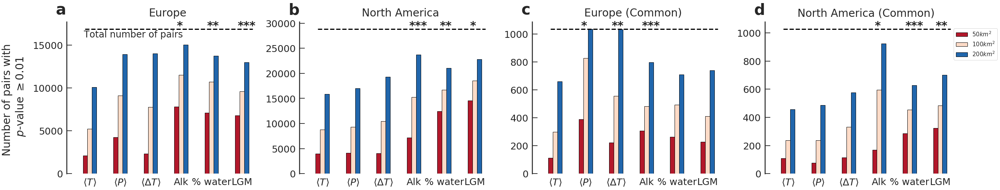

In [772]:
fig, ax = plt.subplots(1, 4, figsize=stdfigsize(ny=1, nx=4))


colors = palettable.colorbrewer.diverging.RdBu_11.mpl_colors
xlabels = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

# set width of bar
barWidth = 0.15
 
# set height of bar
bars1 = num_comp_env_pv_001_5050_europe
bars2 = num_comp_env_pv_001_100100_europe
bars3 = num_comp_env_pv_001_200200_europe

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[0].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[0].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[0].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america
bars2 = num_comp_env_pv_001_100100_north_america
bars3 = num_comp_env_pv_001_200200_north_america

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[1].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[1].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[1].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_europe_common
bars2 = num_comp_env_pv_001_100100_europe_common
bars3 = num_comp_env_pv_001_200200_europe_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[2].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[2].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[2].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america_common
bars2 = num_comp_env_pv_001_100100_north_america_common
bars3 = num_comp_env_pv_001_200200_north_america_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[3].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[3].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[3].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# Create legend & Show graphic
plt.legend(['$50km^2$', '$100km^2$', '$200km^2$'], fontsize=15, loc=(0.97,0.75))

# dashed line with total number of pairs
y_lim_1 = [comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_2 = [comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_3 = [comp_env_dist_sister_5050_europe_common[comp_env_dist_sister_5050_europe_common['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_4 = [comp_env_dist_sister_5050_north_america_common[comp_env_dist_sister_5050_north_america_common['feature'] == feature]['total_pairs'].sum() for feature in features]

ax[0].plot([0, 5.5], y_lim_1[:2], ls='--', color='k', lw=3)
ax[1].plot([0, 5.5], y_lim_2[:2], ls='--', color='k', lw=3)
ax[2].plot([0, 5.5], y_lim_3[:2], ls='--', color='k', lw=3)
ax[3].plot([0, 5.5], y_lim_4[:2], ls='--', color='k', lw=3)

mean_1 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe, '100': num_comp_env_pv_001_100100_europe, '200': num_comp_env_pv_001_200200_europe}).mean(axis=1))
mean_2 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america, '100': num_comp_env_pv_001_100100_north_america, '200': num_comp_env_pv_001_200200_north_america}).mean(axis=1))
mean_3 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe_common, '100': num_comp_env_pv_001_100100_europe_common, '200': num_comp_env_pv_001_200200_europe_common}).mean(axis=1))
mean_4 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america_common, '100': num_comp_env_pv_001_100100_north_america_common, '200': num_comp_env_pv_001_200200_north_america_common}).mean(axis=1))

pair_1 = sorted(np.asarray([r1, np.asarray(num_comp_env_pv_001_100100_europe)]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_2 = sorted(np.asarray([r1, np.asarray(num_comp_env_pv_001_100100_north_america)]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_3 = sorted(np.asarray([r1, np.asarray(num_comp_env_pv_001_100100_europe_common)]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_4 = sorted(np.asarray([r1, np.asarray(num_comp_env_pv_001_100100_north_america_common)]).T, key=lambda a_entry: a_entry[1], reverse=True)

pair_1 = sorted(np.asarray([r1, mean_1]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_2 = sorted(np.asarray([r1, mean_2]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_3 = sorted(np.asarray([r1, mean_3]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_4 = sorted(np.asarray([r1, mean_4]).T, key=lambda a_entry: a_entry[1], reverse=True)

ax[0].annotate('*',   xy=(pair_1[0][0], y_lim_1[0]), fontsize=30, weight='bold')
ax[0].annotate('**',  xy=(pair_1[1][0], y_lim_1[0]), fontsize=30, weight='bold')
ax[0].annotate('***', xy=(pair_1[2][0], y_lim_1[0]), fontsize=30, weight='bold')

ax[1].annotate('*',   xy=(pair_2[0][0], y_lim_2[0]), fontsize=30, weight='bold')
ax[1].annotate('**',  xy=(pair_2[1][0], y_lim_2[0]), fontsize=30, weight='bold')
ax[1].annotate('***', xy=(pair_2[2][0], y_lim_2[0]), fontsize=30, weight='bold')

ax[2].annotate('*',   xy=(pair_3[0][0], y_lim_3[0]), fontsize=30, weight='bold')
ax[2].annotate('**',  xy=(pair_3[1][0], y_lim_3[0]), fontsize=30, weight='bold')
ax[2].annotate('***', xy=(pair_3[2][0], y_lim_3[0]), fontsize=30, weight='bold')

ax[3].annotate('*',   xy=(pair_4[0][0], y_lim_4[0]), fontsize=30, weight='bold')
ax[3].annotate('**',  xy=(pair_4[1][0], y_lim_4[0]), fontsize=30, weight='bold')
ax[3].annotate('***', xy=(pair_4[2][0], y_lim_4[0]), fontsize=30, weight='bold')

ax[0].annotate('Total number of pairs', xy=(0.05, 0.9), xycoords='axes fraction', fontsize=24)

c = 0
for ax in ax.flat:
    for loc, spine in ax.spines.items():
        if loc in ['left']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top', 'bottom']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)

        # Only show ticks on the left and bottom spines
        ax.yaxis.set_ticks_position('left')
        ax.xaxis.set_ticks_position('none') 
        
    ax.set_xticks([r + 0.15 for r in range(len(bars1))])
    ax.set_xticklabels(xlabels)
    if c == 0:
        ax.set_ylabel('Number of pairs with \n $p$-value $\geq 0.01$')
#     ax.yaxis.set_label_coords(-0.1,1.02,)
#     ax.annotate('$\%\ p$-value $\geq 0.05$', xy=(-0.2,1.05), xycoords='axes fraction', fontsize=20)
    ax.set_title(['Europe', 'North America', 'Europe (Common)', 'North America (Common)'][c])
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')

    
    c += 1


fig.tight_layout()
# fig.savefig('../figures/pairs_features_numb_pvalue.pdf', bbox_inches='tight')
# fig.savefig('../figures/pairs_features_numb_pvalue.png', bbox_inches='tight')

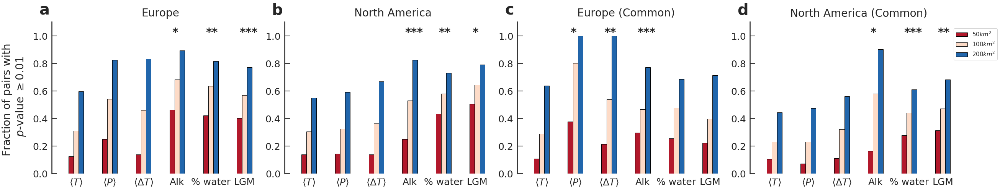

In [775]:
fig, ax = plt.subplots(1, 4, figsize=stdfigsize(ny=1, nx=4))


colors = palettable.colorbrewer.diverging.RdBu_11.mpl_colors
xlabels = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

# set width of bar
barWidth = 0.15

pairs_europe               =                             comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_europe_common        =               comp_env_dist_sister_5050_europe_common[comp_env_dist_sister_5050_europe_common['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_north_america        =               comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_north_america_common = comp_env_dist_sister_5050_north_america_common[comp_env_dist_sister_5050_north_america_common['feature'] == 'mean_temp']['total_pairs'].sum()


# set height of bar
bars1 = num_comp_env_pv_001_5050_europe/pairs_europe
bars2 = num_comp_env_pv_001_100100_europe/pairs_europe
bars3 = num_comp_env_pv_001_200200_europe/pairs_europe

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[0].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[0].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[0].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america/pairs_north_america
bars2 = num_comp_env_pv_001_100100_north_america/pairs_north_america
bars3 = num_comp_env_pv_001_200200_north_america/pairs_north_america

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[1].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[1].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[1].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_europe_common/pairs_europe_common
bars2 = num_comp_env_pv_001_100100_europe_common/pairs_europe_common
bars3 = num_comp_env_pv_001_200200_europe_common/pairs_europe_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[2].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[2].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[2].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america_common/pairs_north_america_common
bars2 = num_comp_env_pv_001_100100_north_america_common/pairs_north_america_common
bars3 = num_comp_env_pv_001_200200_north_america_common/pairs_north_america_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[3].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[3].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[3].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# Create legend & Show graphic
plt.legend(['$50km^2$', '$100km^2$', '$200km^2$'], fontsize=15, loc=(0.97,0.75))

# dashed line with total number of pairs
y_lim_1 = [comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_2 = [comp_env_dist_sister_5050_north_america[comp_env_dist_sister_5050_north_america['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_3 = [comp_env_dist_sister_5050_europe_common[comp_env_dist_sister_5050_europe_common['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_4 = [comp_env_dist_sister_5050_north_america_common[comp_env_dist_sister_5050_north_america_common['feature'] == feature]['total_pairs'].sum() for feature in features]

# ax[0].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[1].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[2].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[3].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)

mean_1 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe/pairs_europe, '100': num_comp_env_pv_001_100100_europe/pairs_europe, '200': num_comp_env_pv_001_200200_europe/pairs_europe}).mean(axis=1))

mean_2 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america/pairs_north_america, '100': num_comp_env_pv_001_100100_north_america/pairs_north_america, '200': num_comp_env_pv_001_200200_north_america/pairs_north_america}).mean(axis=1))

mean_3 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe_common/pairs_europe_common, '100': num_comp_env_pv_001_100100_europe_common/pairs_europe_common, '200': num_comp_env_pv_001_200200_europe_common/pairs_europe_common}).mean(axis=1))

mean_4 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america_common/pairs_north_america_common, '100': num_comp_env_pv_001_100100_north_america_common/pairs_north_america_common, '200': num_comp_env_pv_001_200200_north_america_common/pairs_north_america_common}).mean(axis=1))

pair_1 = sorted(np.asarray([r1, mean_1]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_2 = sorted(np.asarray([r1, mean_2]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_3 = sorted(np.asarray([r1, mean_3]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_4 = sorted(np.asarray([r1, mean_4]).T, key=lambda a_entry: a_entry[1], reverse=True)

ax[0].annotate('*',   xy=(pair_1[0][0], 1), fontsize=30, weight='bold')
ax[0].annotate('**',  xy=(pair_1[1][0], 1), fontsize=30, weight='bold')
ax[0].annotate('***', xy=(pair_1[2][0], 1), fontsize=30, weight='bold')

ax[1].annotate('*',   xy=(pair_2[0][0], 1), fontsize=30, weight='bold')
ax[1].annotate('**',  xy=(pair_2[1][0], 1), fontsize=30, weight='bold')
ax[1].annotate('***', xy=(pair_2[2][0], 1), fontsize=30, weight='bold')

ax[2].annotate('*',   xy=(pair_3[0][0], 1), fontsize=30, weight='bold')
ax[2].annotate('**',  xy=(pair_3[1][0], 1), fontsize=30, weight='bold')
ax[2].annotate('***', xy=(pair_3[2][0], 1), fontsize=30, weight='bold')

ax[3].annotate('*',   xy=(pair_4[0][0], 1), fontsize=30, weight='bold')
ax[3].annotate('**',  xy=(pair_4[1][0], 1), fontsize=30, weight='bold')
ax[3].annotate('***', xy=(pair_4[2][0], 1), fontsize=30, weight='bold')

# ax[0].annotate('Total number of pairs', xy=(0.05, 0.88), xycoords='axes fraction', fontsize=24)

c = 0
for ax in ax.flat:
    for loc, spine in ax.spines.items():
        if loc in ['left']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top', 'bottom']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)

        # Only show ticks on the left and bottom spines
        ax.yaxis.set_ticks_position('left')
        ax.xaxis.set_ticks_position('none') 
        
    ax.set_xticks([r + 0.15 for r in range(len(bars1))])
    ax.set_xticklabels(xlabels)
    if c == 0:
        ax.set_ylabel('Fraction of pairs with \n $p$-value $\geq 0.01$')
#     ax.yaxis.set_label_coords(-0.1,1.02,)
#     ax.annotate('$\%\ p$-value $\geq 0.05$', xy=(-0.2,1.05), xycoords='axes fraction', fontsize=20)
    ax.set_title(['Europe', 'North America', 'Europe (Common)', 'North America (Common)'][c])
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')

    ax.set_ylim([0,1.1])
    
    c += 1


fig.tight_layout()
# fig.savefig('../figures/pairs_features_frac_pvalue.pdf', bbox_inches='tight')
# fig.savefig('../figures/pairs_features_frac_pvalue.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


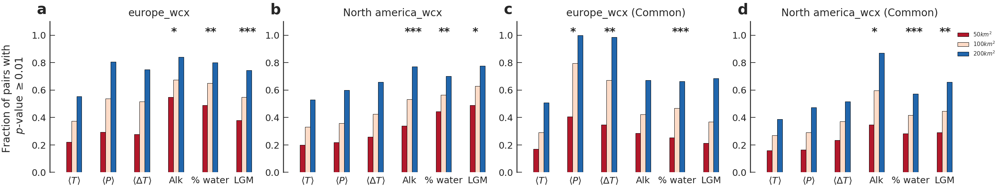

In [100]:
fig, ax = plt.subplots(1, 4, figsize=stdfigsize(ny=1, nx=4))


colors = palettable.colorbrewer.diverging.RdBu_11.mpl_colors
xlabels = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

# set width of bar
barWidth = 0.15

pairs_europe_wcx        = comp_env_dist_sister_5050_europe_wcx[comp_env_dist_sister_5050_europe_wcx['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_europe_wcx_common = comp_env_dist_sister_5050_europe_wcx_common[comp_env_dist_sister_5050_europe_wcx_common['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_north_america_wcx        = comp_env_dist_sister_5050_north_america_wcx[comp_env_dist_sister_5050_north_america_wcx['feature'] == 'mean_temp']['total_pairs'].sum()
pairs_north_america_wcx_common = comp_env_dist_sister_5050_north_america_wcx_common[comp_env_dist_sister_5050_north_america_wcx_common['feature'] == 'mean_temp']['total_pairs'].sum()


# set height of bar
bars1 = num_comp_env_pv_001_5050_europe_wcx/pairs_europe_wcx
bars2 = num_comp_env_pv_001_100100_europe_wcx/pairs_europe_wcx
bars3 = num_comp_env_pv_001_200200_europe_wcx/pairs_europe_wcx

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[0].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[0].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[0].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america_wcx/pairs_north_america_wcx
bars2 = num_comp_env_pv_001_100100_north_america_wcx/pairs_north_america_wcx
bars3 = num_comp_env_pv_001_200200_north_america_wcx/pairs_north_america_wcx

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[1].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[1].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[1].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')

# set height of bar
bars1 = num_comp_env_pv_001_5050_europe_wcx_common/pairs_europe_wcx_common
bars2 = num_comp_env_pv_001_100100_europe_wcx_common/pairs_europe_wcx_common
bars3 = num_comp_env_pv_001_200200_europe_wcx_common/pairs_europe_wcx_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[2].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[2].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[2].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# set height of bar
bars1 = num_comp_env_pv_001_5050_north_america_wcx_common/pairs_north_america_wcx_common
bars2 = num_comp_env_pv_001_100100_north_america_wcx_common/pairs_north_america_wcx_common
bars3 = num_comp_env_pv_001_200200_north_america_wcx_common/pairs_north_america_wcx_common

# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + 0.15 for x in r1]
r3 = [x + 0.15 for x in r2]

# Make the plot
ax[3].bar(r1, bars1, color=colors[1], width=barWidth, edgecolor='k', label='var1')
ax[3].bar(r2, bars2, color=colors[4], width=barWidth, edgecolor='k', label='var2')
ax[3].bar(r3, bars3, color=colors[9], width=barWidth, edgecolor='k', label='var3')


# Create legend & Show graphic
plt.legend(['$50km^2$', '$100km^2$', '$200km^2$'], fontsize=15, loc=(0.97,0.75))

# dashed line with total number of pairs
y_lim_1 = [comp_env_dist_sister_5050_europe_wcx[comp_env_dist_sister_5050_europe_wcx['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_2 = [comp_env_dist_sister_5050_north_america_wcx[comp_env_dist_sister_5050_north_america_wcx['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_3 = [comp_env_dist_sister_5050_europe_wcx_common[comp_env_dist_sister_5050_europe_wcx_common['feature'] == feature]['total_pairs'].sum() for feature in features]
y_lim_4 = [comp_env_dist_sister_5050_north_america_wcx_common[comp_env_dist_sister_5050_north_america_wcx_common['feature'] == feature]['total_pairs'].sum() for feature in features]

# ax[0].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[1].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[2].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)
# ax[3].plot([0, 5.5], [1, 1], ls='--', color='k', lw=3)

mean_1 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe_wcx/pairs_europe_wcx, '100': num_comp_env_pv_001_100100_europe_wcx/pairs_europe_wcx, '200': num_comp_env_pv_001_200200_europe_wcx/pairs_europe_wcx}).mean(axis=1))

mean_2 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america_wcx/pairs_north_america_wcx, '100': num_comp_env_pv_001_100100_north_america_wcx/pairs_north_america_wcx, '200': num_comp_env_pv_001_200200_north_america_wcx/pairs_north_america_wcx}).mean(axis=1))

mean_3 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_europe_wcx_common/pairs_europe_wcx_common, '100': num_comp_env_pv_001_100100_europe_wcx_common/pairs_europe_wcx_common, '200': num_comp_env_pv_001_200200_europe_wcx_common/pairs_europe_wcx_common}).mean(axis=1))

mean_4 = np.asarray(pd.DataFrame({'50': num_comp_env_pv_001_5050_north_america_wcx_common/pairs_north_america_wcx_common, '100': num_comp_env_pv_001_100100_north_america_wcx_common/pairs_north_america_wcx_common, '200': num_comp_env_pv_001_200200_north_america_wcx_common/pairs_north_america_wcx_common}).mean(axis=1))

pair_1 = sorted(np.asarray([r1, mean_1]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_2 = sorted(np.asarray([r1, mean_2]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_3 = sorted(np.asarray([r1, mean_3]).T, key=lambda a_entry: a_entry[1], reverse=True)
pair_4 = sorted(np.asarray([r1, mean_4]).T, key=lambda a_entry: a_entry[1], reverse=True)

ax[0].annotate('*',   xy=(pair_1[0][0], 1), fontsize=30, weight='bold')
ax[0].annotate('**',  xy=(pair_1[1][0], 1), fontsize=30, weight='bold')
ax[0].annotate('***', xy=(pair_1[2][0], 1), fontsize=30, weight='bold')

ax[1].annotate('*',   xy=(pair_2[0][0], 1), fontsize=30, weight='bold')
ax[1].annotate('**',  xy=(pair_2[1][0], 1), fontsize=30, weight='bold')
ax[1].annotate('***', xy=(pair_2[2][0], 1), fontsize=30, weight='bold')

ax[2].annotate('*',   xy=(pair_3[0][0], 1), fontsize=30, weight='bold')
ax[2].annotate('**',  xy=(pair_3[1][0], 1), fontsize=30, weight='bold')
ax[2].annotate('***', xy=(pair_3[2][0], 1), fontsize=30, weight='bold')

ax[3].annotate('*',   xy=(pair_4[0][0], 1), fontsize=30, weight='bold')
ax[3].annotate('**',  xy=(pair_4[1][0], 1), fontsize=30, weight='bold')
ax[3].annotate('***', xy=(pair_4[2][0], 1), fontsize=30, weight='bold')

# ax[0].annotate('Total number of pairs', xy=(0.05, 0.88), xycoords='axes fraction', fontsize=24)

c = 0
for ax in ax.flat:
    for loc, spine in ax.spines.items():
        if loc in ['left']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top', 'bottom']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)

        # Only show ticks on the left and bottom spines
        ax.yaxis.set_ticks_position('left')
        ax.xaxis.set_ticks_position('none') 
        
    ax.set_xticks([r + 0.15 for r in range(len(bars1))])
    ax.set_xticklabels(xlabels)
    if c == 0:
        ax.set_ylabel('Fraction of pairs with \n $p$-value $\geq 0.01$')
#     ax.yaxis.set_label_coords(-0.1,1.02,)
#     ax.annotate('$\%\ p$-value $\geq 0.05$', xy=(-0.2,1.05), xycoords='axes fraction', fontsize=20)
    ax.set_title(['europe_wcx', 'North america_wcx', 'europe_wcx (Common)', 'North america_wcx (Common)'][c])
    ax.annotate(string.ascii_lowercase[c], xy=(-0.1, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')

    ax.set_ylim([0,1.1])
    
    c += 1


fig.tight_layout()
# fig.savefig('../figures/pairs_features_frac_pvalue_wcx.pdf', bbox_inches='tight')
# fig.savefig('../figures/pairs_features_frac_pvalue_wcx.png', bbox_inches='tight')

### Comparison of the environmental distributions between sister species within sympatry intervals
<a id="comparison-of-the-environmental-distributions-sister-sympatry"></a>
<a href="#summary">Summary</a>

In [367]:
comp_env_dist_sister_5050_europe_sympt        = comp_env_dist_sister(overlap_features_5050_europe_ok, symp=True)
comp_env_dist_sister_5050_europe_sympt_common = comp_env_dist_sister(overlap_features_5050_europe_common_ok, symp=True)

comp_env_dist_sister_100100_europe_sympt        = comp_env_dist_sister(overlap_features_100100_europe_ok, symp=True)
comp_env_dist_sister_100100_europe_sympt_common = comp_env_dist_sister(overlap_features_100100_europe_common_ok, symp=True)

comp_env_dist_sister_200200_europe_sympt        = comp_env_dist_sister(overlap_features_200200_europe_ok, symp=True)
comp_env_dist_sister_200200_europe_sympt_common = comp_env_dist_sister(overlap_features_200200_europe_common_ok, symp=True)

In [368]:
comp_env_dist_sister_5050_europe_sympt[comp_env_dist_sister_5050_europe_sympt['feature'] == features[0]]

,feature,genus,pvalues,symp_1,symp_2
0,mean_temp,Alisma,1.423256e-05,0.772511,0.971153
1,mean_temp,Alisma,8.986672e-01,0.772511,0.971830
2,mean_temp,Alisma,3.644389e-07,0.772511,1.000000
3,mean_temp,Alisma,3.338025e-05,0.971153,0.971830
4,mean_temp,Alisma,1.321530e-06,0.971153,1.000000
...,...,...,...,...,...
101161,mean_temp,Utricularia,2.958670e-20,0.934744,0.963785
101162,mean_temp,Utricularia,1.564990e-20,0.959210,0.963785
101238,mean_temp,Veronica,1.448301e-04,0.975911,0.982217
101239,mean_temp,Veronica,1.448301e-04,0.975911,0.982028


In [369]:
# number of pairs with sympatry threshold
symp_thresh = comp_env_dist_sister_5050_europe_sympt[(comp_env_dist_sister_5050_europe_sympt['feature'] == features[0]) & (comp_env_dist_sister_5050_europe_sympt['symp_1'] >= 0) & (comp_env_dist_sister_5050_europe_sympt['symp_2'] >= 0)]
symp_thresh[symp_thresh['pvalues'] >= 0.01].shape[0]/symp_thresh.shape[0]

0.124614837639251

In [370]:
comp_env_dist_sister_5050_north_america_sympt        = comp_env_dist_sister(overlap_features_5050_north_america_ok, symp=True)
comp_env_dist_sister_5050_north_america_sympt_common = comp_env_dist_sister(overlap_features_5050_north_america_common_ok, symp=True)

comp_env_dist_sister_100100_north_america_sympt        = comp_env_dist_sister(overlap_features_100100_north_america_ok, symp=True)
comp_env_dist_sister_100100_north_america_sympt_common = comp_env_dist_sister(overlap_features_100100_north_america_common_ok, symp=True)

comp_env_dist_sister_200200_north_america_sympt        = comp_env_dist_sister(overlap_features_200200_north_america_ok, symp=True)
comp_env_dist_sister_200200_north_america_sympt_common = comp_env_dist_sister(overlap_features_200200_north_america_common_ok, symp=True)

In [220]:
comp_env_dist_sister_5050_europe_wcx        = comp_env_dist_sister(overlap_features_5050_europe_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_5050_europe_wcx_common = comp_env_dist_sister(overlap_features_5050_europe_common_ok, symp=True, method='wilcoxon')

comp_env_dist_sister_100100_europe_wcx        = comp_env_dist_sister(overlap_features_100100_europe_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_100100_europe_wcx_common = comp_env_dist_sister(overlap_features_100100_europe_common_ok, symp=True, method='wilcoxon')

comp_env_dist_sister_200200_europe_wcx        = comp_env_dist_sister(overlap_features_200200_europe_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_200200_europe_wcx_common = comp_env_dist_sister(overlap_features_200200_europe_common_ok, symp=True, method='wilcoxon')

In [221]:
comp_env_dist_sister_5050_north_america_wcx        = comp_env_dist_sister(overlap_features_5050_north_america_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_5050_north_america_wcx_common = comp_env_dist_sister(overlap_features_5050_north_america_common_ok, symp=True, method='wilcoxon')

comp_env_dist_sister_100100_north_america_wcx        = comp_env_dist_sister(overlap_features_100100_north_america_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_100100_north_america_wcx_common = comp_env_dist_sister(overlap_features_100100_north_america_common_ok, symp=True, method='wilcoxon')

comp_env_dist_sister_200200_north_america_wcx        = comp_env_dist_sister(overlap_features_200200_north_america_ok, symp=True, method='wilcoxon')
comp_env_dist_sister_200200_north_america_wcx_common = comp_env_dist_sister(overlap_features_200200_north_america_common_ok, symp=True, method='wilcoxon')

In [104]:
df = comp_env_dist_sister_5050_europe
df_symp  = df[(df[['symp_1', 'symp_2']] >= 0.8).all(axis=1)]
df_mask  = df_symp[(df_symp['genus'] == 'Veronica') & (df_symp['feature'] == 'lgm')]
df_final = df_mask[df_mask['pvalues'] >= 0.01/(df_mask.shape[0]-1)]
df_final

,feature,genus,pvalues,symp_1,symp_2
101253,lgm,Veronica,0.005257,0.975911,0.982217
101255,lgm,Veronica,1.000000,0.982217,0.982028


In [105]:
df_mask

,feature,genus,pvalues,symp_1,symp_2
101253,lgm,Veronica,0.005257,0.975911,0.982217
101254,lgm,Veronica,0.003389,0.975911,0.982028
101255,lgm,Veronica,1.000000,0.982217,0.982028


In [106]:
df_final.shape[0]/df_mask.shape[0]

0.6666666666666666

In [215]:
# feature, genus, frac_pvalues, <s>, s, 1-s

# variables
s = 0
df = comp_env_dist_sister_5050_europe

def com_env_dist_sister_symp(df, order='greater'):
    
    l = []
    for s in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
        # check the sympatry of both pairs
        if order == 'greater':
            df_symp = df[(df[['symp_1', 'symp_2']] >= 1-s).all(axis=1)]
        elif order == 'less':
            df_symp = df[(df[['symp_1', 'symp_2']] <= s).all(axis=1)]
        #check the sympatry mean value
        elif order == 'mean_greater':
            df_symp = df[df[['symp_1', 'symp_2']].mean(axis=1) >= 1-s]
        elif order == 'mean_less':
            df_symp = df[df[['symp_1', 'symp_2']].mean(axis=1) <= s]
        else:
            raise ValueError('unknown order value: {}'.format(order))

        
        # loop through the genus
        for genus in df_symp['genus'].unique():

            # loop through the features
            for feature in df_symp['feature'].unique():

                df_mask = df_symp[(df_symp['genus'] == genus) & (df_symp['feature'] == feature)]

                perc_001_df = df_mask['pvalues'][df_mask['pvalues'] >= 0.01].dropna()
                perc_005_df = df_mask['pvalues'][df_mask['pvalues'] >= 0.05].dropna()
                
                # bonferroni
                if df_mask.shape[0] > 1:
                    perc_001_bf_df = df_mask['pvalues'][df_mask['pvalues'] >= (0.01/(df_mask.shape[0]-1))].dropna()
                    perc_005_bf_df = df_mask['pvalues'][df_mask['pvalues'] >= (0.05/(df_mask.shape[0]-1))].dropna()
                else:
                    perc_001_bf_df = df_mask['pvalues'][df_mask['pvalues'] >= 0.01].dropna()
                    perc_005_bf_df = df_mask['pvalues'][df_mask['pvalues'] >= 0.05].dropna()

                if perc_001_df.shape[0] > 0:
                    perc_001 = perc_001_df.shape[0]/df_mask['pvalues'].shape[0]
                    n_pairs_001 = perc_001_df.shape[0]
                else:
                    perc_001 = 0
                    n_pairs_001 = 0

                if perc_005_df.shape[0] > 0:
                    perc_005 = perc_005_df.shape[0]/df_mask['pvalues'].shape[0]
                    n_pairs_005 = perc_005_df.shape[0]
                else:
                    perc_005 = 0
                    n_pairs_005 = 0
                
                # bonferroni
                if perc_001_bf_df.shape[0] > 0:
                    perc_001_bf = perc_001_bf_df.shape[0]/df_mask['pvalues'].shape[0]
                    n_pairs_001_bf = perc_001_bf_df.shape[0]
                else:
                    perc_001_bf = 0
                    n_pairs_001_bf = 0

                if perc_005_bf_df.shape[0] > 0:
                    perc_005_bf = perc_005_bf_df.shape[0]/df_mask['pvalues'].shape[0]
                    n_pairs_005_bf = perc_005_bf_df.shape[0]
                else:
                    perc_005_bf = 0
                    n_pairs_005_bf = 0

                if order == 'greater':
                    df_tmp = pd.DataFrame({'genus': genus, 'feature': feature, 'perc_001': perc_001, 'perc_005': perc_005, 'perc_001_bf': perc_001_bf, 'perc_005_bf': perc_005_bf, '1-s': [1-s], 's': [s]})
                elif order == 'less':
                    df_tmp = pd.DataFrame({'genus': genus, 'feature': feature, 'perc_001': perc_001, 'perc_005': perc_005, 'perc_001_bf': perc_001_bf, 'perc_005_bf': perc_005_bf, 's': [s], 's': [s]})

                l.append(df_tmp)
    
    return pd.concat(l).reset_index(drop=True)

In [264]:
comp_env_dist_sister_5050_europe

,feature,genus,n_pairs_001,n_pairs_001_bf,n_pairs_005,n_pairs_005_bf,perc_001,perc_001_bf,perc_005,perc_005_bf,pvalues,total_pairs
0,mean_temp,Alisma,1,6,1,6,0.166667,1.0,0.166667,1.0,"[1.4232563385055913e-05, 0.8986671588373192, 3...",6
1,mean_prec,Alisma,3,6,2,6,0.500000,1.0,0.333333,1.0,"[0.2033911399986462, 0.7953694474160453, 4.852...",6
2,mean_vtemp,Alisma,4,6,3,6,0.666667,1.0,0.500000,1.0,"[0.03523793529522201, 0.00020606555343438189, ...",6
3,alkalinity,Alisma,3,6,3,6,0.500000,1.0,0.500000,1.0,"[0.8138418378039582, 0.743845070323885, 1.2781...",6
4,water,Alisma,3,6,3,6,0.500000,1.0,0.500000,1.0,"[0.3389518409710852, 0.234048084052765, 2.8188...",6
...,...,...,...,...,...,...,...,...,...,...,...,...
163,mean_prec,Veronica,3,3,1,3,1.000000,1.0,0.333333,1.0,"[0.0399699219211373, 0.01914158277280751, 0.99...",3
164,mean_vtemp,Veronica,1,3,1,3,0.333333,1.0,0.333333,1.0,"[2.1801951474479668e-40, 6.932123506560879e-42...",3
165,alkalinity,Veronica,3,3,1,3,1.000000,1.0,0.333333,1.0,"[0.015751159430277682, 0.017688522450822763, 0...",3
166,water,Veronica,1,3,1,3,0.333333,1.0,0.333333,1.0,"[1.1766765919634464e-08, 2.8544036727427838e-0...",3


In [258]:
comp_env_dist_sister_5050_europe[comp_env_dist_sister_5050_europe['genus'] == 'Ceratophyllum']

,feature,genus,n_pairs_001,n_pairs_001_bf,n_pairs_005,n_pairs_005_bf,perc_001,perc_001_bf,perc_005,perc_005_bf,pvalues,total_pairs
18,mean_temp,Ceratophyllum,8,10,8,10,0.8,1.0,0.8,1.0,"[0.6900588451713706, 0.17202395906802742, 1.0,...",10
19,mean_prec,Ceratophyllum,8,10,4,10,0.8,1.0,0.4,1.0,"[0.043233097674686576, 0.5134400129869108, 1.0...",10
20,mean_vtemp,Ceratophyllum,2,10,2,10,0.2,1.0,0.2,1.0,"[0.0017903914830487639, 0.0005120717061714125,...",10
21,alkalinity,Ceratophyllum,6,10,2,10,0.6,1.0,0.2,1.0,"[0.001024086076519464, 0.0221336525393677, 1.0...",10
22,water,Ceratophyllum,10,10,10,10,1.0,1.0,1.0,1.0,"[0.3515076878175041, 0.6066247962496691, 1.0, ...",10
23,lgm,Ceratophyllum,10,10,10,10,1.0,1.0,1.0,1.0,"[0.9999999891130079, 0.9998700152079948, 1.0, ...",10


In [260]:
com_env_dist_sister_symp_5050_europe_greater[(com_env_dist_sister_symp_5050_europe_greater['s'] == 1.0) & (com_env_dist_sister_symp_5050_europe_greater['genus'] == 'Ceratophyllum')]

,1-s,feature,genus,perc_001,perc_001_bf,perc_005,perc_005_bf,s
786,0.0,mean_temp,Ceratophyllum,0.8,1.0,0.8,0.8,1.0
787,0.0,mean_prec,Ceratophyllum,0.8,0.8,0.4,0.8,1.0
788,0.0,mean_vtemp,Ceratophyllum,0.2,0.8,0.2,0.2,1.0
789,0.0,alkalinity,Ceratophyllum,0.6,0.6,0.2,0.6,1.0
790,0.0,water,Ceratophyllum,1.0,1.0,1.0,1.0,1.0
791,0.0,lgm,Ceratophyllum,1.0,1.0,1.0,1.0,1.0


In [263]:
com_env_dist_sister_symp_5050_europe_greater[(com_env_dist_sister_symp_5050_europe_greater['s'] == 1.0)]

,1-s,feature,genus,perc_001,perc_001_bf,perc_005,perc_005_bf,s
768,0.0,mean_temp,Alisma,0.166667,0.166667,0.166667,0.166667,1.0
769,0.0,mean_prec,Alisma,0.500000,0.500000,0.333333,0.500000,1.0
770,0.0,mean_vtemp,Alisma,0.666667,0.833333,0.500000,0.666667,1.0
771,0.0,alkalinity,Alisma,0.500000,0.500000,0.500000,0.500000,1.0
772,0.0,water,Alisma,0.500000,0.500000,0.500000,0.500000,1.0
...,...,...,...,...,...,...,...,...
853,0.0,mean_prec,Veronica,1.000000,1.000000,0.333333,0.666667,1.0
854,0.0,mean_vtemp,Veronica,0.333333,0.333333,0.333333,0.333333,1.0
855,0.0,alkalinity,Veronica,1.000000,1.000000,0.333333,0.333333,1.0
856,0.0,water,Veronica,0.333333,0.333333,0.333333,0.333333,1.0


In [223]:
com_env_dist_sister_symp_5050_europe_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe)
com_env_dist_sister_symp_100100_europe_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe)
com_env_dist_sister_symp_200200_europe_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe)

com_env_dist_sister_symp_5050_europe_common_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_common)
com_env_dist_sister_symp_100100_europe_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_common)
com_env_dist_sister_symp_200200_europe_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_common)

In [225]:
com_env_dist_sister_symp_5050_north_america_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america)
com_env_dist_sister_symp_100100_north_america_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america)
com_env_dist_sister_symp_200200_north_america_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america)

com_env_dist_sister_symp_5050_north_america_common_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_common)
com_env_dist_sister_symp_100100_north_america_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_common)
com_env_dist_sister_symp_200200_north_america_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_common)

In [226]:
com_env_dist_sister_symp_5050_europe_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe, order='less')
com_env_dist_sister_symp_100100_europe_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe, order='less')
com_env_dist_sister_symp_200200_europe_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe, order='less')

com_env_dist_sister_symp_5050_europe_common_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_common, order='less')
com_env_dist_sister_symp_100100_europe_common_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_common, order='less')
com_env_dist_sister_symp_200200_europe_common_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_common, order='less')

In [227]:
com_env_dist_sister_symp_5050_north_america_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america, order='less')
com_env_dist_sister_symp_100100_north_america_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america, order='less')
com_env_dist_sister_symp_200200_north_america_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america, order='less')

com_env_dist_sister_symp_5050_north_america_common_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_common, order='less')
com_env_dist_sister_symp_100100_north_america_common_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_common, order='less')
com_env_dist_sister_symp_200200_north_america_common_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_common, order='less')

In [215]:
com_env_dist_sister_symp_5050_europe_greater['feature'].unique().shape

(6,)

In [223]:
features

['mean_temp', 'mean_prec', 'mean_vtemp', 'alkalinity', 'water', 'lgm']

In [122]:
com_env_dist_sister_symp_5050_europe_wcx_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_wcx)
com_env_dist_sister_symp_100100_europe_wcx_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_wcx)
com_env_dist_sister_symp_200200_europe_wcx_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_wcx)

com_env_dist_sister_symp_5050_europe_wcx_common_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_wcx_common)
com_env_dist_sister_symp_100100_europe_wcx_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_wcx_common)
com_env_dist_sister_symp_200200_europe_wcx_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_wcx_common)

In [125]:
com_env_dist_sister_symp_5050_north_america_wcx_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_wcx)
com_env_dist_sister_symp_100100_north_america_wcx_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_wcx)
com_env_dist_sister_symp_200200_north_america_wcx_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_wcx)

com_env_dist_sister_symp_5050_north_america_wcx_common_greater   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_wcx_common)
com_env_dist_sister_symp_100100_north_america_wcx_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_wcx_common)
com_env_dist_sister_symp_200200_north_america_wcx_common_greater = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_wcx_common)

In [126]:
com_env_dist_sister_symp_5050_europe_wcx_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_wcx, order='less')
com_env_dist_sister_symp_100100_europe_wcx_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_wcx, order='less')
com_env_dist_sister_symp_200200_europe_wcx_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_wcx, order='less')

com_env_dist_sister_symp_5050_europe_wcx_common_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_europe_wcx_common, order='less')
com_env_dist_sister_symp_100100_europe_wcx_common_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_europe_wcx_common, order='less')
com_env_dist_sister_symp_200200_europe_wcx_common_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_europe_wcx_common, order='less')

In [127]:
com_env_dist_sister_symp_5050_north_america_wcx_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_wcx, order='less')
com_env_dist_sister_symp_100100_north_america_wcx_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_wcx, order='less')
com_env_dist_sister_symp_200200_north_america_wcx_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_wcx, order='less')

com_env_dist_sister_symp_5050_north_america_wcx_common_less   = com_env_dist_sister_symp(comp_env_dist_sister_5050_north_america_wcx_common, order='less')
com_env_dist_sister_symp_100100_north_america_wcx_common_less = com_env_dist_sister_symp(comp_env_dist_sister_100100_north_america_wcx_common, order='less')
com_env_dist_sister_symp_200200_north_america_wcx_common_less = com_env_dist_sister_symp(comp_env_dist_sister_200200_north_america_wcx_common, order='less')

In [397]:
def symp_pairs(df, order='greater'):
    
    l = []
    for s in [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
        # check the sympatry of both pairs
        if order == 'greater':
            df_symp = df[(df[['symp_1', 'symp_2']] >= 1-s).all(axis=1)]
        elif order == 'less':
            df_symp = df[(df[['symp_1', 'symp_2']] <= s).all(axis=1)]
        #check the sympatry mean value
        elif order == 'mean_greater':
            df_symp = df[df[['symp_1', 'symp_2']].mean(axis=1) >= 1-s]
        elif order == 'mean_less':
            df_symp = df[df[['symp_1', 'symp_2']].mean(axis=1) <= s]
        else:
            raise ValueError('unknown order value: {}'.format(order))
            
        for feature in features:
            if df_symp[df_symp['feature'] == feature].shape[0] > 0:
                frac = df_symp[(df_symp['feature'] == feature) & (df_symp['pvalues'] >= 0.01)].shape[0]/df_symp[df_symp['feature'] == feature].shape[0]
                mean = df_symp[(df_symp['feature'] == feature) & (df_symp['pvalues'] >= 0.01)]['pvalues'].mean()
                percentiles = np.percentile(df_symp[(df_symp['feature'] == feature) & (df_symp['pvalues'] >= 0.01)]['pvalues'], q=[5, 95])
            
                l.append([feature, frac, mean, s, *percentiles])
        
    _df = pd.DataFrame(l, columns=['feature', 'frac', 'mean', 's', 'percentile_5', 'percentile_95'])
    
    return _df

In [372]:
symp_pairs_5050_europe_greater_pairs   = symp_pairs(comp_env_dist_sister_5050_europe_sympt  , order='greater')
symp_pairs_100100_europe_greater_pairs = symp_pairs(comp_env_dist_sister_100100_europe_sympt, order='greater')
symp_pairs_200200_europe_greater_pairs = symp_pairs(comp_env_dist_sister_200200_europe_sympt, order='greater')

symp_pairs_5050_europe_common_greater_pairs   = symp_pairs(comp_env_dist_sister_5050_europe_sympt_common  , order='greater')
symp_pairs_100100_europe_common_greater_pairs = symp_pairs(comp_env_dist_sister_100100_europe_sympt_common, order='greater')
symp_pairs_200200_europe_common_greater_pairs = symp_pairs(comp_env_dist_sister_200200_europe_sympt_common, order='greater')

In [373]:
symp_pairs_5050_north_america_greater_pairs   = symp_pairs(comp_env_dist_sister_5050_north_america_sympt  , order='greater')
symp_pairs_100100_north_america_greater_pairs = symp_pairs(comp_env_dist_sister_100100_north_america_sympt, order='greater')
symp_pairs_200200_north_america_greater_pairs = symp_pairs(comp_env_dist_sister_200200_north_america_sympt, order='greater')

symp_pairs_5050_north_america_common_greater_pairs   = symp_pairs(comp_env_dist_sister_5050_north_america_sympt_common  , order='greater')
symp_pairs_100100_north_america_common_greater_pairs = symp_pairs(comp_env_dist_sister_100100_north_america_sympt_common, order='greater')
symp_pairs_200200_north_america_common_greater_pairs = symp_pairs(comp_env_dist_sister_200200_north_america_sympt_common, order='greater')

In [374]:
symp_pairs_5050_europe_less_pairs   = symp_pairs(comp_env_dist_sister_5050_europe_sympt  , order='less')
symp_pairs_100100_europe_less_pairs = symp_pairs(comp_env_dist_sister_100100_europe_sympt, order='less')
symp_pairs_200200_europe_less_pairs = symp_pairs(comp_env_dist_sister_200200_europe_sympt, order='less')

symp_pairs_5050_europe_common_less_pairs   = symp_pairs(comp_env_dist_sister_5050_europe_sympt_common  , order='less')
symp_pairs_100100_europe_common_less_pairs = symp_pairs(comp_env_dist_sister_100100_europe_sympt_common, order='less')
symp_pairs_200200_europe_common_less_pairs = symp_pairs(comp_env_dist_sister_200200_europe_sympt_common, order='less')

In [375]:
symp_pairs_5050_north_america_less_pairs   = symp_pairs(comp_env_dist_sister_5050_north_america_sympt  , order='less')
symp_pairs_100100_north_america_less_pairs = symp_pairs(comp_env_dist_sister_100100_north_america_sympt, order='less')
symp_pairs_200200_north_america_less_pairs = symp_pairs(comp_env_dist_sister_200200_north_america_sympt, order='less')

symp_pairs_5050_north_america_common_less_pairs   = symp_pairs(comp_env_dist_sister_5050_north_america_sympt_common  , order='less')
symp_pairs_100100_north_america_common_less_pairs = symp_pairs(comp_env_dist_sister_100100_north_america_sympt_common, order='less')
symp_pairs_200200_north_america_common_less_pairs = symp_pairs(comp_env_dist_sister_200200_north_america_sympt_common, order='less')

For the increasing in the sympatry value (overlap $\geq 1-s$), for s = 1.0, we should include all the pairs:

In [78]:
symp_pairs_5050_europe_greater_pairs[(symp_pairs_5050_europe_greater_pairs['feature'] == 'mean_temp') & (symp_pairs_5050_europe_greater_pairs['s'] == 1.0)]

,feature,frac,s
60,mean_temp,0.124615,1.0


For the descreasing in the sympatry value (overlap $\leq s$), for s = 1.0, we should include all pairs too

In [79]:
symp_pairs_5050_europe_less_pairs[(symp_pairs_5050_europe_less_pairs['feature'] == 'mean_temp') & (symp_pairs_5050_europe_less_pairs['s'] == 1.0)]

,feature,frac,s
48,mean_temp,0.124615,1.0


The plot of both sympatry intervals for the fraction of pvalues should collapse for s = 1.0:

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


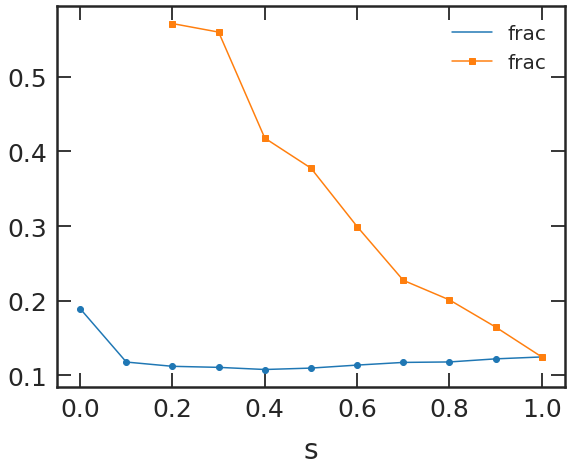

In [376]:
fig, ax = plt.subplots(figsize=stdfigsize())

symp_pairs_5050_europe_greater_pairs[(symp_pairs_5050_europe_greater_pairs['feature'] == 'mean_temp')].plot('s', 'frac', marker='o', ax=ax)
symp_pairs_5050_europe_less_pairs[(symp_pairs_5050_europe_less_pairs['feature'] == 'mean_temp')].plot('s', 'frac', marker='s', ax=ax)

#### Mean fraction of p-values greater than ...
<a id="mean-fraction-of-pvalues-greater"></a>
<a href="#summary">Summary</a>

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


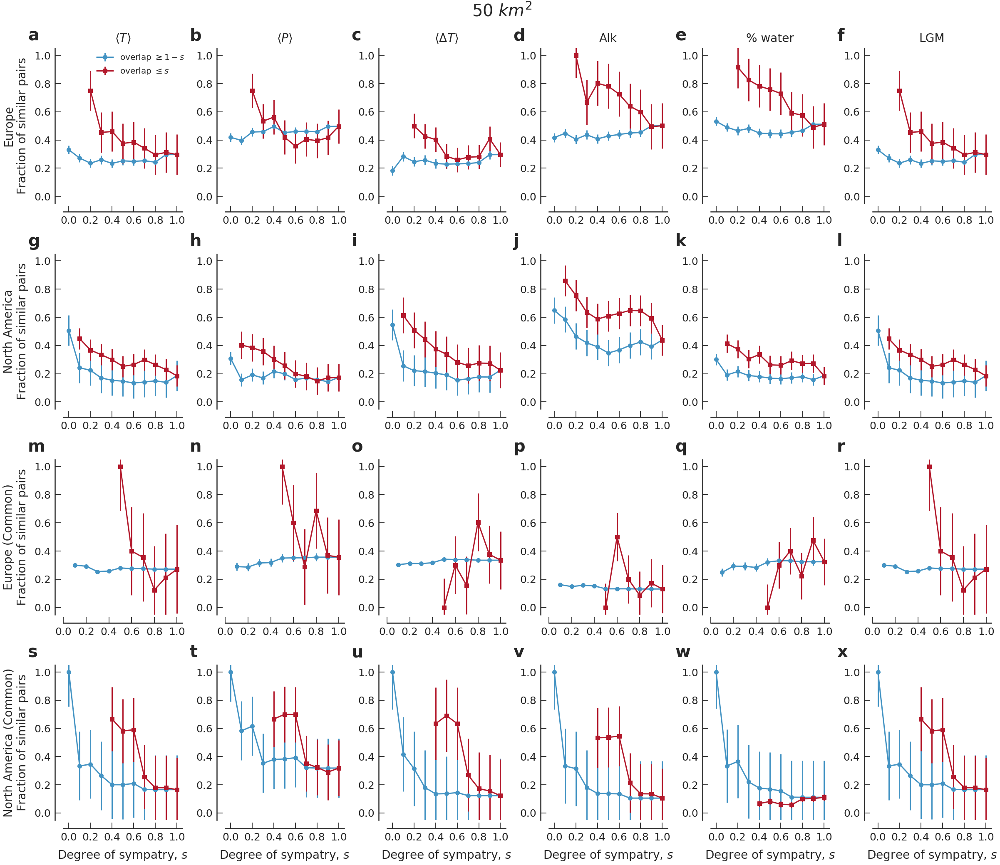

In [422]:
def df_werr(df, s):
    
    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_5050_europe_greater
df_less_1 = com_env_dist_sister_symp_5050_europe_less

df_greater_2 = com_env_dist_sister_symp_5050_europe_common_greater
df_less_2 = com_env_dist_sister_symp_5050_europe_common_less

df_greater_3 = com_env_dist_sister_symp_5050_north_america_greater
df_less_3 = com_env_dist_sister_symp_5050_north_america_less

df_greater_4 = com_env_dist_sister_symp_5050_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_5050_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.8))
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('50 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


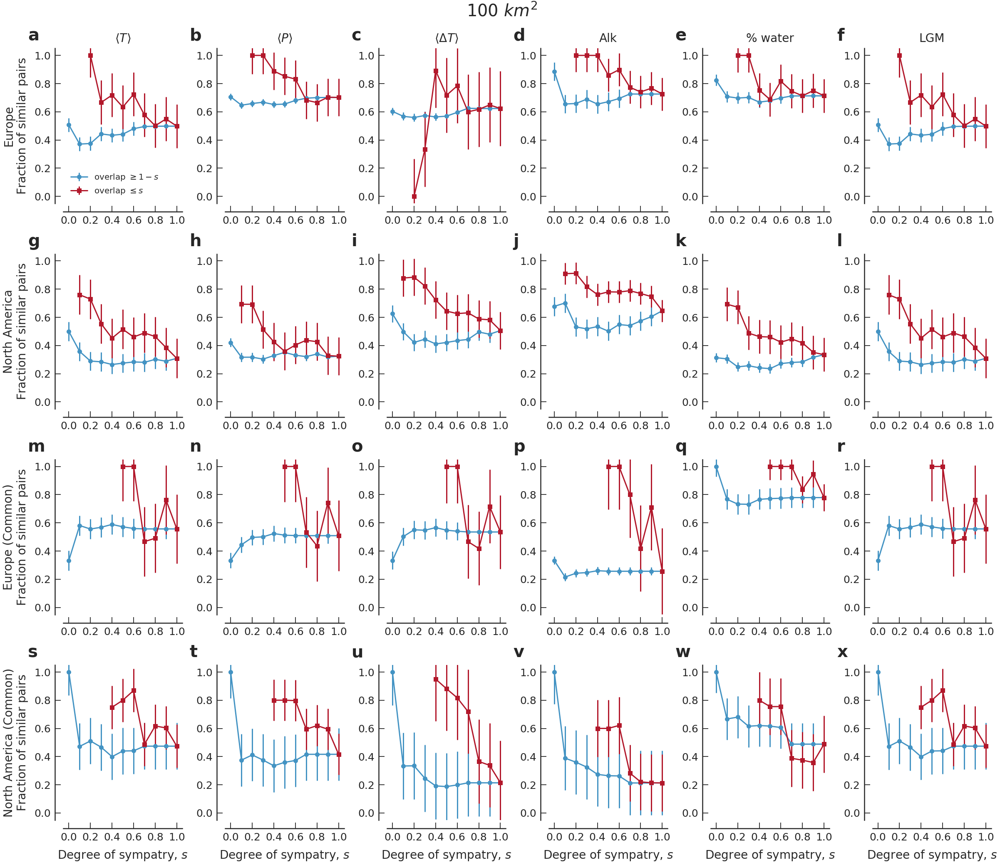

In [423]:
def df_werr(df, s):
    
    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_100100_europe_greater
df_less_1 = com_env_dist_sister_symp_100100_europe_less

df_greater_2 = com_env_dist_sister_symp_100100_europe_common_greater
df_less_2 = com_env_dist_sister_symp_100100_europe_common_less

df_greater_3 = com_env_dist_sister_symp_100100_north_america_greater
df_less_3 = com_env_dist_sister_symp_100100_north_america_less

df_greater_4 = com_env_dist_sister_symp_100100_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_100100_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.suptitle('100 $km^2$', y=1.03, fontsize=40)    
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp_100.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp_100.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


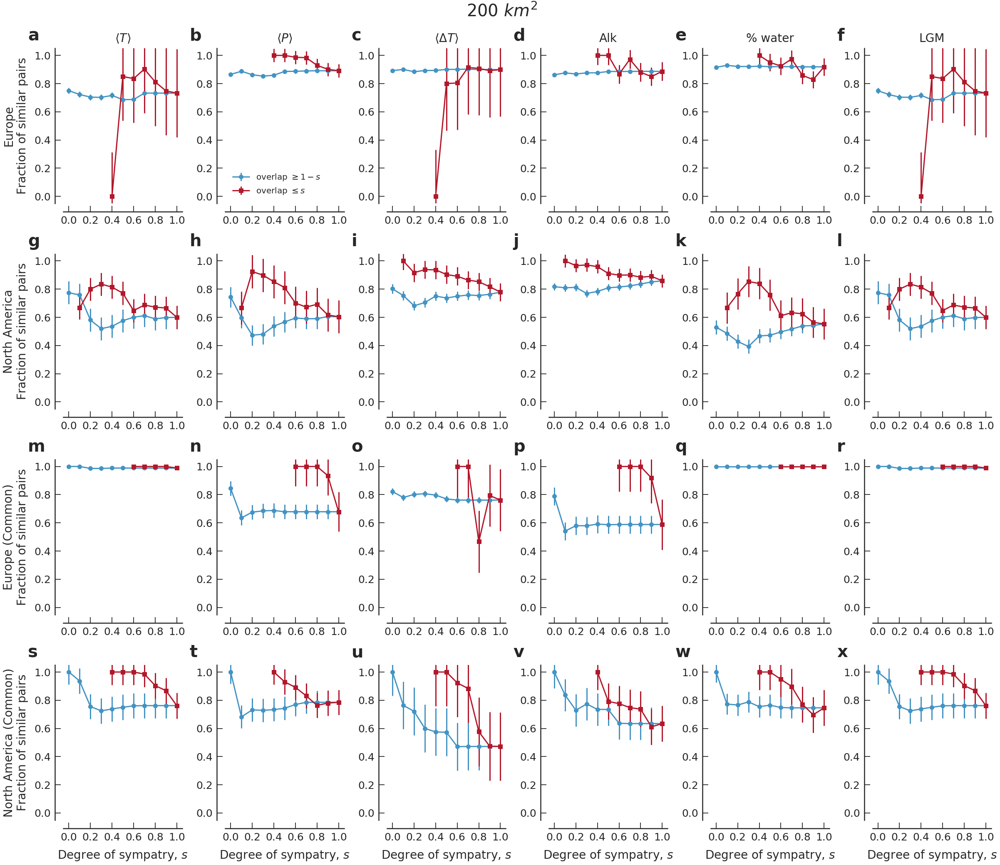

In [424]:
def df_werr(df, s):
    
    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_200200_europe_greater
df_less_1 = com_env_dist_sister_symp_200200_europe_less

df_greater_2 = com_env_dist_sister_symp_200200_europe_common_greater
df_less_2 = com_env_dist_sister_symp_200200_europe_common_less

df_greater_3 = com_env_dist_sister_symp_200200_north_america_greater
df_less_3 = com_env_dist_sister_symp_200200_north_america_less

df_greater_4 = com_env_dist_sister_symp_200200_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_200200_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 1:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.suptitle('200 $km^2$', y=1.03, fontsize=40)
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp_200.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp_200.png', bbox_inches='tight')

In [229]:
def df_werr(df, s):
    
    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001']
#     yerr = df_tmp['std_err']
#     yerr = df_tmp['perc_001'].std() 
    
    return x, y

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


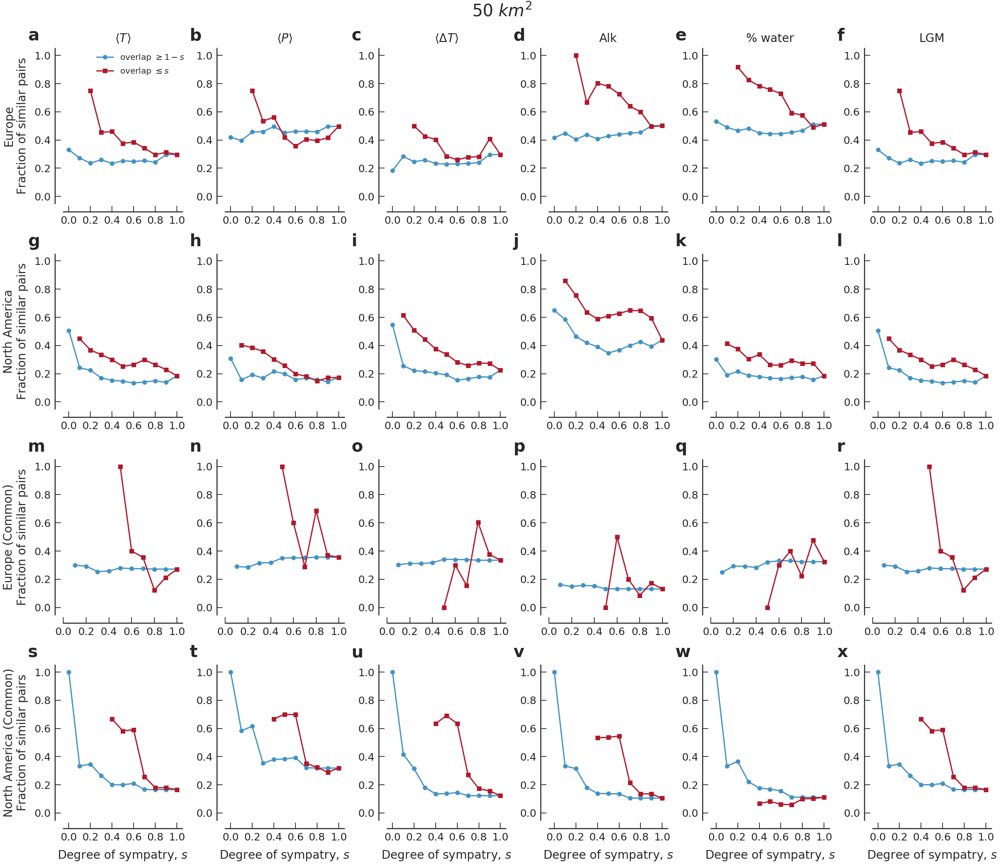

In [428]:
#, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_5050_europe_greater
df_less_1 = com_env_dist_sister_symp_5050_europe_less

df_greater_2 = com_env_dist_sister_symp_5050_europe_common_greater
df_less_2 = com_env_dist_sister_symp_5050_europe_common_less

df_greater_3 = com_env_dist_sister_symp_5050_north_america_greater
df_less_3 = com_env_dist_sister_symp_5050_north_america_less

df_greater_4 = com_env_dist_sister_symp_5050_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_5050_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.plot(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.8))
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('50 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp_noerr.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp_noerr.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


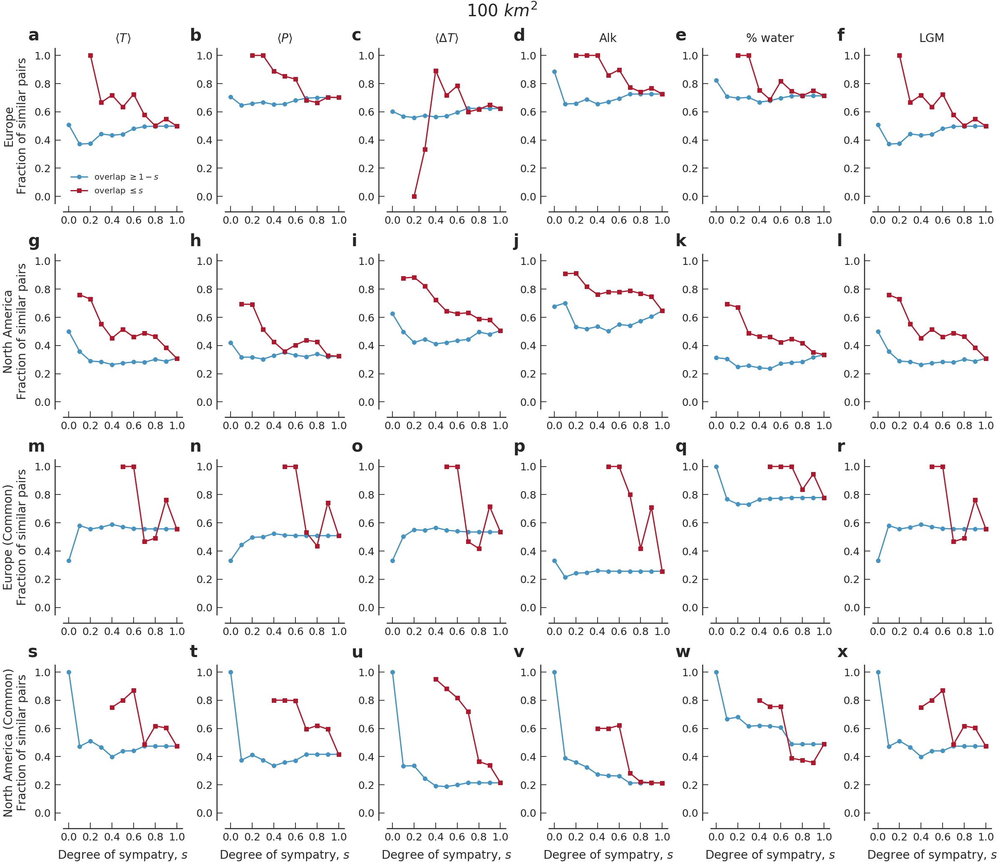

In [429]:
fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_100100_europe_greater
df_less_1 = com_env_dist_sister_symp_100100_europe_less

df_greater_2 = com_env_dist_sister_symp_100100_europe_common_greater
df_less_2 = com_env_dist_sister_symp_100100_europe_common_less

df_greater_3 = com_env_dist_sister_symp_100100_north_america_greater
df_less_3 = com_env_dist_sister_symp_100100_north_america_less

df_greater_4 = com_env_dist_sister_symp_100100_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_100100_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.plot(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.suptitle('100 $km^2$', y=1.03, fontsize=40)    
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp_100_noerr.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp_100_noerr.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


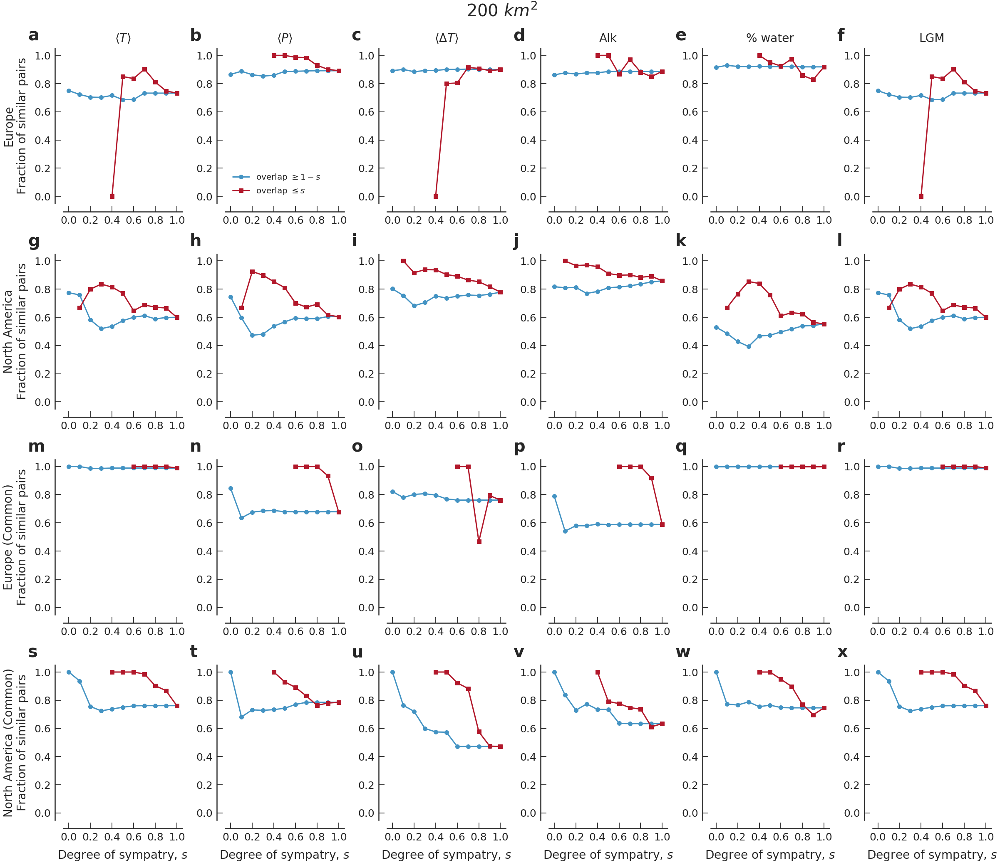

In [430]:
fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_200200_europe_greater
df_less_1 = com_env_dist_sister_symp_200200_europe_less

df_greater_2 = com_env_dist_sister_symp_200200_europe_common_greater
df_less_2 = com_env_dist_sister_symp_200200_europe_common_less

df_greater_3 = com_env_dist_sister_symp_200200_north_america_greater
df_less_3 = com_env_dist_sister_symp_200200_north_america_less

df_greater_4 = com_env_dist_sister_symp_200200_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_200200_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.plot(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 1:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.suptitle('200 $km^2$', y=1.03, fontsize=40)
fig.tight_layout()
fig.savefig('figures/frac_pvalue_symp_200_noerr.pdf', bbox_inches='tight')
fig.savefig('figures/frac_pvalue_symp_200_noerr.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


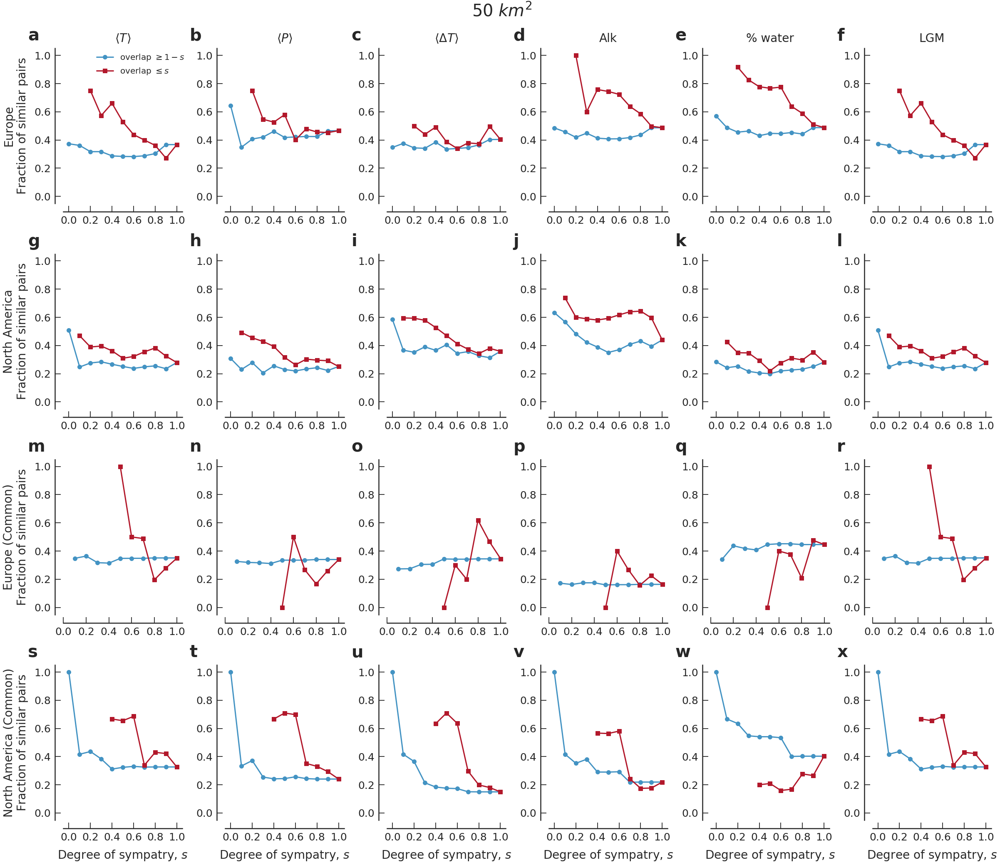

In [128]:
def df_werr(df, s):
    
    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001']
#     yerr = df_tmp['std_err']
#     yerr = df_tmp['perc_001'].std() 
    
    return x, y#, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_5050_europe_wcx_greater
df_less_1 = com_env_dist_sister_symp_5050_europe_wcx_less

df_greater_2 = com_env_dist_sister_symp_5050_europe_wcx_common_greater
df_less_2 = com_env_dist_sister_symp_5050_europe_wcx_common_less

df_greater_3 = com_env_dist_sister_symp_5050_north_america_wcx_greater
df_less_3 = com_env_dist_sister_symp_5050_north_america_wcx_less

df_greater_4 = com_env_dist_sister_symp_5050_north_america_wcx_common_greater
df_less_4 = com_env_dist_sister_symp_5050_north_america_wcx_common_less

df_greater_11 = com_env_dist_sister_symp_100100_europe_wcx_greater
df_less_11 = com_env_dist_sister_symp_100100_europe_wcx_less


df_greater_12 = com_env_dist_sister_symp_200200_europe_wcx_greater
df_less_12 = com_env_dist_sister_symp_200200_europe_wcx_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

# kwargs_sg_11 = dict(lw=3, marker='o', markersize=10, color=color_s[3])
# kwargs_sl_11 = dict(lw=3, marker='s', markersize=10, color=color_s[-3])

# kwargs_sg_12 = dict(lw=3, marker='o', markersize=10, color=color_s[4])
# kwargs_sl_12 = dict(lw=3, marker='s', markersize=10, color=color_s[-4])

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_1, s),    **kwargs_sl)
        
#         ax.plot(*df_werr(df_greater_11, s), **kwargs_sg_11)
#         ax.plot(*df_werr(df_less_11, s),    **kwargs_sl_11)
        
#         ax.plot(*df_werr(df_greater_12, s), **kwargs_sg_12)
#         ax.plot(*df_werr(df_less_12, s),    **kwargs_sl_12)
    
    elif c > 5 and c < 12:
        ax.plot(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.plot(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.8))
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('50 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
# fig.savefig('figures/frac_pvalue_symp_noerr.pdf', bbox_inches='tight')
# fig.savefig('figures/frac_pvalue_symp_noerr.png', bbox_inches='tight')

#### Fraction of pvalues within sympatry interval
<a id="fraction-of-pvalues-within"></a>
<a href="#summary">Summary</a>

In [377]:
symp_pairs_5050_europe_greater_pairs

,feature,frac,s
0,mean_temp,0.189320,0.0
1,mean_prec,0.242718,0.0
2,mean_vtemp,0.131068,0.0
3,alkalinity,0.699029,0.0
4,water,0.519417,0.0
...,...,...,...
61,mean_prec,0.251304,1.0
62,mean_vtemp,0.138362,1.0
63,alkalinity,0.463617,1.0
64,water,0.421723,1.0


In [90]:
df_greater_1[df_greater_1['feature'] == features[0]]

,feature,frac,s
0,mean_temp,0.189320,0.0
6,mean_temp,0.117776,0.1
12,mean_temp,0.112059,0.2
18,mean_temp,0.110653,0.3
24,mean_temp,0.107782,0.4
...,...,...,...
36,mean_temp,0.113703,0.6
42,mean_temp,0.117282,0.7
48,mean_temp,0.117903,0.8
54,mean_temp,0.122050,0.9


In [379]:
df_greater_1

,feature,frac,s
0,mean_temp,0.189320,0.0
1,mean_prec,0.242718,0.0
2,mean_vtemp,0.131068,0.0
3,alkalinity,0.699029,0.0
4,water,0.519417,0.0
...,...,...,...
61,mean_prec,0.251304,1.0
62,mean_vtemp,0.138362,1.0
63,alkalinity,0.463617,1.0
64,water,0.421723,1.0


/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


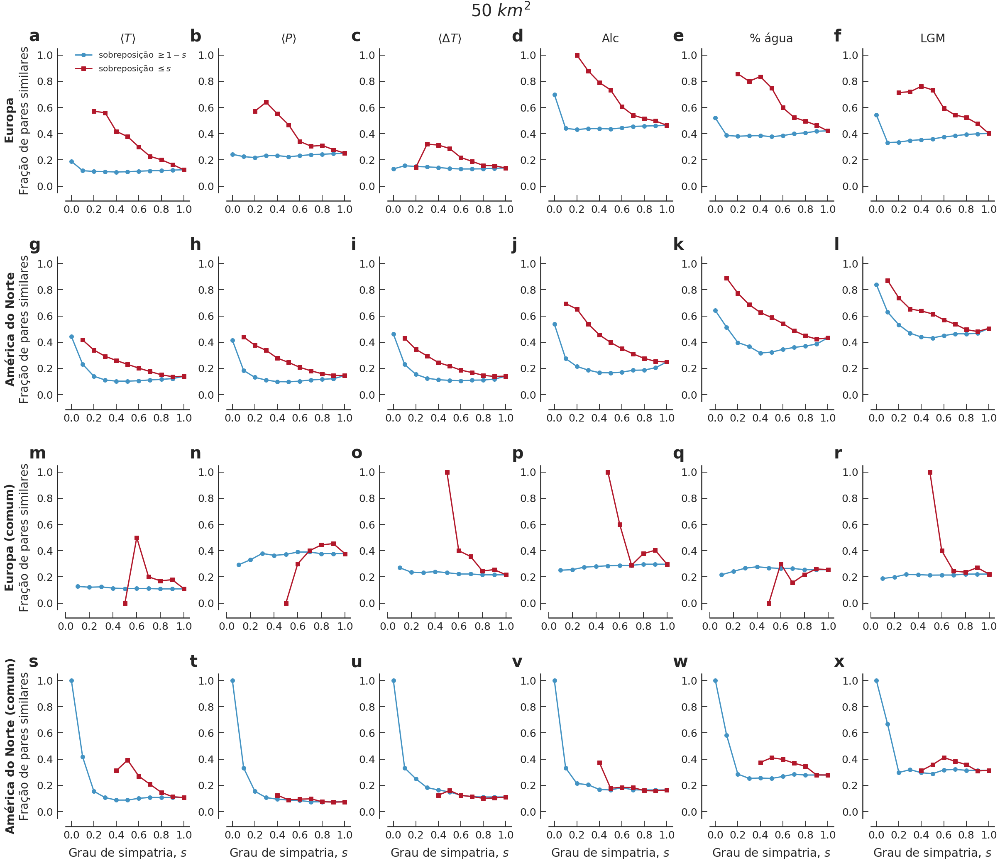

In [416]:
fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = symp_pairs_5050_europe_greater_pairs
df_less_1    = symp_pairs_5050_europe_less_pairs

df_greater_2 = symp_pairs_5050_europe_common_greater_pairs
df_less_2    = symp_pairs_5050_europe_common_less_pairs

df_greater_3 = symp_pairs_5050_north_america_greater_pairs
df_less_3    = symp_pairs_5050_north_america_less_pairs

df_greater_4 = symp_pairs_5050_north_america_common_greater_pairs
df_less_4    = symp_pairs_5050_north_america_common_less_pairs

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']


c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot('s', 'frac', data=df_greater_1[df_greater_1['feature'] == features[c]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_1[df_less_1['feature']       == features[c]], **kwargs_sl)
                    
    elif c > 5 and c < 12:
        ax.plot('s', 'frac', data=df_greater_3[df_greater_3['feature'] == features[c-6]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_3[df_less_3['feature']       == features[c-6]], **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot('s', 'frac', data=df_greater_2[df_greater_2['feature'] == features[c-12]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_2[df_less_2['feature']       == features[c-12]]   , **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot('s', 'frac', data=df_greater_4[df_greater_4['feature'] == features[c-18]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_4[df_less_4['feature']       == features[c-18]]   , **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.8))

    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
#         ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_xlabel('Grau de simpatria, $s$') #PT
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('50 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_pairs.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_pairs.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


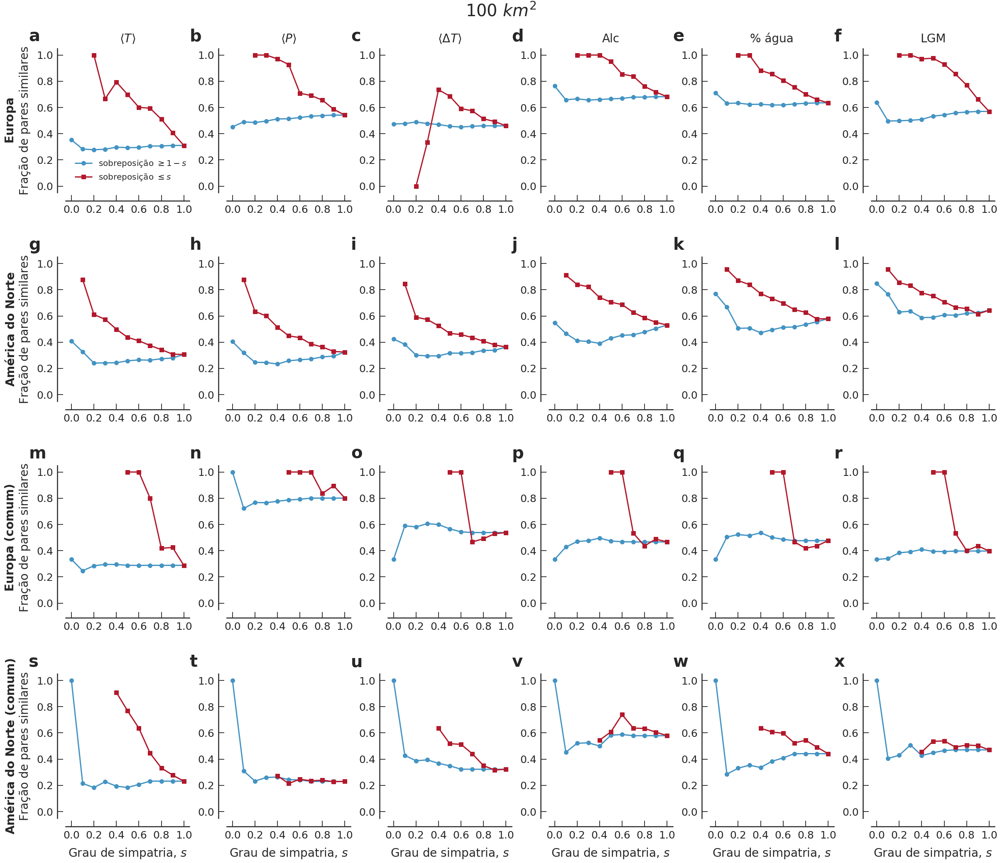

In [415]:
fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = symp_pairs_100100_europe_greater_pairs
df_less_1    = symp_pairs_100100_europe_less_pairs

df_greater_2 = symp_pairs_100100_europe_common_greater_pairs
df_less_2    = symp_pairs_100100_europe_common_less_pairs

df_greater_3 = symp_pairs_100100_north_america_greater_pairs
df_less_3    = symp_pairs_100100_north_america_less_pairs

df_greater_4 = symp_pairs_100100_north_america_common_greater_pairs
df_less_4    = symp_pairs_100100_north_america_common_less_pairs

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']


c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot('s', 'frac', data=df_greater_1[df_greater_1['feature'] == features[c]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_1[df_less_1['feature']       == features[c]], **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.plot('s', 'frac', data=df_greater_3[df_greater_3['feature'] == features[c-6]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_3[df_less_3['feature']       == features[c-6]], **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot('s', 'frac', data=df_greater_2[df_greater_2['feature'] == features[c-12]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_2[df_less_2['feature']       == features[c-12]]   , **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot('s', 'frac', data=df_greater_4[df_greater_4['feature'] == features[c-18]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_4[df_less_4['feature']       == features[c-18]]   , **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.8))

    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])

        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')

    
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('100 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_pairs_100100.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_pairs_100100.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


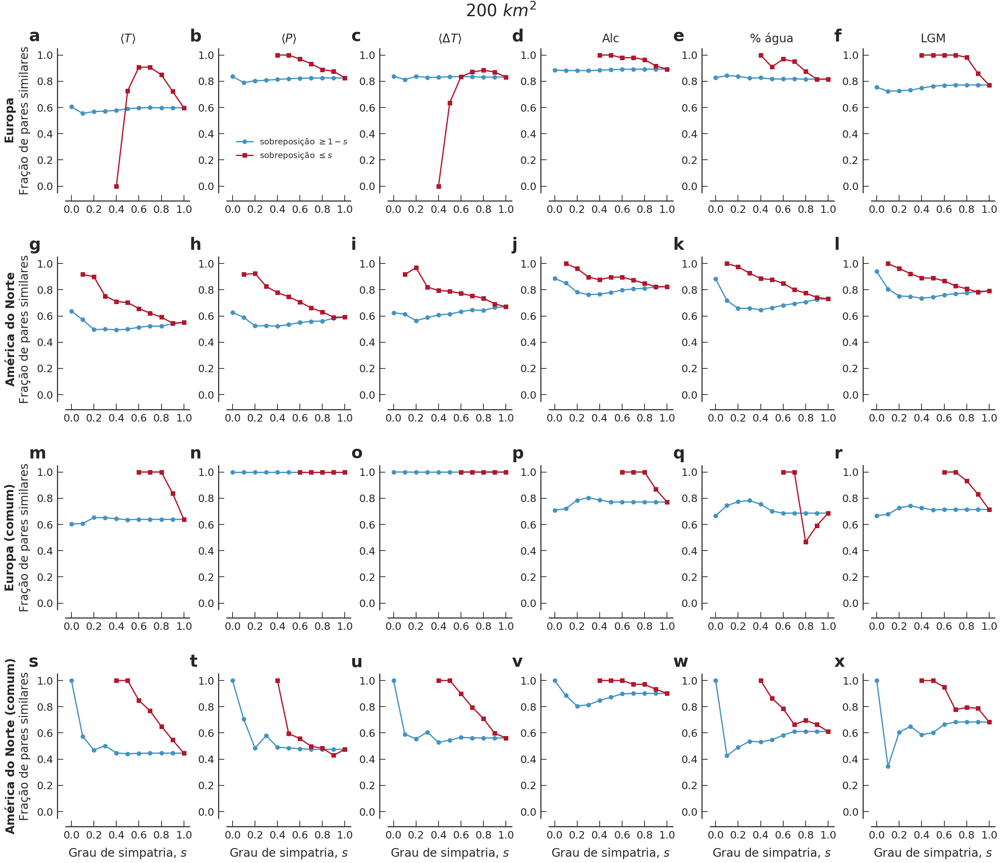

In [418]:
fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = symp_pairs_200200_europe_greater_pairs
df_less_1    = symp_pairs_200200_europe_less_pairs

df_greater_2 = symp_pairs_200200_europe_common_greater_pairs
df_less_2    = symp_pairs_200200_europe_common_less_pairs

df_greater_3 = symp_pairs_200200_north_america_greater_pairs
df_less_3    = symp_pairs_200200_north_america_less_pairs

df_greater_4 = symp_pairs_200200_north_america_common_greater_pairs
df_less_4    = symp_pairs_200200_north_america_common_less_pairs

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']


c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.plot('s', 'frac', data=df_greater_1[df_greater_1['feature'] == features[c]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_1[df_less_1['feature']       == features[c]], **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.plot('s', 'frac', data=df_greater_3[df_greater_3['feature'] == features[c-6]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_3[df_less_3['feature']       == features[c-6]], **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.plot('s', 'frac', data=df_greater_2[df_greater_2['feature'] == features[c-12]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_2[df_less_2['feature']       == features[c-12]]   , **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.plot('s', 'frac', data=df_greater_4[df_greater_4['feature'] == features[c-18]], **kwargs_sg)
        ax.plot('s', 'frac', data=df_less_4[df_less_4['feature']       == features[c-18]]   , **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 1:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False, loc=(0.25, 0.2))

    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of pairs with \n $p$-value $\geq 0.01$'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])

        n += 1
        
    
    if c > 17:
#         ax.set_xlabel('Degree of sympatry, $s$')
        ax.set_xlabel('Grau de simpatria, $s$') # PT
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

        
fig.suptitle('200 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_pairs_200200.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_pairs_200200.png', bbox_inches='tight')

Pairs that have a smaller sympatry value, when compared, are more likely to accept the null hypothesis from the 2 sample Kolmogorov-Smirnov test. This implies that is more likely that they come from the same distribution thesmaller the value of s for the compared pairs.

#### Mean fraction of similar distributions
<a id="mean-fraction-of-similar"></a>
<a href="#summary">Summary</a>

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


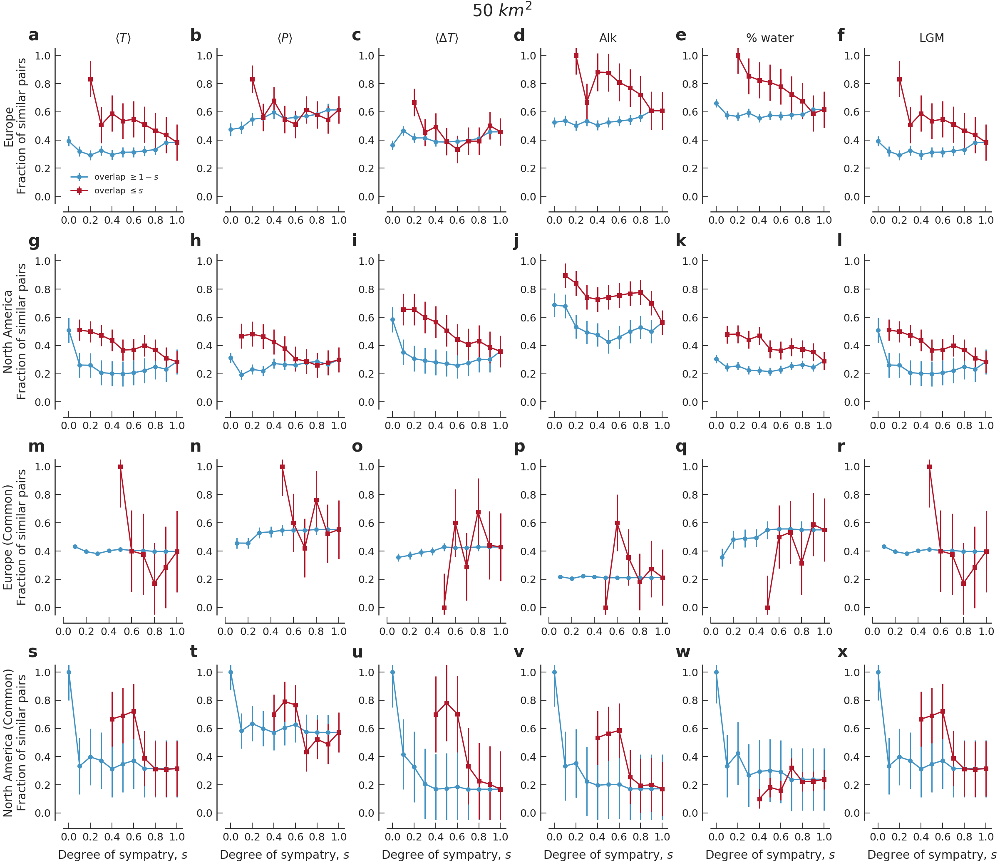

In [425]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/df[df['feature'] == features[s]].groupby('s').count()**(1/2))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_5050_europe_greater
df_less_1 = com_env_dist_sister_symp_5050_europe_less

df_greater_2 = com_env_dist_sister_symp_5050_europe_common_greater
df_less_2 = com_env_dist_sister_symp_5050_europe_common_less

df_greater_3 = com_env_dist_sister_symp_5050_north_america_greater
df_less_3 = com_env_dist_sister_symp_5050_north_america_less

df_greater_4 = com_env_dist_sister_symp_5050_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_5050_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of\n similar distributions'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

fig.suptitle('50 $km^2$', y=1.03, fontsize=40)
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


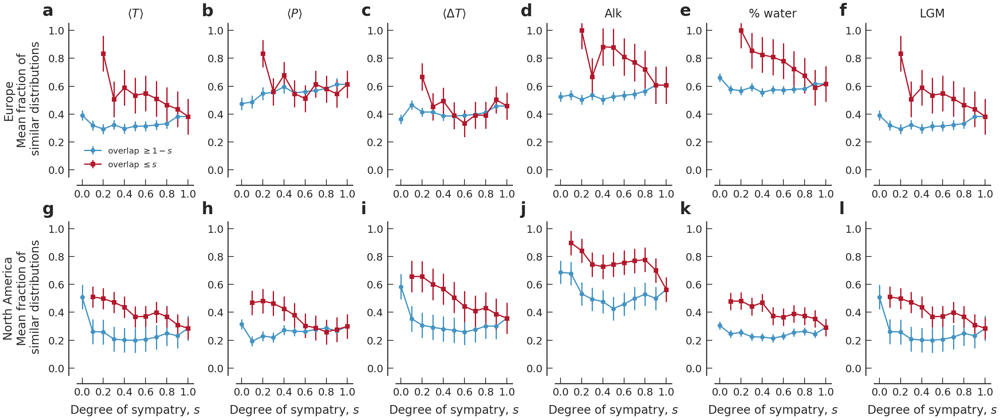

In [417]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/(df[df['feature'] == features[s]].groupby('s').count()**(1/2)))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(2, 6, figsize=stdfigsize(ny=2, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_5050_europe_greater
df_less_1 = com_env_dist_sister_symp_5050_europe_less

df_greater_2 = com_env_dist_sister_symp_5050_europe_common_greater
df_less_2 = com_env_dist_sister_symp_5050_europe_common_less

df_greater_3 = com_env_dist_sister_symp_5050_north_america_greater
df_less_3 = com_env_dist_sister_symp_5050_north_america_less

df_greater_4 = com_env_dist_sister_symp_5050_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_5050_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
#     elif c > 11 and c < 18:
#         ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
#     elif c > 17 and c < 24:
#         ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
        ylabel = 'Mean fraction of\n similar distributions'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 5:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

# fig.suptitle('100 $km^2$', y=1.03, fontsize=40)
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


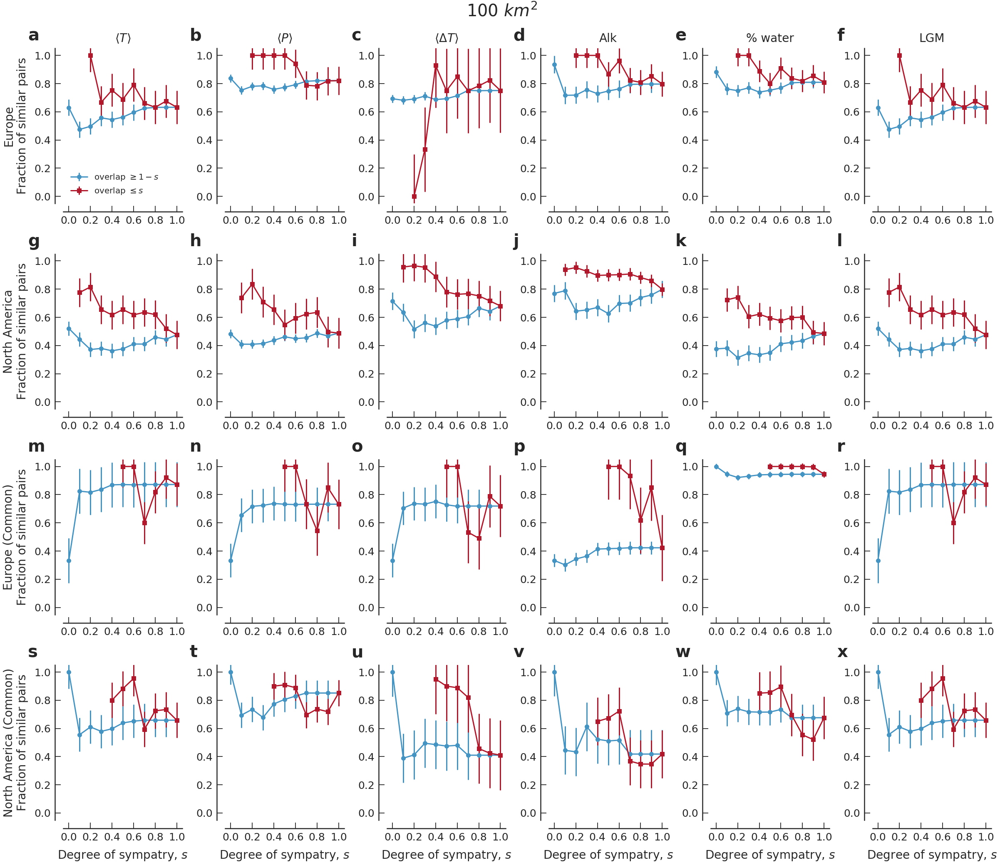

In [426]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/(df[df['feature'] == features[s]].groupby('s').count()**(1/2)))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_100100_europe_greater
df_less_1 = com_env_dist_sister_symp_100100_europe_less

df_greater_2 = com_env_dist_sister_symp_100100_europe_common_greater
df_less_2 = com_env_dist_sister_symp_100100_europe_common_less

df_greater_3 = com_env_dist_sister_symp_100100_north_america_greater
df_less_3 = com_env_dist_sister_symp_100100_north_america_less

df_greater_4 = com_env_dist_sister_symp_100100_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_100100_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of\n similar distributions'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

fig.suptitle('100 $km^2$', y=1.03, fontsize=40)
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf_100.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf_100.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


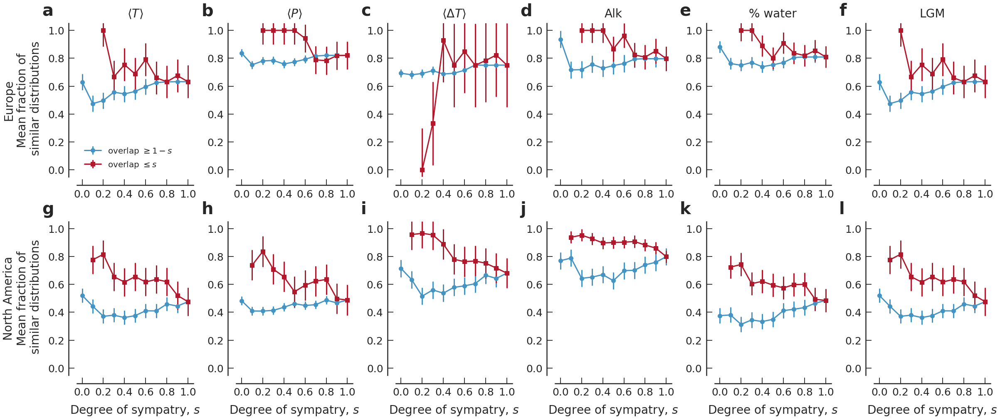

In [392]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/(df[df['feature'] == features[s]].groupby('s').count()**(1/2)))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(2, 6, figsize=stdfigsize(ny=2, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_100100_europe_greater
df_less_1 = com_env_dist_sister_symp_100100_europe_less

df_greater_2 = com_env_dist_sister_symp_100100_europe_common_greater
df_less_2 = com_env_dist_sister_symp_100100_europe_common_less

df_greater_3 = com_env_dist_sister_symp_100100_north_america_greater
df_less_3 = com_env_dist_sister_symp_100100_north_america_less

df_greater_4 = com_env_dist_sister_symp_100100_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_100100_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
#     elif c > 11 and c < 18:
#         ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
#     elif c > 17 and c < 24:
#         ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
        ylabel = 'Mean fraction of\n similar distributions'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 5:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common_100.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common_100.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


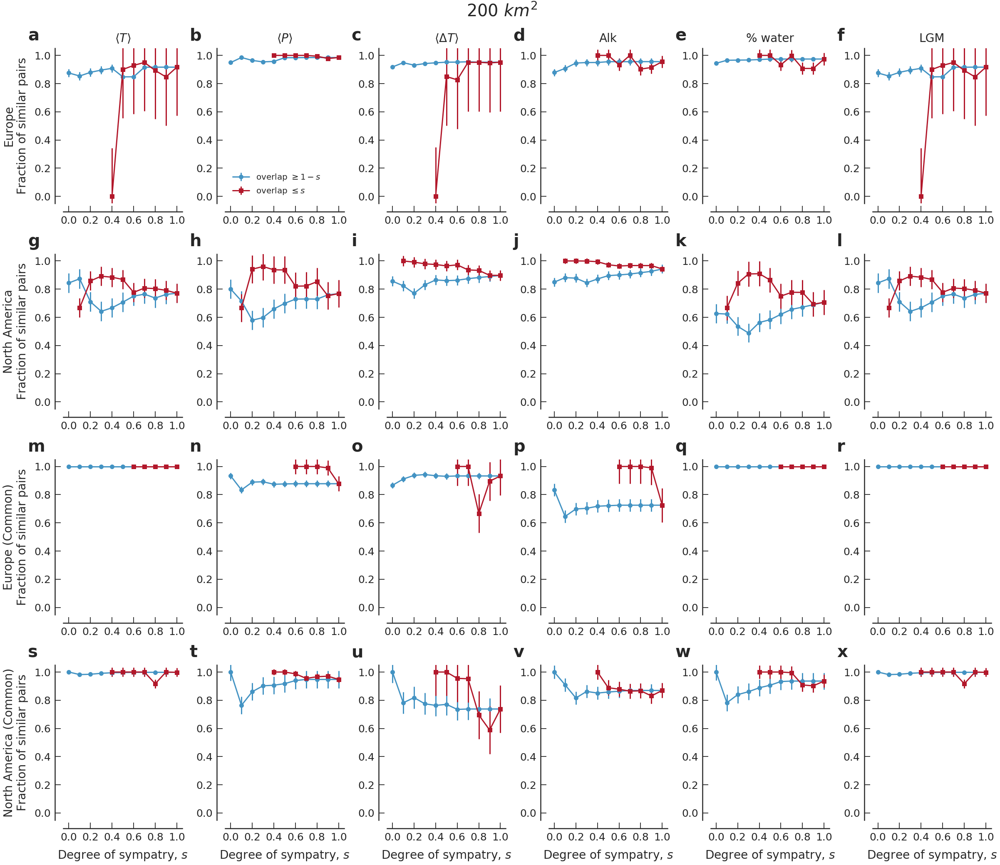

In [427]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/(df[df['feature'] == features[s]].groupby('s').count()**(1/2)))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(4, 6, figsize=stdfigsize(ny=4, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_200200_europe_greater
df_less_1 = com_env_dist_sister_symp_200200_europe_less

df_greater_2 = com_env_dist_sister_symp_200200_europe_common_greater
df_less_2 = com_env_dist_sister_symp_200200_europe_common_less

df_greater_3 = com_env_dist_sister_symp_200200_north_america_greater
df_less_3 = com_env_dist_sister_symp_200200_north_america_less

df_greater_4 = com_env_dist_sister_symp_200200_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_200200_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
    elif c > 11 and c < 18:
        ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
    elif c > 17 and c < 24:
        ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 1:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
#         ylabel = 'Mean fraction of\n similar distributions'
        ylabel = 'Fraction of similar pairs'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 17:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0

fig.suptitle('200 $km^2$', y=1.03, fontsize=40)        
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf_200.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf_200.png', bbox_inches='tight')

/home/dsvieira/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1320: UserWarning: findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


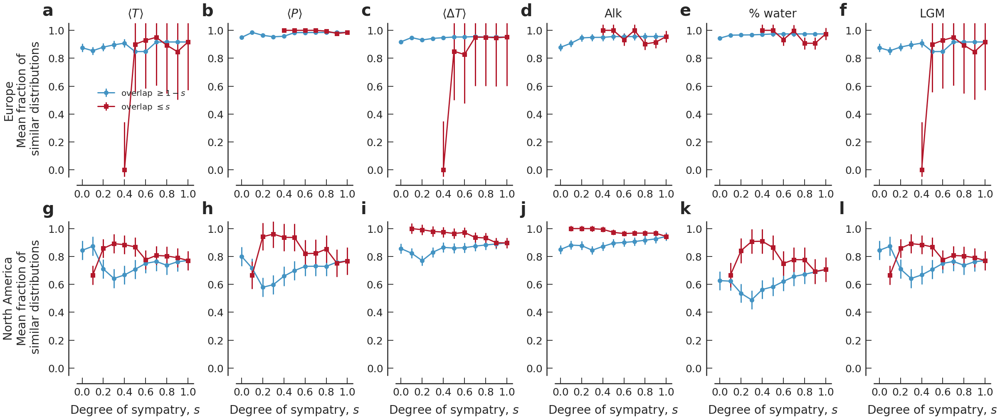

In [394]:
def df_werr(df, s):

    df_tmp = df[df['feature'] == features[s]].groupby('s').mean()
    df_tmp['std_err'] = (df[df['feature'] == features[s]].groupby('s').std()/(df[df['feature'] == features[s]].groupby('s').count()**(1/2)))['perc_001_bf']
    df_tmp = df_tmp.reset_index()
    x = df_tmp['s']
    y = df_tmp['perc_001_bf']
#     yerr = df_tmp['std_err']
    yerr = df_tmp['perc_001_bf'].std() 
    
    return x, y, yerr

fig, ax = plt.subplots(2, 6, figsize=stdfigsize(ny=2, nx=6, ratio=0.8))

df_greater_1 = com_env_dist_sister_symp_200200_europe_greater
df_less_1 = com_env_dist_sister_symp_200200_europe_less

df_greater_2 = com_env_dist_sister_symp_200200_europe_common_greater
df_less_2 = com_env_dist_sister_symp_200200_europe_common_less

df_greater_3 = com_env_dist_sister_symp_200200_north_america_greater
df_less_3 = com_env_dist_sister_symp_200200_north_america_less

df_greater_4 = com_env_dist_sister_symp_200200_north_america_common_greater
df_less_4 = com_env_dist_sister_symp_200200_north_america_common_less

color_s = palettable.colorbrewer.diverging.RdBu_11_r.mpl_colors
kwargs_sg = dict(lw=3, marker='o', markersize=10, color=color_s[2])#, legend=False)
kwargs_sl = dict(lw=3, marker='s', markersize=10, color=color_s[-2])#, legend=False)

titles = ['$\\langle T \\rangle$', '$\\langle P \\rangle$', '$\\langle \Delta T \\rangle$', 'Alk', '% water', 'LGM']

c, s, n = 0, 0, 0
for ax in ax.flat:
    
    if c < 6:
        ax.errorbar(*df_werr(df_greater_1, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_1, s),    **kwargs_sl)
    
    elif c > 5 and c < 12:
        ax.errorbar(*df_werr(df_greater_3, s), **kwargs_sg)
        ax.errorbar(*df_werr(df_less_3, s),    **kwargs_sl)
        
#     elif c > 11 and c < 18:
#         ax.errorbar(*df_werr(df_greater_2, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_2, s),    **kwargs_sl)
        
    
#     elif c > 17 and c < 24:
#         ax.errorbar(*df_werr(df_greater_4, s), **kwargs_sg)
#         ax.errorbar(*df_werr(df_less_4, s),    **kwargs_sl)
    
    ax.annotate(string.ascii_letters[c], xy=(-0.3, 1.05), xycoords='axes fraction', fontsize=40, weight='bold')
    
    if c < 6:
        ax.set_title(titles[c])
    
    ax.set_ylim([-0.05, 1.05])
    ax.set_xticks([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
    
    if c == 0:
        ax.legend(['overlap $\\geq 1-s$', 'overlap $\\leq s$'], fontsize=20, frameon=False)
    
    if c in [0,6,12,18]:
        ylabel = 'Mean fraction of\n similar distributions'
        ax.set_ylabel(['Europe\n' + ylabel, 'North America\n' + ylabel, 'Europe (Common)\n' + ylabel, 'North America (Common)\n' + ylabel][n])
        n += 1
        
    
    if c > 5:
        ax.set_xlabel('Degree of sympatry, $s$')
    else:
        ax.set_xlabel(' ')
    
    for loc, spine in ax.spines.items():
        if loc in ['left', 'bottom']:
            spine.set_position(('outward', 20)) # outward by 20 points
        elif loc in ['right','top']:
            spine.set_color('none') # don't draw spine
        else:
            raise ValueError('unknown spine location: %s'%loc)
    
    # Only show ticks on the left and bottom spines
    ax.yaxis.set_ticks_position('left')
    ax.xaxis.set_ticks_position('bottom')
    
    c += 1
    s += 1
    if c % 5 == 0:
        s = 0
    
fig.tight_layout()
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common_200.pdf', bbox_inches='tight')
# fig.savefig('../figures/frac_pvalue_symp_bf_no_common_200.png', bbox_inches='tight')